# TO DO

1. Explain in slides why we used a batch size of 1 (Small number of samples)

### Set Up

In [1]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# formating
plot_size = (25,10) #set plot size (entire plot)

C:\Users\C23Price.Johnson\AppData\Local\Temp\ipykernel_2996\1042045778.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


### Imports

In [3]:
import matplotlib
from datetime import datetime
from matplotlib import pyplot as plt
import numpy as np
import pandas
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import BatchNormalization
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import LeaveOneOut
from sklearn import linear_model, tree, ensemble

from numpy import mean
from matplotlib import pyplot
import statistics
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GroupShuffleSplit
from sklearn.metrics import plot_roc_curve
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.model_selection import RandomizedSearchCV
from keras.optimizers import RMSprop

### Get Indicies function

In [4]:
# get indicies for time data
def get_indices(time_data, start_time, end_time):
    """Return indecies of time_data that are >= start_time and < end_time
    
    time_data  - np array of type float, time_data indices will correlate to
    start_time - float, a timestamp for the start
    end_time   - float, a timestamp for the end
    
    return     - a tuple of indices
    """
    return tuple(np.where(
        np.logical_and(
            np.greater_equal(time_data, start_time), np.less(time_data, end_time)
        ))[0])

### Participant Class That Stores Data

In [5]:
# participant class that holds datasets for all participants
class Participant:

    def __init__(self, baseline_fileName, coldpressor_fileName,  participantNumber):

        self.cutoff = 99999999
        
        ########################################### Load Baseline Data ############################################
        
        baseline_input_data = pandas.read_csv(baseline_fileName)
        # print(baseline_input_data.head())
        self.unique_baseline_values = baseline_input_data["ibi"].unique()
        baseline_input_data.describe()
        baseline_data = baseline_input_data.values

        # store all values into Participant variables
        self.baseline_participantNumber = participantNumber
        self.baseline_id = baseline_data[:,[0]] # store all rows, id column
        self.baseline_user_id = baseline_data[:,[1]] # store all rows, user_id column
        self.baseline_unix_in_ms = baseline_data[baseline_data[:, 2].argsort()] # store all rows, unix_in_ms column sorted
        self.baseline_ibi = baseline_data[:,[3]] # store all rows, ibi column
        self.baseline_raw_data = baseline_data
        
        # get sorted unix time and ibi to store into plotting variable
        
        baseline_data = baseline_data[:,[2,3]] # Get all rows, time and ibi columns
        baseline_data = baseline_data[baseline_data[:, 0].argsort()]  # Sort by time to ensure time is chronological
        
        # print(baseline_data)
        
        self.baseline_unix_vs_ibi_for_plotting = baseline_data[:,[0,1]] #variable to be used for plotting
       # x axis timing
        baseline_plot_width_seconds = baseline_data[0,0] - baseline_data[0,1]
        baseline_min_time = baseline_data[1,0]
        baseline_max_time = baseline_min_time + baseline_plot_width_seconds

        # define indices and x values
        self.baseline_indices = get_indices(baseline_data[:,0], baseline_min_time, baseline_max_time)
        self.baseline_x_vals = [datetime.utcfromtimestamp(t/1000) for t in baseline_data[self.baseline_indices,0]] #convert to datetime objects

        ########################################### Load Cold Pressor Data ############################################
        
        coldpressor_input_data = pandas.read_csv(coldpressor_fileName)
        self.unique_coldpressor_values = coldpressor_input_data["ibi"].unique()
        coldpressor_input_data.describe()
        coldpressor_data = coldpressor_input_data.values
        # print(input_data)

        # store all values into Participant variables
        self.coldpressor_participantNumber = participantNumber
        self.coldpressor_id = coldpressor_data[:,[0]] # store all rows, id column
        self.coldpressor_user_id = coldpressor_data[:,[1]] # store all rows, user_id column
        self.coldpressor_unix_in_ms = coldpressor_data[coldpressor_data[:, 2].argsort()] # store all rows, unix_in_ms column sorted
        self.coldpressor_ibi = coldpressor_data[:,[3]] # store all rows, ibi column
        self.coldpressor_raw_data = coldpressor_data
        
        # get sorted unix time and ibi to store into plotting variable
        
        coldpressor_data = coldpressor_data[:,[2,3]] # Get all rows, time and ibi columns
        coldpressor_data = coldpressor_data[coldpressor_data[:, 0].argsort()]  # Sort by time to ensure time is chronological
        
        
        self.coldpressor_unix_vs_ibi_for_plotting = coldpressor_data[:,[0,1]] #variable to be used for plotting
        
       # x axis timing
        coldpressor_plot_width_seconds = coldpressor_data[0,0] - coldpressor_data[0,1]
        coldpressor_min_time = coldpressor_data[1,0]
        coldpressor_max_time = coldpressor_min_time + coldpressor_plot_width_seconds

        # define indices and x values
        self.coldpressor_indices = get_indices(coldpressor_data[:,0], coldpressor_min_time, coldpressor_max_time)
        self.coldpressor_x_vals = [datetime.utcfromtimestamp(t/1000) for t in coldpressor_data[self.coldpressor_indices,0]] #convert to datetime objects
        
        self.baseline_data_length = len(self.baseline_unix_vs_ibi_for_plotting[:,1])
        self.coldpressor_data_length = len(self.coldpressor_unix_vs_ibi_for_plotting[:,1])
        
    # getter and setter methods
    
    #plot participant baseline data
    def plot_baseline(self):
    
        # decorate
        fig = plt.figure(self.baseline_participantNumber)
        ax = plt.axes()
        plt.grid()
        plt.title("Participant " + str(self.baseline_participantNumber) + " Baseline Test")
        plt.xlabel('Time (Unix)', fontsize=15)
        plt.ylabel('IBI Measurement (ms)', fontsize=15)
        plt.rcParams['figure.figsize'] = plot_size

        indices = self.baseline_indices

        # plot
        plt.plot(self.baseline_x_vals,self.baseline_unix_vs_ibi_for_plotting[indices,1], 'o', linestyle = '--')
        plt.show()
        plt.close()
        
    #plot participant data
    def plot_coldpressor(self):
    
        # decorate
        fig = plt.figure(self.coldpressor_participantNumber)
        ax = plt.axes()
        plt.grid()
        plt.title("Participant " + str(self.coldpressor_participantNumber) + " Cold Pressor Test")
        plt.xlabel('Time (Unix)', fontsize=15)
        plt.ylabel('IBI Measurement (ms)', fontsize=15)
        plt.rcParams['figure.figsize'] = plot_size

        indices = self.coldpressor_indices

        # plot
        plt.plot(self.coldpressor_x_vals,self.coldpressor_unix_vs_ibi_for_plotting[indices,1], 'o', linestyle = '--', color = 'ORANGE')
        plt.show()
        plt.close()
        
    def plot_both(self):
        
        # decorate
        fig = plt.figure(self.coldpressor_participantNumber)
        ax = plt.axes()
        plt.grid()
        plt.title("Participant " + str(self.coldpressor_participantNumber) + " Baseline And Cold Pressor Test")
        plt.xlabel('Time (Unix)', fontsize=15)
        plt.ylabel('IBI Measurement (ms)', fontsize=15)
        plt.rcParams['figure.figsize'] = plot_size
        
        baseline_indices = self.baseline_indices
        coldpressor_indices = self.coldpressor_indices

        # plot
        line1, = plt.plot(self.baseline_x_vals,self.baseline_unix_vs_ibi_for_plotting[baseline_indices,1], 'o', linestyle = '--', label = 'Baseline Test')
        line2, = plt.plot(self.coldpressor_x_vals,self.coldpressor_unix_vs_ibi_for_plotting[coldpressor_indices,1], 'o', linestyle = '--', color = 'ORANGE', label = 'Cold Pressor Test')
        
        # legend
        plt.legend(handles=[line1, line2], loc='upper left', fontsize = 'x-large')
        
        plt.show()
        plt.close()
        
    def normalizeBaselineData(self):
        
        baseline_normalizedData = self.baseline_unix_vs_ibi_for_plotting #initialize baseline_normalizedData variable
        
        maxBaselineValue = max(self.baseline_unix_vs_ibi_for_plotting[:,1]) #set maxValue to highest value of ibi signals
        minBaselineValue = min(self.baseline_unix_vs_ibi_for_plotting[:,1]) #set minValue to lowest value of ibi signals
        maxColdPressorValue = max(self.coldpressor_unix_vs_ibi_for_plotting[:,1]) #set maxValue to highest value of ibi signals
        minColdPressorValue = min(self.coldpressor_unix_vs_ibi_for_plotting[:,1]) #set minValue to lowest value of ibi signals
        maxValue = max(maxBaselineValue, maxColdPressorValue)
        minValue = min(minBaselineValue, minColdPressorValue)
        
        
        numRows = len(self.baseline_unix_vs_ibi_for_plotting) #get number of rows
        
        for i in range(numRows):
            baseline_normalizedData[i,1] = (self.baseline_unix_vs_ibi_for_plotting[i,1] - minValue)/(maxValue-minValue)
        
        self.baseline_unix_vs_ibi_for_plotting = baseline_normalizedData
        return baseline_normalizedData
        
    def normalizeColdpressorData(self):
        
        coldpressor_normalizedData = self.coldpressor_unix_vs_ibi_for_plotting #initialize coldpressor_normalizedData variable
        
        maxBaselineValue = max(self.baseline_unix_vs_ibi_for_plotting[:,1]) #set maxValue to highest value of ibi signals
        minBaselineValue = min(self.baseline_unix_vs_ibi_for_plotting[:,1]) #set minValue to lowest value of ibi signals
        maxColdPressorValue = max(self.coldpressor_unix_vs_ibi_for_plotting[:,1]) #set maxValue to highest value of ibi signals
        minColdPressorValue = min(self.coldpressor_unix_vs_ibi_for_plotting[:,1]) #set minValue to lowest value of ibi signals
        maxValue = max(maxBaselineValue, maxColdPressorValue)
        minValue = min(minBaselineValue, minColdPressorValue)
        
        numRows = len(self.coldpressor_unix_vs_ibi_for_plotting) #get number of rows
        
        for i in range(numRows):
            coldpressor_normalizedData[i,1] = (self.coldpressor_unix_vs_ibi_for_plotting[i,1] - minValue)/(maxValue-minValue)
        
        self.coldpressor_unix_vs_ibi_for_plotting = coldpressor_normalizedData
        return coldpressor_normalizedData
        
    def splitDataKeepLeft(self, cutoff):
    
            self.baseline_unix_vs_ibi_for_plotting = np.delete(self.baseline_unix_vs_ibi_for_plotting, slice(cutoff,self.baseline_data_length), axis=0)
            self.coldpressor_unix_vs_ibi_for_plotting = np.delete(self.coldpressor_unix_vs_ibi_for_plotting, slice(cutoff,self.coldpressor_data_length), axis=0)

            self.baseline_data_length = len(self.baseline_unix_vs_ibi_for_plotting[:,1])
            self.coldpressor_data_length = len(self.coldpressor_unix_vs_ibi_for_plotting[:,1])
            
        
    def splitDataKeepRight(self, cutoff):
    
            self.baseline_unix_vs_ibi_for_plotting = np.delete(self.baseline_unix_vs_ibi_for_plotting, slice(0,self.baseline_data_length-cutoff), axis=0)
            self.coldpressor_unix_vs_ibi_for_plotting = np.delete(self.coldpressor_unix_vs_ibi_for_plotting, slice(0,self.coldpressor_data_length-cutoff), axis=0)

            self.baseline_data_length = len(self.baseline_unix_vs_ibi_for_plotting[:,1])
            self.coldpressor_data_length = len(self.coldpressor_unix_vs_ibi_for_plotting[:,1])

        
    def getfeatures(self):            
        
        # Using Skicit-learn to split data into training and testing sets
        # Split the data into training and testing sets
        train_features, test_features, train_labels, test_labels = train_test_split(self.features, self.labels, test_size = 0.25, random_state = 42)
        
        # Instantiate model with 1000 decision trees
        rf = RandomForestRegressor(n_estimators = 1000, random_state = 42)
        
        # Train the model on training data
        rf.fit(train_features, train_labels);
        
    # id getter method
    def get_baseline_unix_vs_ibi_for_plotting(self):
        return self.baseline_unix_vs_ibi_for_plotting

    # user_id getter method
    def getUser_ID(self):
        return self.user_id

    # unix_in_ms getter method
    def getUnix_in_ms(self):
        return self.unix_in_ms

    # ibi getter method
    def getIbi(self):
        return self.ibi
    
    # ibi getter method
    def getData(self):
        return self.data

    # id setter method
    def setID(self, id):
        self.id = id

    # user_id setter method
    def setUser_ID(self, user_id):
        self.user_id = user_id

    # unix_in_ms setter method
    def setUnix_in_ms(self, unix_in_ms):
        self.unix_in_ms = unix_in_ms

    # ibi setter method
    def setIbi(self, ibi):
        self.ibi = ibi
        
    def getBaselineSize(self):
        return self.baseline_data_length
    
    def getColdpressorSize(self):
        return self.coldpressor_data_length
        

### Get and Normalize Data

In [8]:
#main

#init participants
participants = [Participant for i in range(61)]

#store all participant data
n = 1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n] = Participant("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin_unique_values\\participant_" + str(n) + "_BL.csv",
                                      "C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin_unique_values\\participant_" + str(n) + "_CPT.csv",n)
    n = n + 1
    
tempData = participants[1].baseline_unix_vs_ibi_for_plotting[:,1]
        
# Normalize Data
n = 1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n].normalizeBaselineData()
        participants[n].normalizeColdpressorData()
    n = n + 1

### Data statistics

In [9]:
#initiate variables
baselineTotal = 0
coldPressorTotal = 0
numParticipants = 0
smallestBaselineSize = 99999999
smallestColdpressorSize = 99999999
cutoff = 200
numberOfUsableParticipants = 0
    
#get average number of baseline and coldpressor datapoints
n = 1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        baselineTotal = baselineTotal + participants[n].getBaselineSize()
        coldPressorTotal = coldPressorTotal + participants[n].getColdpressorSize()
        numParticipants = numParticipants + 1
        
        #print(participants[n].baseline_unix_vs_ibi_for_plotting)
        
        
        smallestBaselineSize = min(smallestBaselineSize, participants[n].baseline_data_length)
        smallestColdpressorSize = min(smallestColdpressorSize, participants[n].coldpressor_data_length)
    n = n + 1

averageNumberOfBaselineDatapoints = round((baselineTotal / numParticipants), 0)
averageNumberOfColdpressorDatapoints = round((coldPressorTotal / numParticipants), 0)

print("Cutoff: " + str(cutoff))
print("Average Number of Baseline datapoints per Sample: " + str(averageNumberOfBaselineDatapoints))
print("Average Number of Coldpressor datapoints per Sample: " + str(averageNumberOfColdpressorDatapoints))
print("Smallest Baseline Sample Size: " + str(smallestBaselineSize))
print("Smallest Coldpressor Sample Size: " + str(smallestColdpressorSize))

Cutoff: 200
Average Number of Baseline datapoints per Sample: 437.0
Average Number of Coldpressor datapoints per Sample: 237.0
Smallest Baseline Sample Size: 274
Smallest Coldpressor Sample Size: 49


### Plot Number of Data Points Per Participant

Range: 507


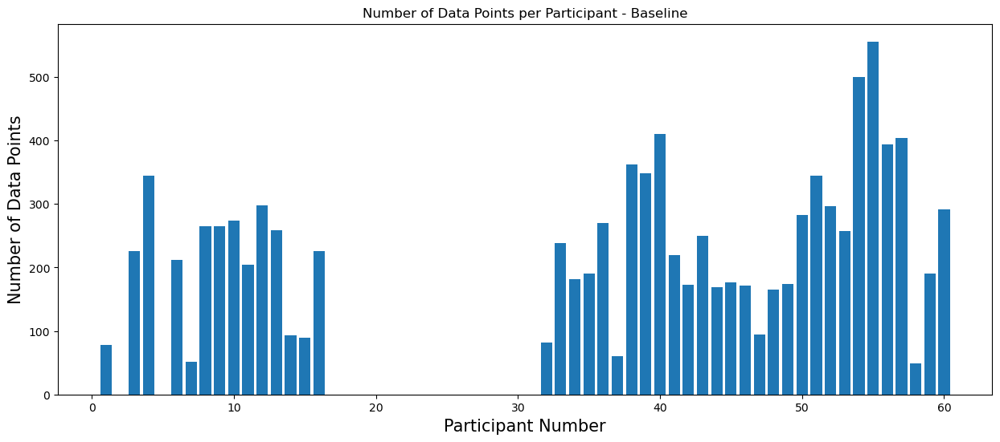

In [10]:
IDs = []
lengths = []
n=1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        IDs.append(n)
        lengths.append(participants[n].coldpressor_data_length)
    n = n + 1

from matplotlib.pyplot import figure

figure(figsize=(15, 6), dpi=100)

plt.title("Number of Data Points per Participant - Baseline")
plt.xlabel('Participant Number', fontsize=15)
plt.ylabel('Number of Data Points', fontsize=15)
plt.bar(IDs, lengths, width=.8)

print("Range: " + str(max(lengths) - min(lengths)))

### Cut Participant Data Based on Cutoff

In [11]:
# Get all usable participant data that where usable participant's dataset size if greater than the cutoff
usableParticipants = [Participant for i in range(1)]
n = 1
while (n<61 and participants[n] != None):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        if(((participants[n].getBaselineSize() >= cutoff) and (participants[n].getColdpressorSize() >= cutoff)) or (not participants[n])):
            usableParticipants.append(participants[n])
            numberOfUsableParticipants = numberOfUsableParticipants + 1
    n = n + 1

print("Cutoff: " + str(cutoff))
print("Number of Usable Participants: " + str(numberOfUsableParticipants))

#split data into same size
n = 1
while (n<=numberOfUsableParticipants):
    usableParticipants[n].splitDataKeepLeft(cutoff)
    n = n + 1

Cutoff: 200
Number of Usable Participants: 26


### Get an Array of Usable Participants

In [12]:
# create samples and labels array based on usable participants
samples = [usableParticipants[1].baseline_unix_vs_ibi_for_plotting for i in range(1)]
samples[0] = usableParticipants[1].baseline_unix_vs_ibi_for_plotting[:,1]
labels = [0 for x in range(0, numberOfUsableParticipants)]
ID = []
ID.append(1)
n = 2
while (n<=numberOfUsableParticipants):
    samples.append(usableParticipants[n].baseline_unix_vs_ibi_for_plotting[:,1])
    ID.append(n)
    n = n + 1 
n = 1
while (n<=numberOfUsableParticipants):
    samples.append(usableParticipants[n].coldpressor_unix_vs_ibi_for_plotting[:,1])
    labels.append(1)
    ID.append(n)
    n = n + 1
    
# Saving feature names for later use
feature_names = ["IBI", "Pain"]

### Slice

In [13]:
def get_user_slice(target, subjects):
    '''return slice for user - the indicies
       Target - array you are slicing 
       Slices are done on target dataset, user must ensure data.shape matches
    '''
    subjects_slice = np.array([target == i for i in subjects]).any(axis=0) #or the list of lists

    return subjects_slice

### Split into Train, Test, and Validate Sets

In [14]:
#parallel arrays, same indicies
samples = np.array(samples).astype(np.float32)
labels = np.array(labels)
ID = np.array(ID)

subjects = ID[0:numberOfUsableParticipants] # subjects to shuffle on

cut = .2

np.random.shuffle(subjects)
split_count = int(cut * numberOfUsableParticipants) #porportion of train and test splits

#indicies from 0 to split_count
validation_indicies = get_user_slice(target=ID, subjects=subjects[0:split_count]) 

#indicies from split_count to 2xsplit_count
test_indicies = get_user_slice(target=ID, subjects=subjects[split_count:2 * split_count]) 
train_indicies = np.invert(np.array([test_indicies,validation_indicies]).any(axis=0))

train_x = samples[train_indicies]
train_y = labels[train_indicies]
val_x   = samples[validation_indicies]
val_y   = labels[validation_indicies]
test_x  = samples[test_indicies]
test_y  = labels[test_indicies]

kfold_subjects = subjects
k_fold_IDs_indicies = np.invert(np.array(test_indicies))
k_fold_IDs = ID[k_fold_IDs_indicies]
temp_array = subjects[split_count:2 * split_count]

i = 0
j = 0
while i < (kfold_subjects.size):
    j = 0
    while j < (temp_array.size):
        if(kfold_subjects[i] == temp_array[j]):
            kfold_subjects = np.delete(kfold_subjects,i)
        j = j + 1
    i = i + 1

print("Cutoff: " + str(cutoff))
print((1-(2*cut)) * 100, "% Training shape:", train_x.shape)
print(cut * 100, "% Testing shape:", test_x.shape)
print(cut * 100, "% Validation shape:", val_x.shape)
print((1-(2*cut)) * 100, "% Training labels shape:", train_y.shape)
print(cut * 100, "% Testing labels shape:", test_y.shape)
print(cut * 100, "% Validation labels shape:", val_y.shape)

Cutoff: 200
60.0 % Training shape: (32, 200)
20.0 % Testing shape: (10, 200)
20.0 % Validation shape: (10, 200)
60.0 % Training labels shape: (32,)
20.0 % Testing labels shape: (10,)
20.0 % Validation labels shape: (10,)


### K Fold Validation Function

In [15]:
def kFold(model, train_x, train_y, subjects, IDs):
    k = 5
    num_val_samples = len(subjects) // k
    num_epochs = 500 
    all_scores = [] 
    for i in range(k):
           
        print(f"Processing fold #{i}")
        
        if( i == (k-1)):
            validation_indicies = get_user_slice(target=IDs, subjects=subjects[i * num_val_samples:len(subjects)])
            print("Validation Set: Subjects " + str(i * num_val_samples) + ":" +  str(len(subjects)))

        else:
            validation_indicies = get_user_slice(target=IDs, subjects=subjects[i * num_val_samples: (i + 1) * num_val_samples])
            print("Validation Set: Subjects " + str(i * num_val_samples) + ":" +  str((i + 1) * num_val_samples))
            
        train_indicies = np.invert(validation_indicies)
                                   
        val_data = train_x[validation_indicies]
        val_targets = train_y[validation_indicies]
        
        partial_train_data = train_x[train_indicies]
        partial_train_targets = train_y[train_indicies]
                
        model.fit(partial_train_data, partial_train_targets,                    
                  epochs=num_epochs, batch_size=1, verbose=0)
        loss, val_acc = model.evaluate(val_data, val_targets, verbose=0)     
        all_scores.append(val_acc)
    print("Fold Accuracies: ", all_scores)
    print("Average Accuracy: ", np.mean(all_scores))

### Random Forests

In [16]:
# Instantiate model with 1000 decision trees, use classifier for binary classification 
rf = RandomForestClassifier(n_estimators = 1000, random_state = 42)
        
# Train the model on training data
rf.fit(train_x, train_y);

# Use the forest's predict method on the test data
predictions = rf.predict(test_x)

# Print labels and predictions
print("Cutoff: " + str(cutoff))
print("Number of Usable Participants: " + str(numberOfUsableParticipants))

print("\nRandom Forests Results:")
print("Test Labels: " + str(test_y))
print("Predictions: " + str(predictions))

# Find which values were correctly predicted
correctPredictions =  [0 for x in range(0, len(test_y))]
n = 0
numCorrect = 0
while (n<len(test_y)):
    correctPredictions[n] = int (not (test_y[n] ^ predictions[n]))
    if(correctPredictions[n] == 1):
        numCorrect = numCorrect + 1
    n = n + 1
    
# Print results
print("Correct Predictions: " + str(correctPredictions))
print("Accuracy: " + str( round( ((numCorrect/len(test_y)) * 100), 2)) + "%")

#K fold
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
score = cross_val_score(ensemble.RandomForestClassifier(random_state= 42), train_x, train_y, cv= kf, scoring="accuracy")
print("\nK Fold Validation Results:")
print(f'Scores for each fold are: {score}')
print(f'Average score: {"{:.2f}".format(score.mean()*100)}' + '%')

newModel = RandomForestRegressor(n_estimators=500, random_state=42, min_samples_split=2, min_samples_leaf=1, max_depth=10, bootstrap=True)
newModel.fit(train_x, train_y)
predict = newModel.predict(test_x)

print("\nRandom Forest Model Using Randomized Grid Search :")

grid_rf = {
    'n_estimators': [20, 50, 100],  
    'max_depth': np.arange(1, 15, 1),  
    'min_samples_split': [2, 10, 9], 
    'min_samples_leaf': np.arange(1, 15, 2, dtype=int),  
    'bootstrap': [True, False], 
    'random_state': [1, 2, 30, 42]
}

rscv = RandomizedSearchCV(estimator=newModel, param_distributions=grid_rf, cv=3, n_jobs=-1, verbose=2, n_iter=200)
rscv_fit = rscv.fit(train_x, train_y)
best_parameters = rscv_fit.best_params_
print("Best Parameters: " + str(best_parameters))

grid_predict = rscv_fit.predict(test_x)

i = 0
while (i < grid_predict.size):
    if(grid_predict[i] < .5):
        grid_predict[i] = int(0)
    else:
        grid_predict[i] = int(1)  
    i = i + 1

print("Test Labels: " + str(test_y))
print("Predictions: " + str(grid_predict))

# Find which values were correctly predicted
correctPredictions =  [0 for x in range(0, len(test_y))]
n = 0
numCorrect = 0
while (n<len(test_y)):
    correctPredictions[n] = int (not (test_y[n] ^ int(grid_predict[n])))
    if(correctPredictions[n] == 1):
        numCorrect = numCorrect + 1
    n = n + 1
    
print("Correct Predictions: " + str(correctPredictions))
print("Accuracy: " + str( round( ((numCorrect/len(test_y)) * 100), 2)) + "%")

Cutoff: 200
Number of Usable Participants: 26

Random Forests Results:
Test Labels: [0 0 0 0 0 1 1 1 1 1]
Predictions: [0 0 0 0 0 1 1 1 1 1]
Correct Predictions: [1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Accuracy: 100.0%

K Fold Validation Results:
Scores for each fold are: [1.   0.75 1.   1.   1.   1.   1.   1.   1.   1.  ]
Average score: 97.50%

Random Forest Model Using Randomized Grid Search :
Fitting 3 folds for each of 200 candidates, totalling 600 fits
Best Parameters: {'random_state': 1, 'n_estimators': 20, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 7, 'bootstrap': True}
Test Labels: [0 0 0 0 0 1 1 1 1 1]
Predictions: [0. 0. 0. 0. 0. 1. 1. 1. 1. 1.]
Correct Predictions: [1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Accuracy: 100.0%


### Dense NN

In [17]:
# Practice with Keras Model
# Activation and Loss Function
model = Sequential()
#model.add(Dense(1, input_shape=(cutoff,), activation='relu', kernel_initializer = 'he_normal', kernel_regularizer = 'l1'))
#model.add(Dense(128, activation='relu', kernel_initializer = 'he_normal', kernel_regularizer = 'l2'))
# model.add(Dense(64, activation='relu', kernel_initializer = 'he_normal', kernel_regularizer = 'l2'))
# model.add(Dense(32, activation='relu', kernel_initializer = 'he_normal', kernel_regularizer = 'l2'))
#model.add(Dense(16, activation='relu', kernel_initializer = 'he_normal', kernel_regularizer = 'l2'))
model.add(Dropout(rate=0.2))
model.add(Dense(8, activation='relu', kernel_initializer = 'he_normal', kernel_regularizer = 'l1'))
model.add(Dense(4, activation='relu', kernel_initializer = 'he_normal', kernel_regularizer = 'l1'))
model.add(Dropout(rate=0.4))
#model.add(Dense(2, activation='relu', kernel_initializer = 'he_normal', kernel_regularizer = 'l2'))
model.add(Dense(1, activation='sigmoid', kernel_initializer = 'he_normal'))
model.compile(loss='binary_crossentropy', optimizer=RMSprop(learning_rate = .001), metrics=['acc'])
#model.summary()

# fit the keras model on the dataset
history = model.fit(train_x, train_y, validation_data=(val_x, val_y), epochs=800, batch_size=1, verbose=1)

# Print accuracy of the model, anything greater than 50% would be great
_, accuracy = model.evaluate(test_x, test_y)
print('Accuracy: %.2f' % (accuracy*100))

#K fold

k_train_x = np.vstack((train_x, val_x))
k_train_y = np.hstack((train_y, val_y))

kFold(model, k_train_x, k_train_y, kfold_subjects, k_fold_IDs)

Epoch 1/800
32/32 [==============================] - 3s 28ms/step - loss: 1.9219 - acc: 0.4375 - val_loss: 1.8139 - val_acc: 0.5000
Epoch 2/800
32/32 [==============================] - 0s 6ms/step - loss: 1.7505 - acc: 0.4688 - val_loss: 1.6170 - val_acc: 0.6000
Epoch 3/800
32/32 [==============================] - 0s 6ms/step - loss: 1.5750 - acc: 0.4375 - val_loss: 1.5063 - val_acc: 0.5000
Epoch 4/800
32/32 [==============================] - 0s 5ms/step - loss: 1.4508 - acc: 0.5312 - val_loss: 1.4293 - val_acc: 0.5000
Epoch 5/800
32/32 [==============================] - 0s 8ms/step - loss: 1.3517 - acc: 0.5000 - val_loss: 1.3419 - val_acc: 0.5000
Epoch 6/800
32/32 [==============================] - 0s 9ms/step - loss: 1.3456 - acc: 0.5625 - val_loss: 1.2009 - val_acc: 0.5000
Epoch 7/800
32/32 [==============================] - 0s 7ms/step - loss: 1.1828 - acc: 0.5625 - val_loss: 1.1260 - val_acc: 0.5000
Epoch 8/800
32/32 [==============================] - 0s 9ms/step - loss: 1.1004 - 

Epoch 63/800
32/32 [==============================] - 0s 10ms/step - loss: 0.7126 - acc: 0.4688 - val_loss: 0.7116 - val_acc: 0.5000
Epoch 64/800
32/32 [==============================] - 0s 10ms/step - loss: 0.7127 - acc: 0.5312 - val_loss: 0.7167 - val_acc: 0.5000
Epoch 65/800
32/32 [==============================] - 0s 9ms/step - loss: 0.7147 - acc: 0.5000 - val_loss: 0.7078 - val_acc: 0.5000
Epoch 66/800
32/32 [==============================] - 0s 9ms/step - loss: 0.7132 - acc: 0.5000 - val_loss: 0.7098 - val_acc: 0.5000
Epoch 67/800
32/32 [==============================] - 0s 10ms/step - loss: 0.7134 - acc: 0.5312 - val_loss: 0.7101 - val_acc: 0.5000
Epoch 68/800
32/32 [==============================] - 0s 10ms/step - loss: 0.7122 - acc: 0.5000 - val_loss: 0.7070 - val_acc: 0.6000
Epoch 69/800
32/32 [==============================] - 0s 10ms/step - loss: 0.7137 - acc: 0.6250 - val_loss: 0.7062 - val_acc: 0.5000
Epoch 70/800
32/32 [==============================] - 0s 10ms/step - lo

32/32 [==============================] - 0s 7ms/step - loss: 0.7084 - acc: 0.6250 - val_loss: 0.7022 - val_acc: 0.9000
Epoch 125/800
32/32 [==============================] - 0s 8ms/step - loss: 0.7039 - acc: 0.6250 - val_loss: 0.7068 - val_acc: 0.5000
Epoch 126/800
32/32 [==============================] - 0s 10ms/step - loss: 0.7074 - acc: 0.5625 - val_loss: 0.7022 - val_acc: 0.9000
Epoch 127/800
32/32 [==============================] - 0s 9ms/step - loss: 0.7019 - acc: 0.6250 - val_loss: 0.7006 - val_acc: 0.9000
Epoch 128/800
32/32 [==============================] - 0s 5ms/step - loss: 0.7013 - acc: 0.7188 - val_loss: 0.7004 - val_acc: 0.9000
Epoch 129/800
32/32 [==============================] - 0s 7ms/step - loss: 0.7070 - acc: 0.6250 - val_loss: 0.7027 - val_acc: 0.8000
Epoch 130/800
32/32 [==============================] - 0s 7ms/step - loss: 0.7070 - acc: 0.5625 - val_loss: 0.7002 - val_acc: 0.9000
Epoch 131/800
32/32 [==============================] - 0s 10ms/step - loss: 0.7090

32/32 [==============================] - 0s 6ms/step - loss: 0.6935 - acc: 0.5938 - val_loss: 0.6848 - val_acc: 0.9000
Epoch 186/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6789 - acc: 0.7188 - val_loss: 0.7167 - val_acc: 0.5000
Epoch 187/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6782 - acc: 0.6250 - val_loss: 0.6880 - val_acc: 0.6000
Epoch 188/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6627 - acc: 0.6875 - val_loss: 0.6824 - val_acc: 0.9000
Epoch 189/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6884 - acc: 0.6250 - val_loss: 0.6903 - val_acc: 0.9000
Epoch 190/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6871 - acc: 0.6562 - val_loss: 0.6845 - val_acc: 0.9000
Epoch 191/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6731 - acc: 0.6562 - val_loss: 0.7002 - val_acc: 0.7000
Epoch 192/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6668 -

32/32 [==============================] - 0s 5ms/step - loss: 0.6525 - acc: 0.6562 - val_loss: 0.6598 - val_acc: 0.8000
Epoch 247/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5621 - acc: 0.7500 - val_loss: 0.6420 - val_acc: 0.9000
Epoch 248/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6437 - acc: 0.6875 - val_loss: 0.6333 - val_acc: 0.8000
Epoch 249/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6130 - acc: 0.7188 - val_loss: 0.6206 - val_acc: 0.9000
Epoch 250/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6999 - acc: 0.5625 - val_loss: 0.6149 - val_acc: 0.9000
Epoch 251/800
32/32 [==============================] - 0s 6ms/step - loss: 0.6358 - acc: 0.6562 - val_loss: 0.6379 - val_acc: 0.8000
Epoch 252/800
32/32 [==============================] - 0s 10ms/step - loss: 0.5888 - acc: 0.6875 - val_loss: 0.6163 - val_acc: 0.9000
Epoch 253/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5452 

32/32 [==============================] - 0s 12ms/step - loss: 0.5637 - acc: 0.7188 - val_loss: 0.5602 - val_acc: 0.9000
Epoch 308/800
32/32 [==============================] - 0s 12ms/step - loss: 0.5807 - acc: 0.7188 - val_loss: 0.6069 - val_acc: 0.8000
Epoch 309/800
32/32 [==============================] - 0s 6ms/step - loss: 0.5199 - acc: 0.8125 - val_loss: 0.5792 - val_acc: 0.9000
Epoch 310/800
32/32 [==============================] - 0s 7ms/step - loss: 0.5777 - acc: 0.7188 - val_loss: 0.5725 - val_acc: 0.9000
Epoch 311/800
32/32 [==============================] - 0s 7ms/step - loss: 0.5741 - acc: 0.7188 - val_loss: 0.6990 - val_acc: 0.5000
Epoch 312/800
32/32 [==============================] - 0s 7ms/step - loss: 0.6115 - acc: 0.6250 - val_loss: 0.5633 - val_acc: 0.9000
Epoch 313/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5453 - acc: 0.8125 - val_loss: 0.5698 - val_acc: 0.9000
Epoch 314/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5954

32/32 [==============================] - 0s 5ms/step - loss: 0.4830 - acc: 0.8125 - val_loss: 0.5103 - val_acc: 0.9000
Epoch 369/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5109 - acc: 0.7500 - val_loss: 0.5070 - val_acc: 0.9000
Epoch 370/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4457 - acc: 0.8438 - val_loss: 0.5305 - val_acc: 0.9000
Epoch 371/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4938 - acc: 0.8438 - val_loss: 0.4979 - val_acc: 0.9000
Epoch 372/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4757 - acc: 0.8125 - val_loss: 0.5004 - val_acc: 0.9000
Epoch 373/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5556 - acc: 0.7188 - val_loss: 0.4974 - val_acc: 0.9000
Epoch 374/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5598 - acc: 0.7188 - val_loss: 0.5076 - val_acc: 0.9000
Epoch 375/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4531 -

Epoch 430/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5635 - acc: 0.7188 - val_loss: 0.4891 - val_acc: 0.9000
Epoch 431/800
32/32 [==============================] - 0s 6ms/step - loss: 0.6285 - acc: 0.6562 - val_loss: 0.4883 - val_acc: 0.9000
Epoch 432/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6510 - acc: 0.6562 - val_loss: 0.5059 - val_acc: 0.9000
Epoch 433/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6459 - acc: 0.6562 - val_loss: 0.4877 - val_acc: 0.9000
Epoch 434/800
32/32 [==============================] - 0s 7ms/step - loss: 0.4007 - acc: 0.9062 - val_loss: 0.4938 - val_acc: 0.9000
Epoch 435/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4750 - acc: 0.7812 - val_loss: 0.5844 - val_acc: 0.8000
Epoch 436/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5646 - acc: 0.7500 - val_loss: 0.4930 - val_acc: 0.9000
Epoch 437/800
32/32 [==============================] - 0s 7ms/step - 

32/32 [==============================] - 0s 5ms/step - loss: 0.6955 - acc: 0.5938 - val_loss: 0.4665 - val_acc: 0.9000
Epoch 492/800
32/32 [==============================] - 0s 7ms/step - loss: 0.4502 - acc: 0.8125 - val_loss: 0.5020 - val_acc: 0.9000
Epoch 493/800
32/32 [==============================] - 0s 7ms/step - loss: 0.6164 - acc: 0.6875 - val_loss: 0.4962 - val_acc: 0.9000
Epoch 494/800
32/32 [==============================] - 0s 7ms/step - loss: 0.5982 - acc: 0.6875 - val_loss: 0.4795 - val_acc: 0.9000
Epoch 495/800
32/32 [==============================] - 0s 7ms/step - loss: 0.4449 - acc: 0.8438 - val_loss: 0.4780 - val_acc: 0.9000
Epoch 496/800
32/32 [==============================] - 0s 10ms/step - loss: 0.5446 - acc: 0.7188 - val_loss: 0.5230 - val_acc: 0.9000
Epoch 497/800
32/32 [==============================] - 0s 10ms/step - loss: 0.4976 - acc: 0.7500 - val_loss: 0.4726 - val_acc: 0.9000
Epoch 498/800
32/32 [==============================] - 0s 10ms/step - loss: 0.553

32/32 [==============================] - 0s 6ms/step - loss: 0.5027 - acc: 0.7500 - val_loss: 0.4689 - val_acc: 0.9000
Epoch 553/800
32/32 [==============================] - 0s 6ms/step - loss: 0.5662 - acc: 0.7188 - val_loss: 0.5124 - val_acc: 0.9000
Epoch 554/800
32/32 [==============================] - 0s 6ms/step - loss: 0.5246 - acc: 0.7500 - val_loss: 0.4692 - val_acc: 0.9000
Epoch 555/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5706 - acc: 0.7188 - val_loss: 0.4980 - val_acc: 0.9000
Epoch 556/800
32/32 [==============================] - 0s 6ms/step - loss: 0.5235 - acc: 0.8125 - val_loss: 0.4749 - val_acc: 0.9000
Epoch 557/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4432 - acc: 0.8125 - val_loss: 0.4811 - val_acc: 0.9000
Epoch 558/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4506 - acc: 0.8438 - val_loss: 0.4760 - val_acc: 0.9000
Epoch 559/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5052 -

32/32 [==============================] - 0s 10ms/step - loss: 0.6318 - acc: 0.6562 - val_loss: 0.4702 - val_acc: 0.9000
Epoch 614/800
32/32 [==============================] - 0s 10ms/step - loss: 0.5427 - acc: 0.7500 - val_loss: 0.4696 - val_acc: 0.9000
Epoch 615/800
32/32 [==============================] - 0s 6ms/step - loss: 0.4595 - acc: 0.8125 - val_loss: 0.5052 - val_acc: 0.9000
Epoch 616/800
32/32 [==============================] - 0s 6ms/step - loss: 0.4872 - acc: 0.8125 - val_loss: 0.4682 - val_acc: 0.9000
Epoch 617/800
32/32 [==============================] - 0s 6ms/step - loss: 0.4652 - acc: 0.8125 - val_loss: 0.4742 - val_acc: 0.9000
Epoch 618/800
32/32 [==============================] - 0s 6ms/step - loss: 0.4367 - acc: 0.8125 - val_loss: 0.4856 - val_acc: 0.9000
Epoch 619/800
32/32 [==============================] - 0s 6ms/step - loss: 0.5560 - acc: 0.7500 - val_loss: 0.5415 - val_acc: 0.9000
Epoch 620/800
32/32 [==============================] - 0s 6ms/step - loss: 0.5829

32/32 [==============================] - 0s 10ms/step - loss: 0.4968 - acc: 0.7812 - val_loss: 0.5235 - val_acc: 0.9000
Epoch 675/800
32/32 [==============================] - 0s 10ms/step - loss: 0.4506 - acc: 0.8125 - val_loss: 0.5219 - val_acc: 0.9000
Epoch 676/800
32/32 [==============================] - 0s 10ms/step - loss: 0.4472 - acc: 0.8438 - val_loss: 0.4721 - val_acc: 0.9000
Epoch 677/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5802 - acc: 0.7188 - val_loss: 0.4643 - val_acc: 0.9000
Epoch 678/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5787 - acc: 0.7188 - val_loss: 0.5217 - val_acc: 0.9000
Epoch 679/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5560 - acc: 0.7188 - val_loss: 0.4590 - val_acc: 0.9000
Epoch 680/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4172 - acc: 0.8125 - val_loss: 0.5104 - val_acc: 0.9000
Epoch 681/800
32/32 [==============================] - 0s 6ms/step - loss: 0.713

32/32 [==============================] - 0s 10ms/step - loss: 0.7079 - acc: 0.6562 - val_loss: 0.4928 - val_acc: 0.9000
Epoch 736/800
32/32 [==============================] - 0s 9ms/step - loss: 0.4946 - acc: 0.7812 - val_loss: 0.4843 - val_acc: 0.9000
Epoch 737/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5243 - acc: 0.7500 - val_loss: 0.4886 - val_acc: 0.9000
Epoch 738/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5764 - acc: 0.6875 - val_loss: 0.4820 - val_acc: 0.9000
Epoch 739/800
32/32 [==============================] - 0s 9ms/step - loss: 0.5832 - acc: 0.7188 - val_loss: 0.4893 - val_acc: 0.9000
Epoch 740/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4635 - acc: 0.8125 - val_loss: 0.5377 - val_acc: 0.9000
Epoch 741/800
32/32 [==============================] - 0s 5ms/step - loss: 0.5005 - acc: 0.7812 - val_loss: 0.5023 - val_acc: 0.9000
Epoch 742/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4658 

32/32 [==============================] - 0s 5ms/step - loss: 0.4710 - acc: 0.7812 - val_loss: 0.4985 - val_acc: 0.9000
Epoch 797/800
32/32 [==============================] - 0s 5ms/step - loss: 0.4386 - acc: 0.8125 - val_loss: 0.5268 - val_acc: 0.9000
Epoch 798/800
32/32 [==============================] - 0s 5ms/step - loss: 0.6333 - acc: 0.6562 - val_loss: 0.4819 - val_acc: 0.9000
Epoch 799/800
32/32 [==============================] - 0s 6ms/step - loss: 0.6630 - acc: 0.6562 - val_loss: 0.4864 - val_acc: 0.9000
Epoch 800/800
1/1 [==============================] - 0s 489ms/step - loss: 0.2868 - acc: 1.0000
Accuracy: 100.00
Processing fold #0
Validation Set: Subjects 0:4
Processing fold #1
Validation Set: Subjects 4:8
Processing fold #2
Validation Set: Subjects 8:12
Processing fold #3
Validation Set: Subjects 12:16
Processing fold #4
Validation Set: Subjects 16:21
Fold Accuracies:  [0.625, 0.75, 0.875, 0.875, 1.0]
Average Accuracy:  0.825


### Regression Model

In [ ]:
# instantiate the model (using the default parameters)
regressionModel = LogisticRegression(random_state=0)

# fit the model with data
regressionModel.fit(train_x, train_y)

pred_y = regressionModel.predict(test_x)

print("Before Grid Accuracy: " + str(regressionModel.score(test_x , test_y) * 100) + "%")

# messing around with grid to see if it improves accuracy

# instantiate parameters
params = {
"max_iter": [20, 50, 100, 200, 500, 1000],
"solver": ["newton-cg", "lbfgs", "liblinear", "sag", "saga"],
"class_weight": ["balanced"]
}

# grid fit
logModel_grid = GridSearchCV(estimator=LogisticRegression(random_state=0),scoring ="accuracy", param_grid=params, verbose=1, cv=10, n_jobs=2)
logModel_grid.fit(train_x, train_y)

# grid predict
pred_y_grid = logModel_grid.predict(test_x)

print("After Grid Accuracy: " + str(accuracy_score(test_y, pred_y_grid) * 100) + "%")

cnf_matrix = metrics.confusion_matrix(test_y, pred_y)
cnf_matrix

#K fold

kFold(regressionModel, k_train_x, k_train_y, kfold_subjects, k_fold_IDs)

### Confusion Matrix

In [166]:
# Model Confusion Matrix
y_pred = model.predict(test_x)

y_pred[y_pred <= 0.5] = 0
y_pred[y_pred > 0.5] = 1
predictions[predictions <= 0.5] = 0
predictions[predictions > 0.5] = 1

print(test_y)
print(y_pred)

confusion_matrix(test_y, y_pred)

# RF Confusion Matrix
# confusion_matrix(test_y, predictions)

1/1 [==============================] - 0s 83ms/step
[0 0 0 0 0 1 1 1 1 1]
[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]]


array([[5, 0],
       [0, 5]], dtype=int64)

### Plots

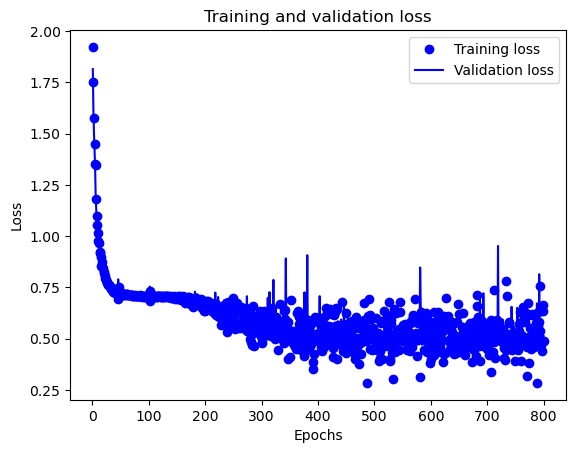

<Figure size 800x200 with 0 Axes>

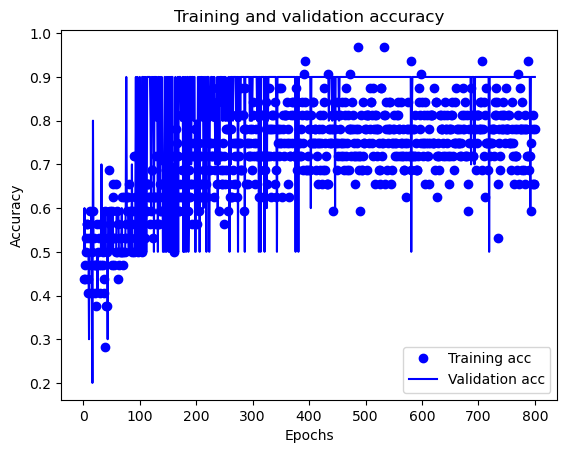

1/1 [==============================] - 0s 49ms/step


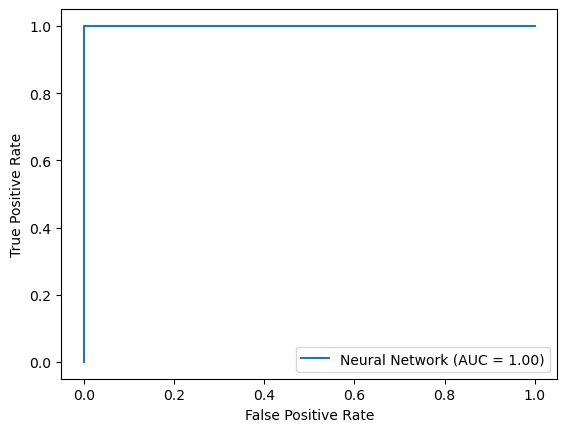

In [22]:
history_dict = history.history
history_dict.keys()
[u"accuracy", u"loss", u"val_accuracy", u"val_loss"]

import matplotlib.pyplot as plt
history_dict = history.history
loss_values = history_dict["loss"]
val_loss_values = history_dict["val_loss"]
epochs = range(1, len(loss_values) + 1)
plt.plot(epochs, loss_values, "bo", label="Training loss")      
plt.plot(epochs, val_loss_values, "b", label="Validation loss") 
plt.title("Training and validation loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()

f = plt.figure()
f.set_figwidth(8)
f.set_figheight(2)

plt.show()

plt.clf()                          
acc = history_dict["acc"]
val_acc = history_dict["val_acc"]
plt.plot(epochs, acc, "bo", label="Training acc")
plt.plot(epochs, val_acc, "b", label="Validation acc")
plt.title("Training and validation accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()
plt.show()

# Create an ROC Curve plot.
predictions = model.predict(test_x)

fpr, tpr, thresholds = metrics.roc_curve(test_y, predictions)
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,
                                  estimator_name='Neural Network')
display.plot()
plt.show()

### K Fold Validation Function #2

In [15]:
def kFold2(model, train_x, train_y):
    k = 5
    num_val_samples = len(train_x) // k
    num_epochs = 200 
    all_scores = [] 
    for i in range(k):
        print(f"Processing fold #{i}")
        val_data = train_x[i * num_val_samples: (i + 1) * num_val_samples]   
        val_targets = train_y[i * num_val_samples: (i + 1) * num_val_samples]
        partial_train_data = np.concatenate(                                    
            [train_x[:i * num_val_samples],
             train_x[(i + 1) * num_val_samples:]],
            axis=0)
        partial_train_targets = np.concatenate(
            [train_y[:i * num_val_samples],
             train_y[(i + 1) * num_val_samples:]],
            axis=0)                                                  
        model.fit(partial_train_data, partial_train_targets,                    
                  epochs=num_epochs, batch_size=1, verbose=0)
        loss, val_acc = model.evaluate(val_x, val_y, verbose=0)     
        all_scores.append(val_acc)
    print("Fold Accuracies: ", all_scores)
    print("Average Accuracy: ", np.mean(all_scores))

### Plot Participant Data

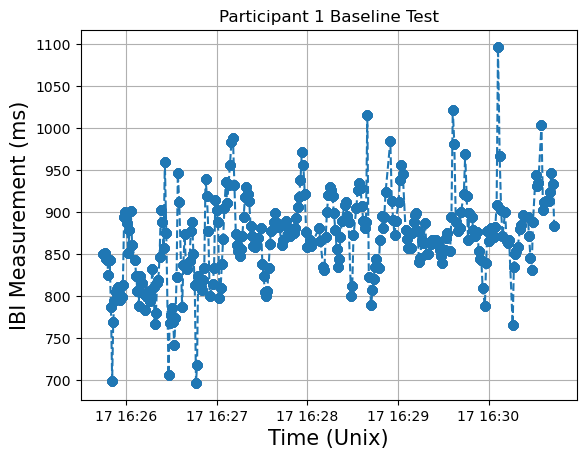

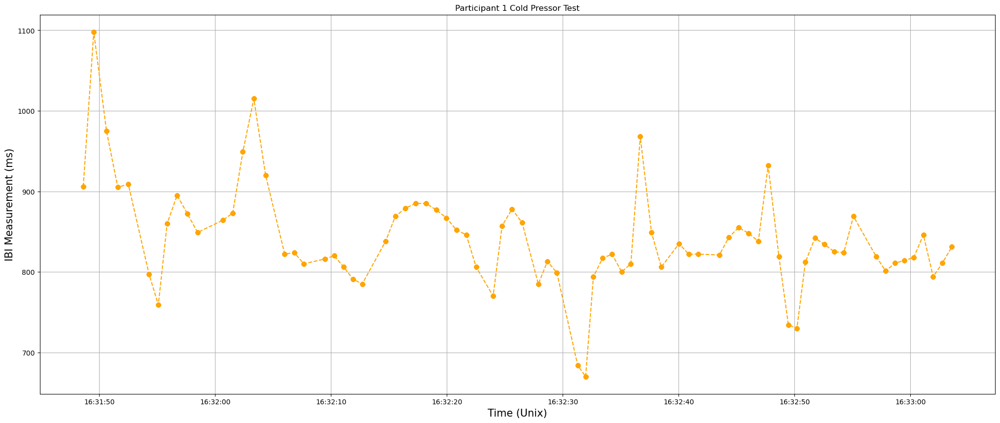

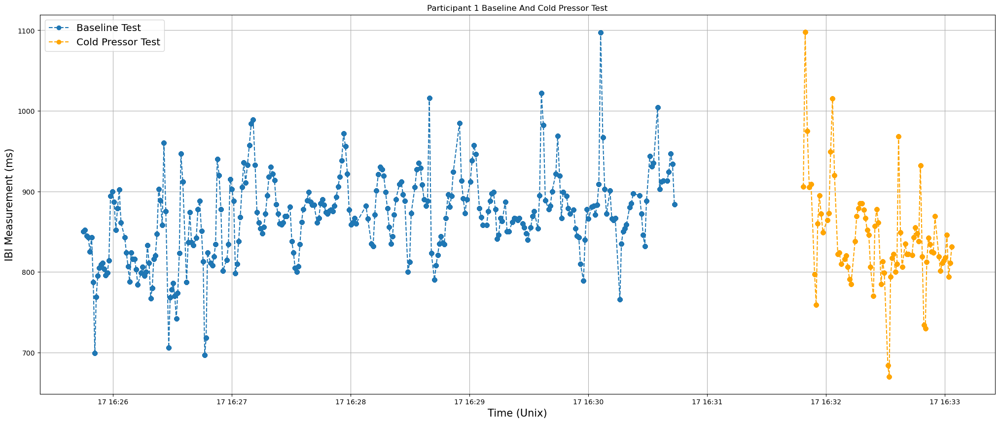

<Figure size 2500x1000 with 0 Axes>

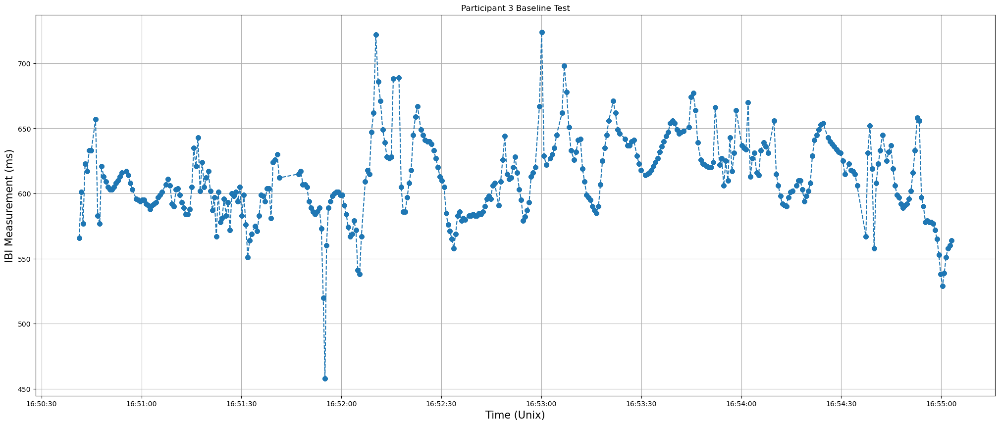

<Figure size 2500x1000 with 0 Axes>

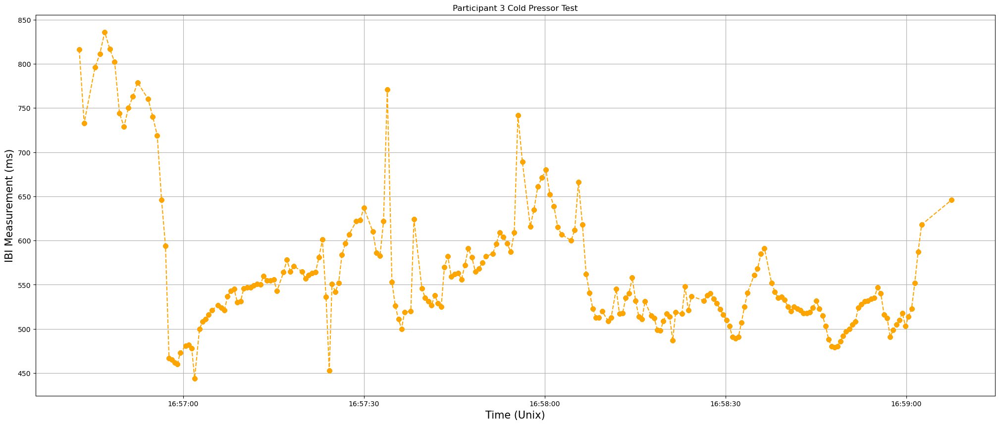

<Figure size 2500x1000 with 0 Axes>

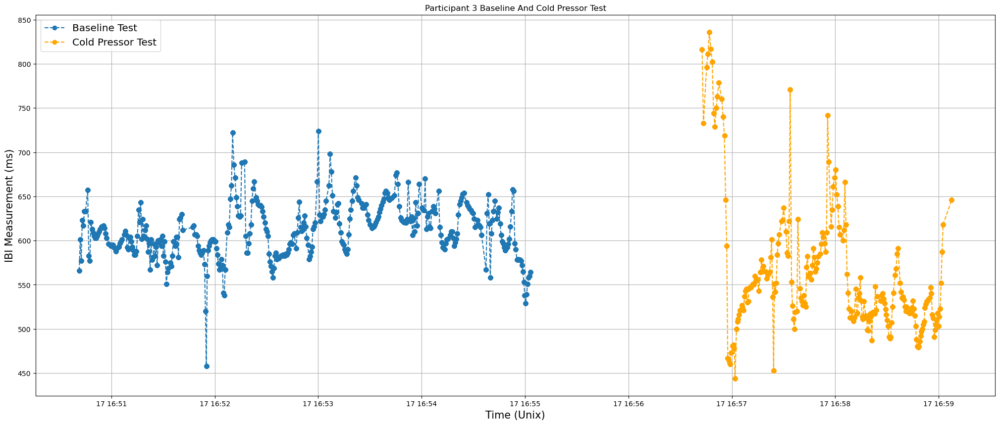

<Figure size 2500x1000 with 0 Axes>

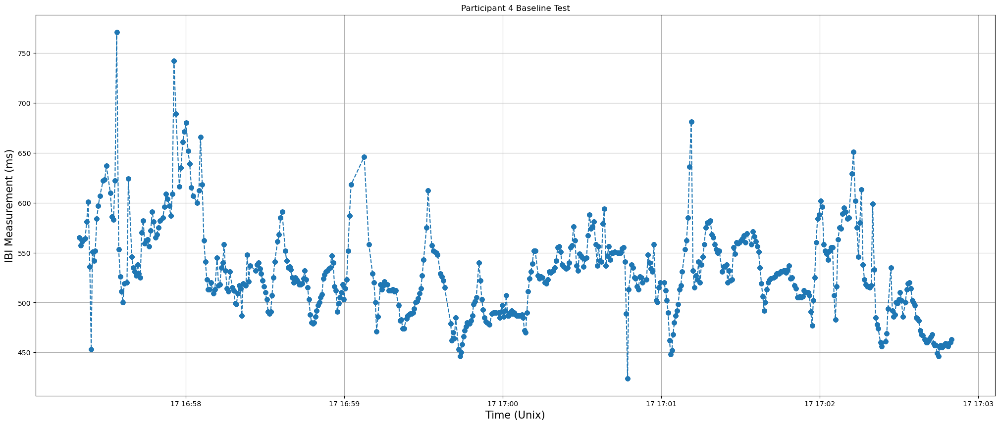

<Figure size 2500x1000 with 0 Axes>

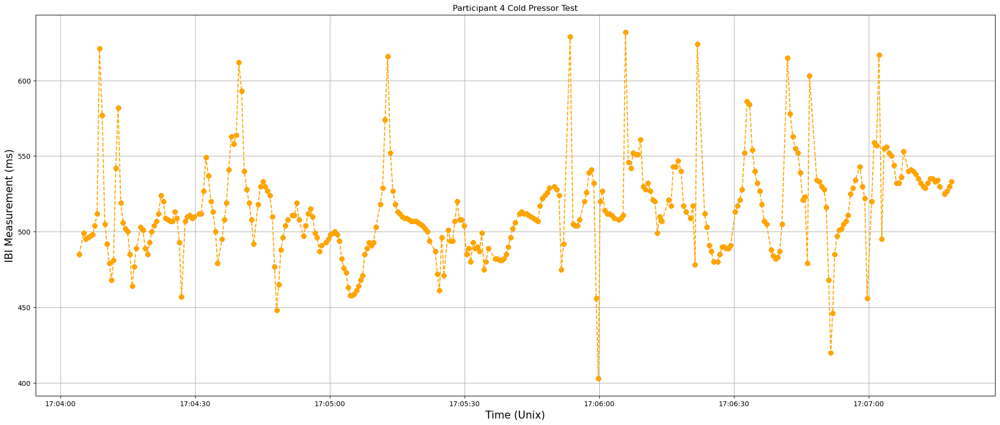

<Figure size 2500x1000 with 0 Axes>

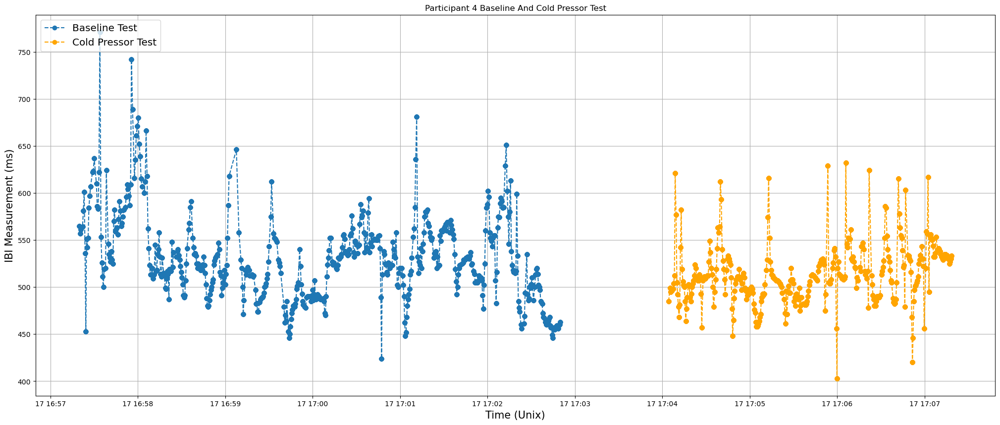

<Figure size 2500x1000 with 0 Axes>

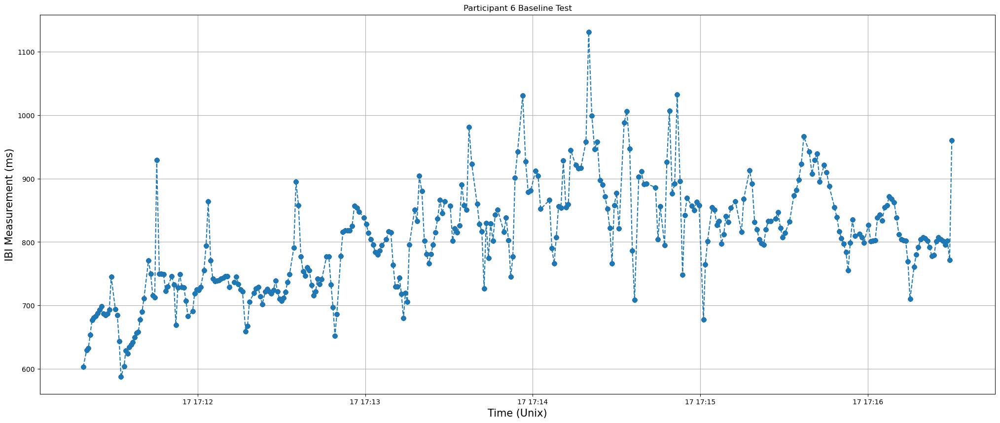

<Figure size 2500x1000 with 0 Axes>

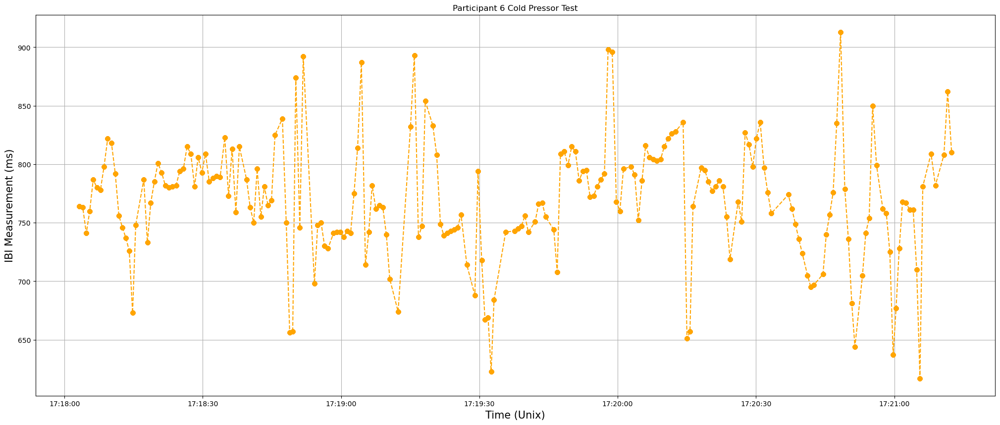

<Figure size 2500x1000 with 0 Axes>

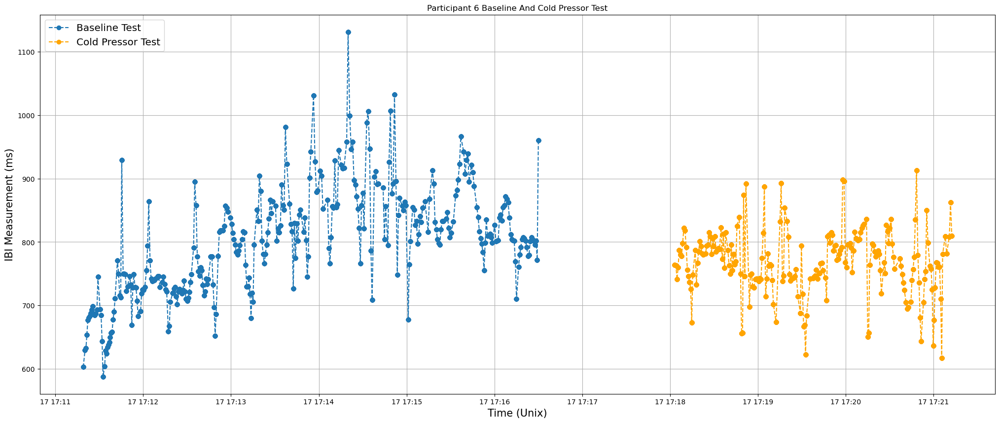

<Figure size 2500x1000 with 0 Axes>

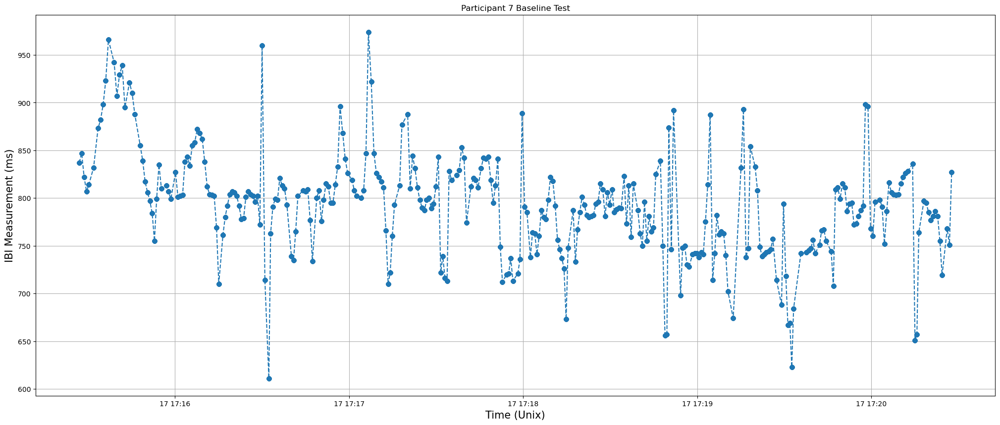

<Figure size 2500x1000 with 0 Axes>

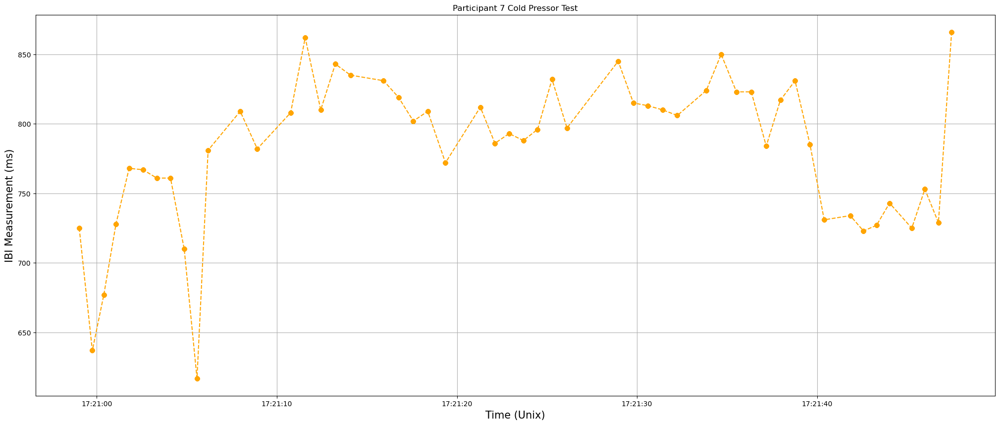

<Figure size 2500x1000 with 0 Axes>

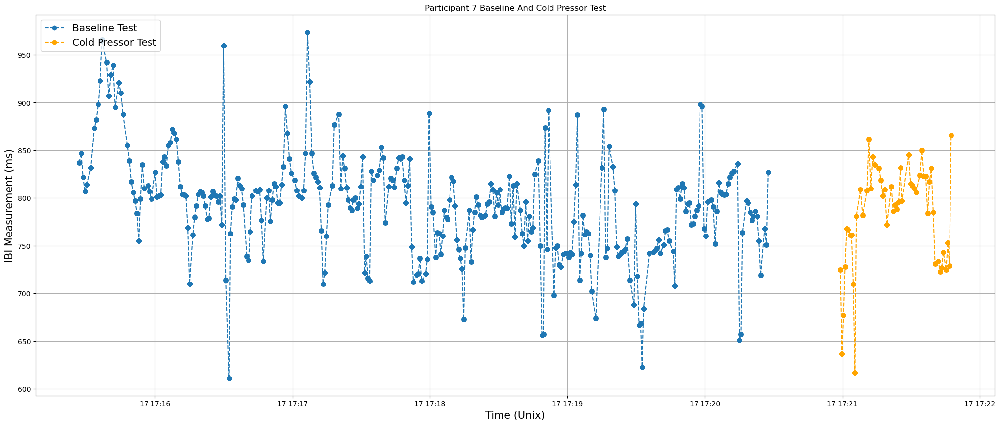

<Figure size 2500x1000 with 0 Axes>

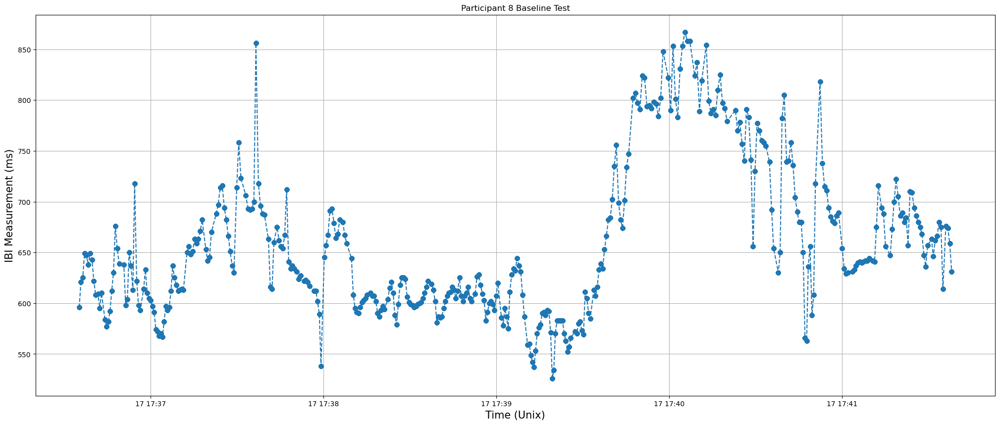

<Figure size 2500x1000 with 0 Axes>

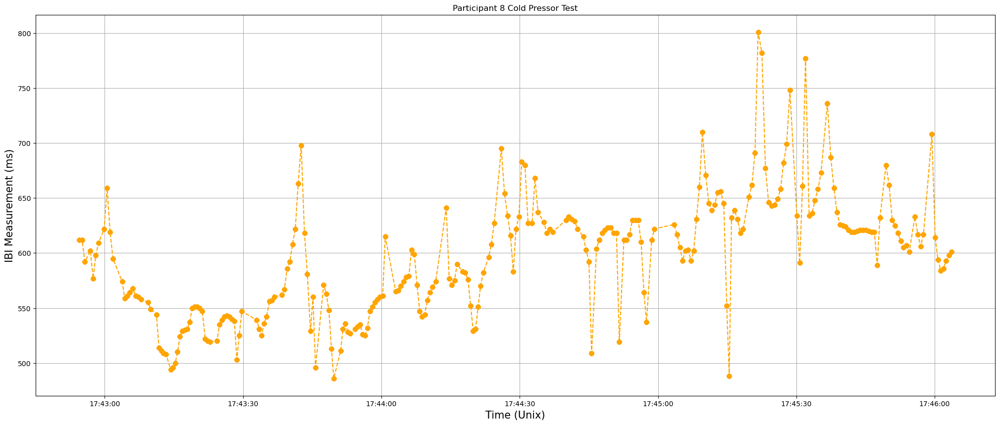

<Figure size 2500x1000 with 0 Axes>

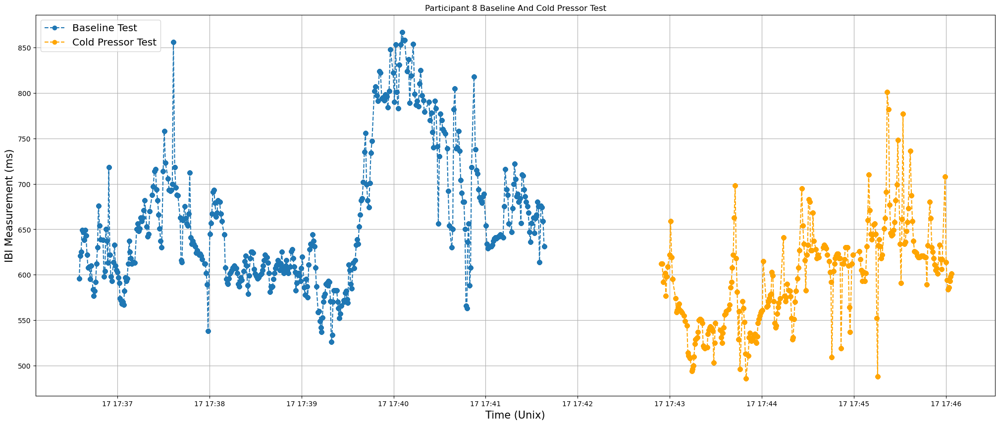

<Figure size 2500x1000 with 0 Axes>

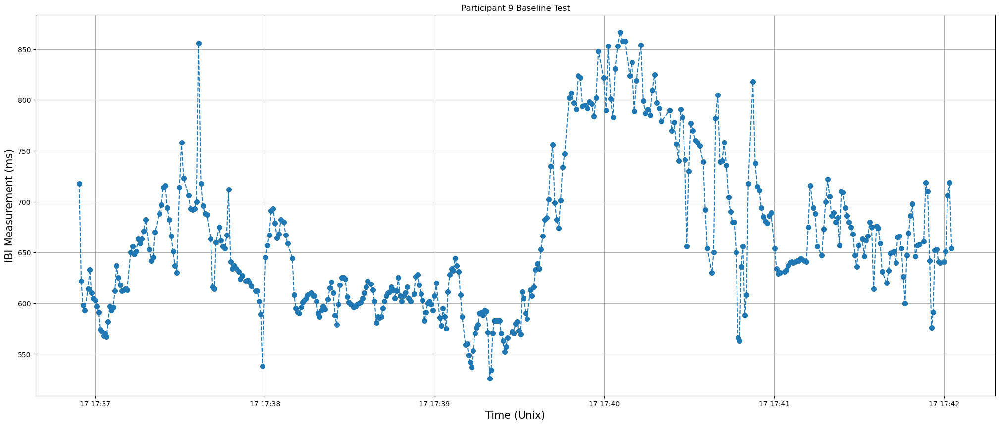

<Figure size 2500x1000 with 0 Axes>

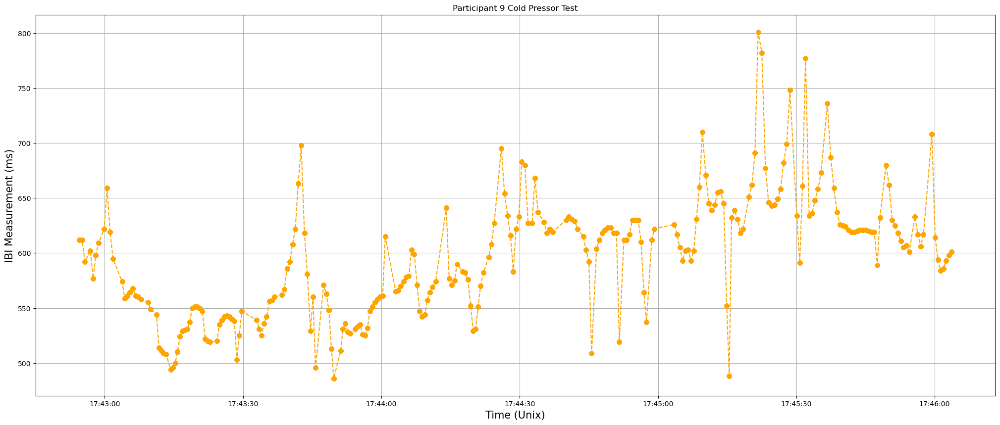

<Figure size 2500x1000 with 0 Axes>

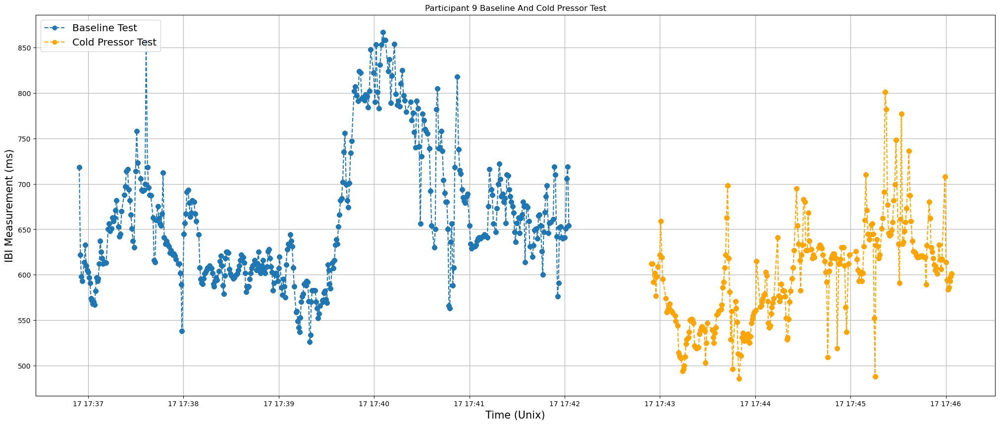

<Figure size 2500x1000 with 0 Axes>

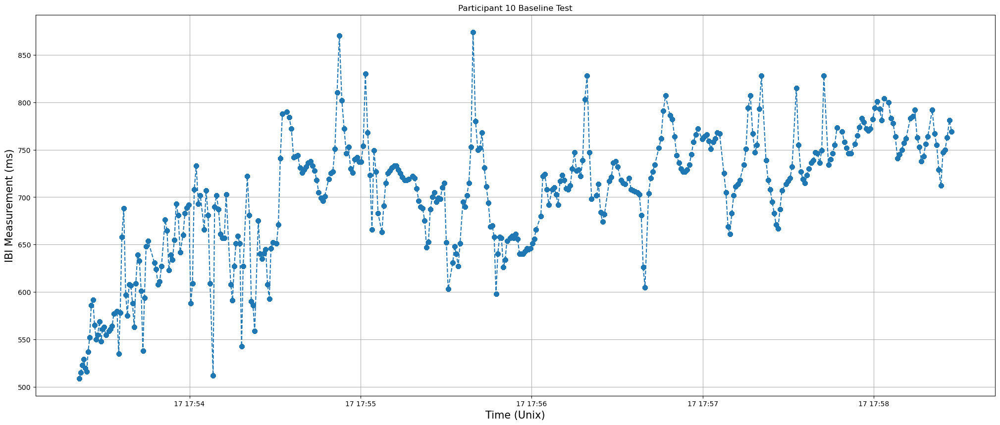

<Figure size 2500x1000 with 0 Axes>

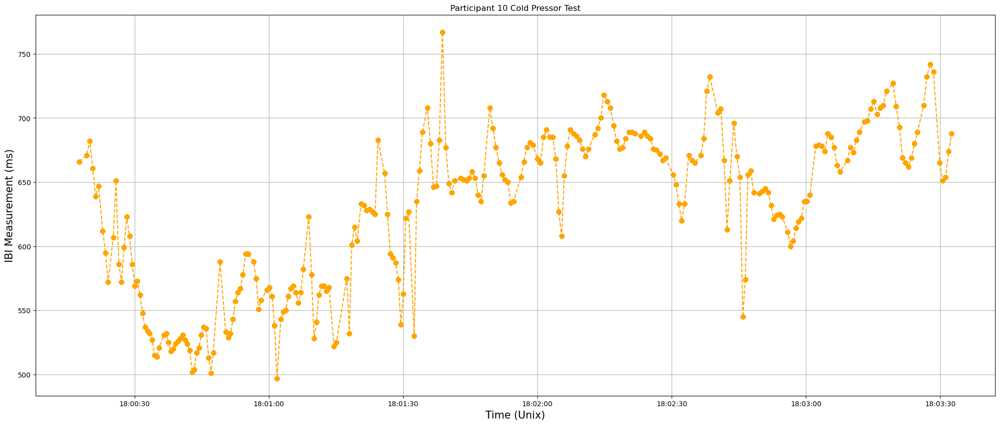

<Figure size 2500x1000 with 0 Axes>

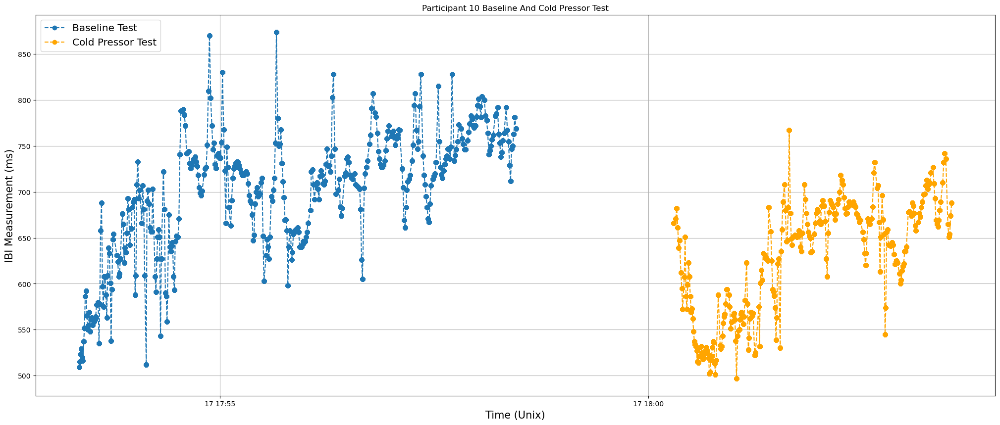

<Figure size 2500x1000 with 0 Axes>

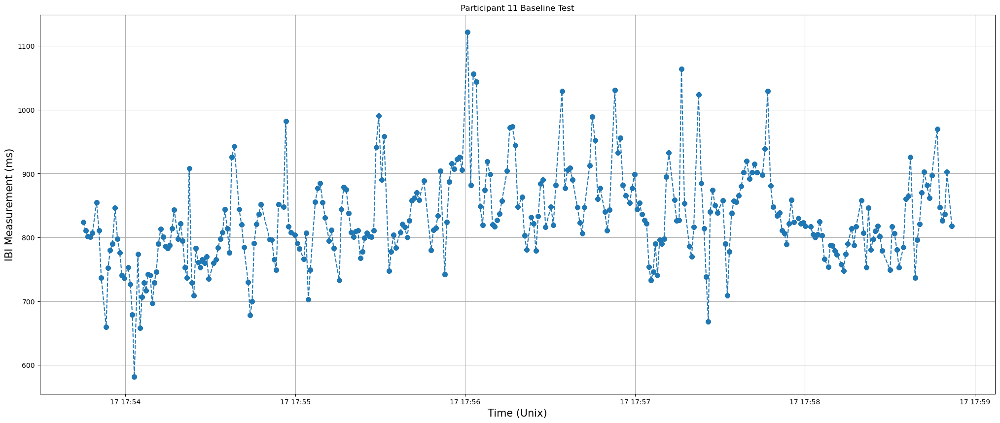

<Figure size 2500x1000 with 0 Axes>

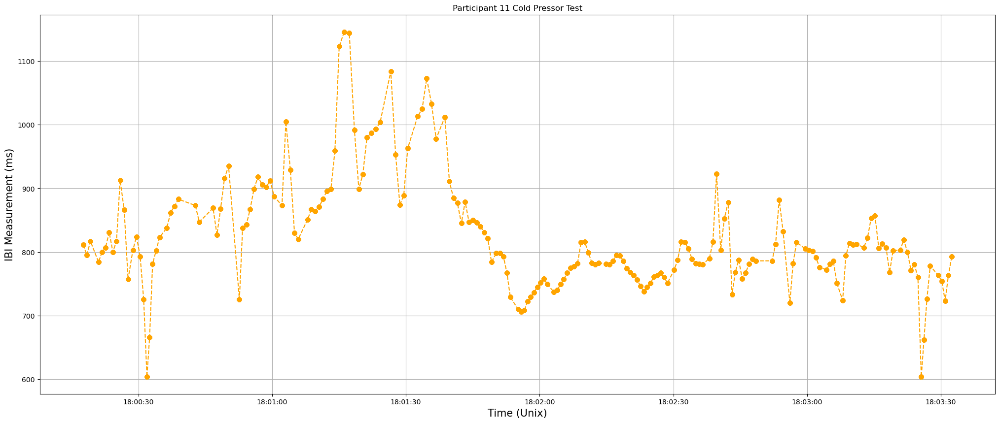

<Figure size 2500x1000 with 0 Axes>

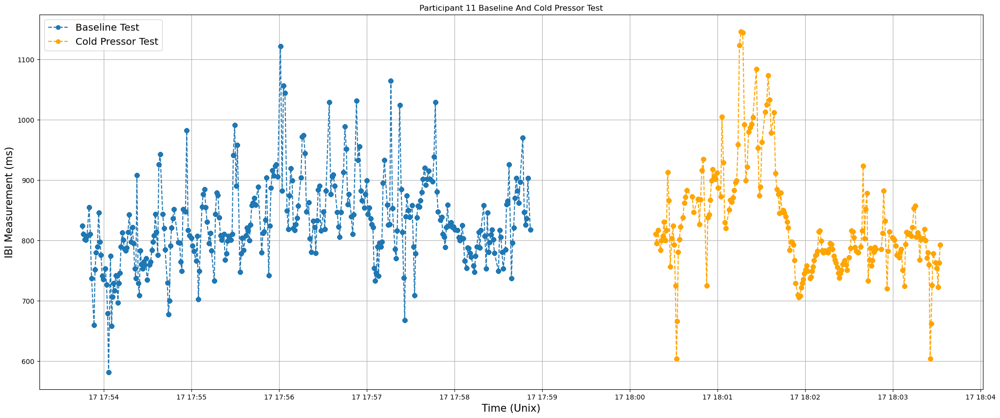

<Figure size 2500x1000 with 0 Axes>

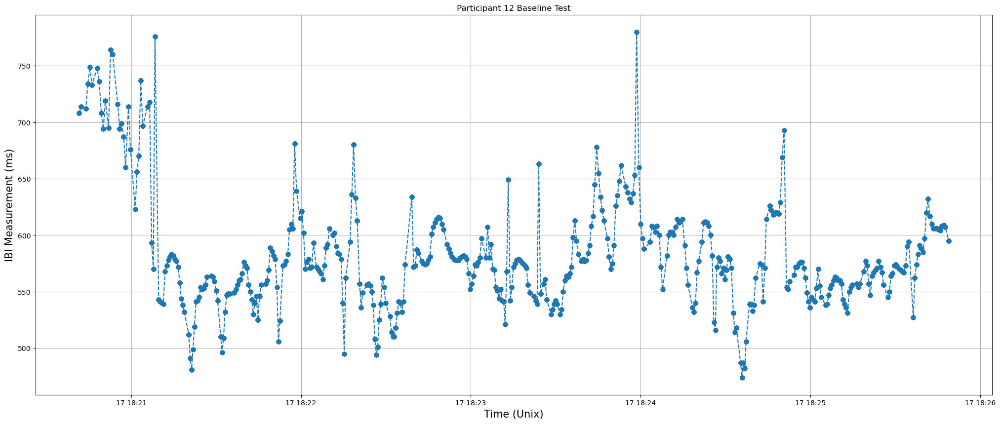

<Figure size 2500x1000 with 0 Axes>

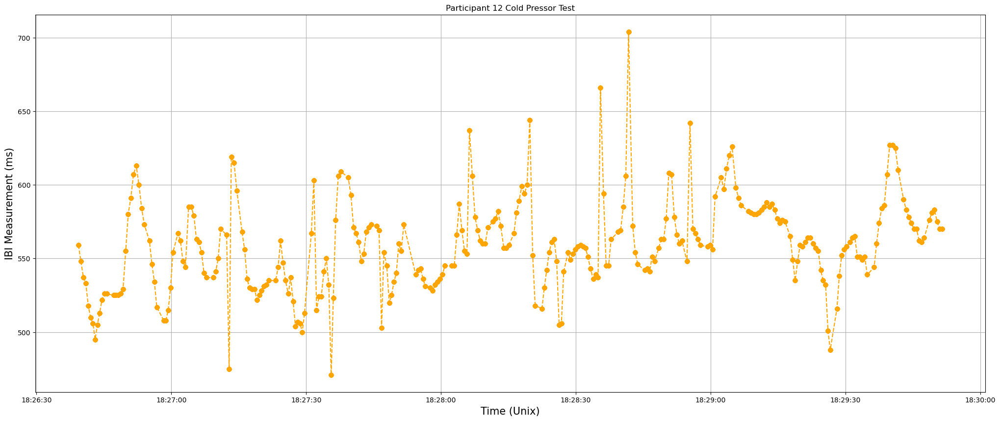

<Figure size 2500x1000 with 0 Axes>

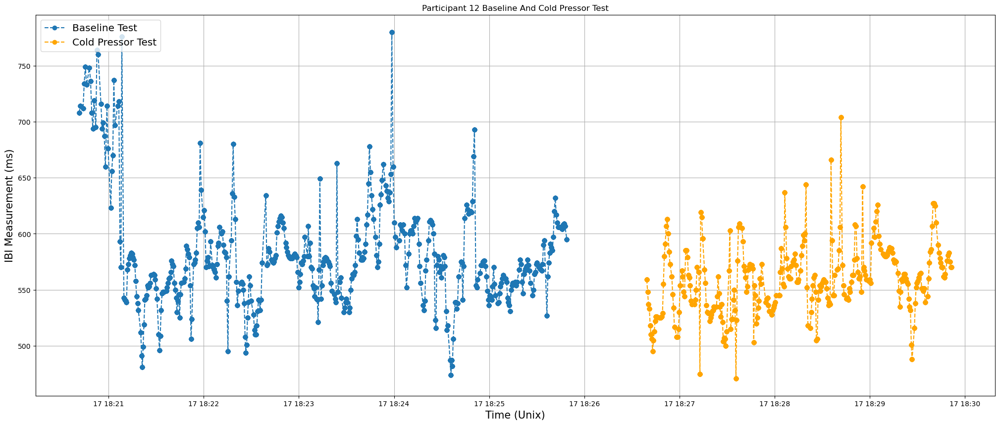

<Figure size 2500x1000 with 0 Axes>

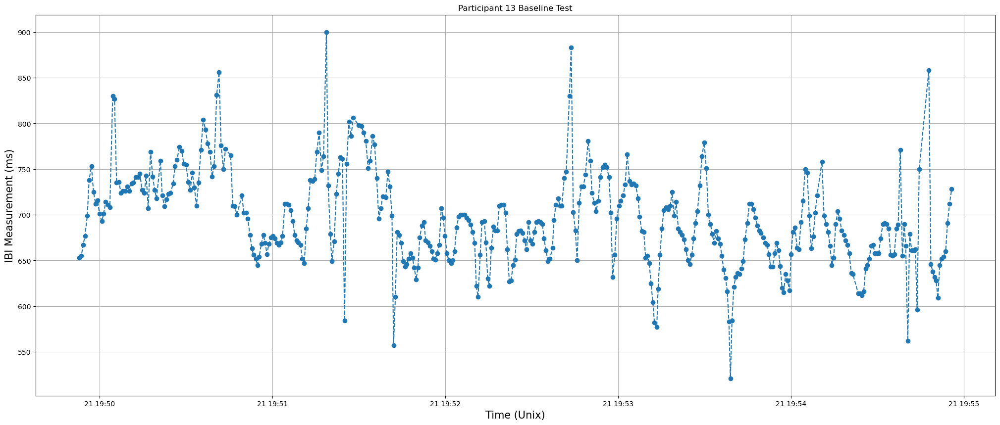

<Figure size 2500x1000 with 0 Axes>

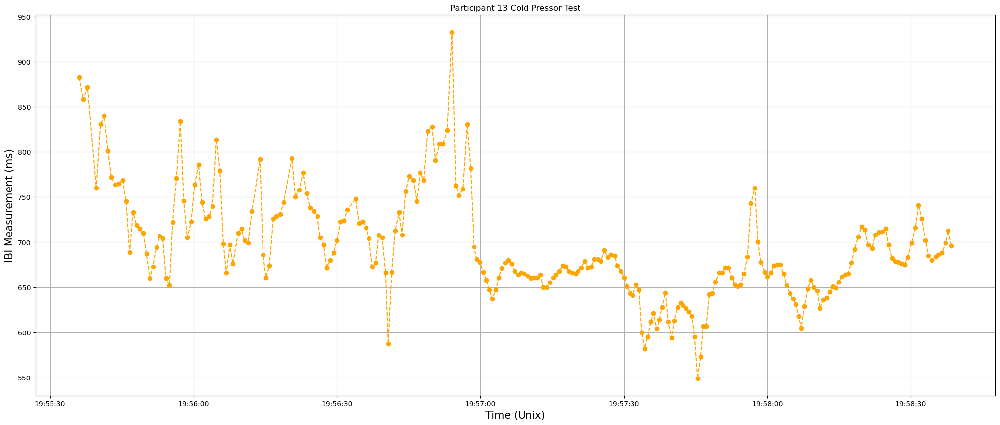

<Figure size 2500x1000 with 0 Axes>

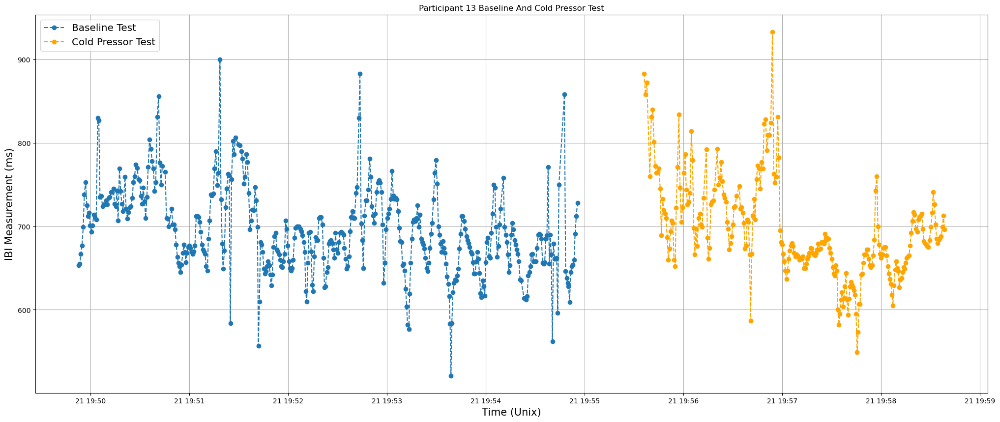

<Figure size 2500x1000 with 0 Axes>

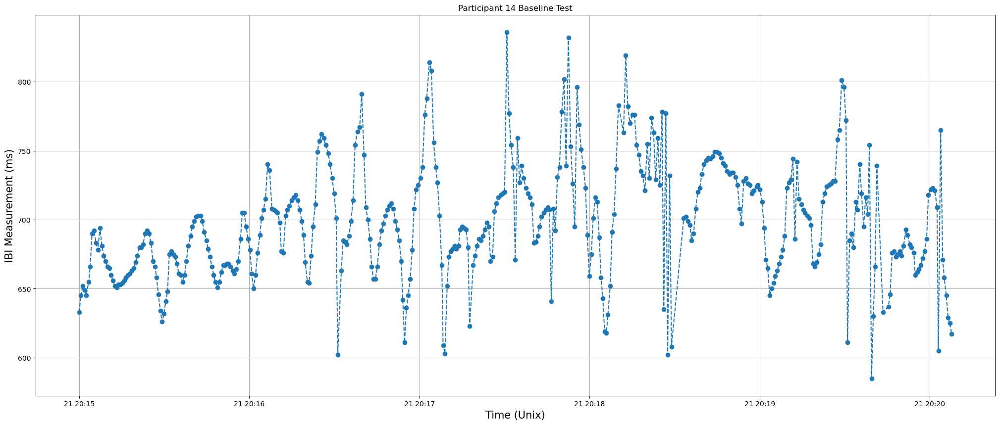

<Figure size 2500x1000 with 0 Axes>

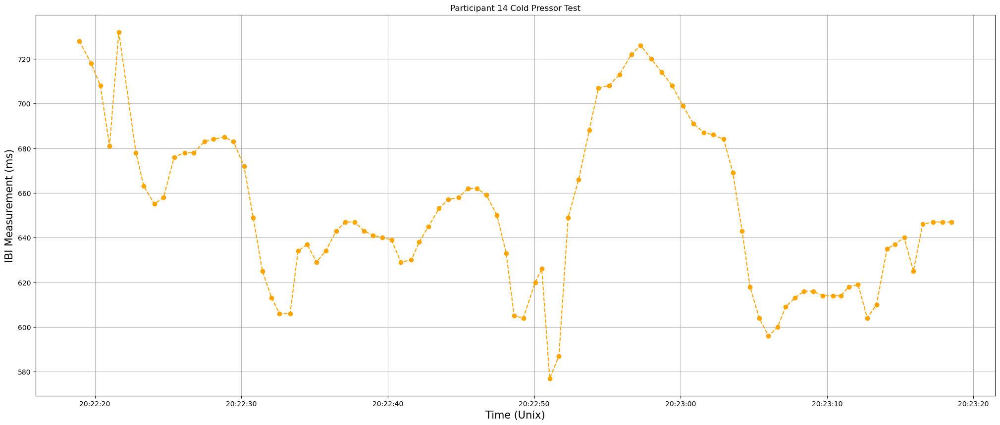

<Figure size 2500x1000 with 0 Axes>

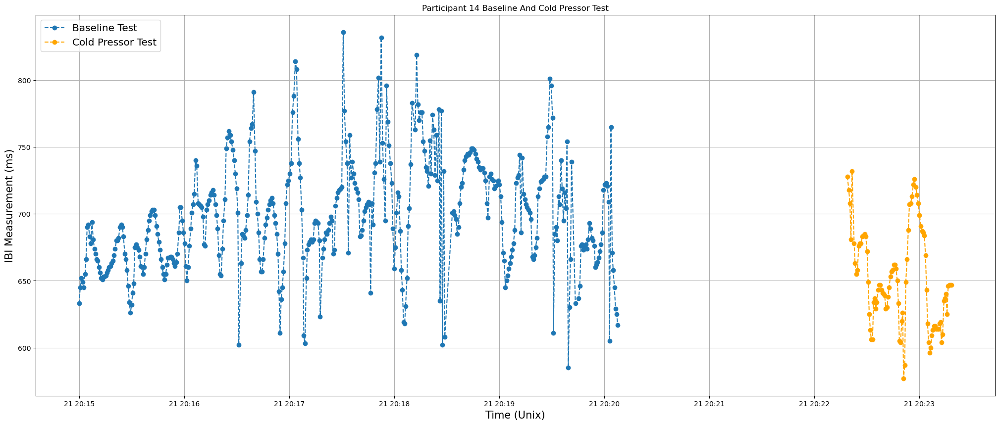

<Figure size 2500x1000 with 0 Axes>

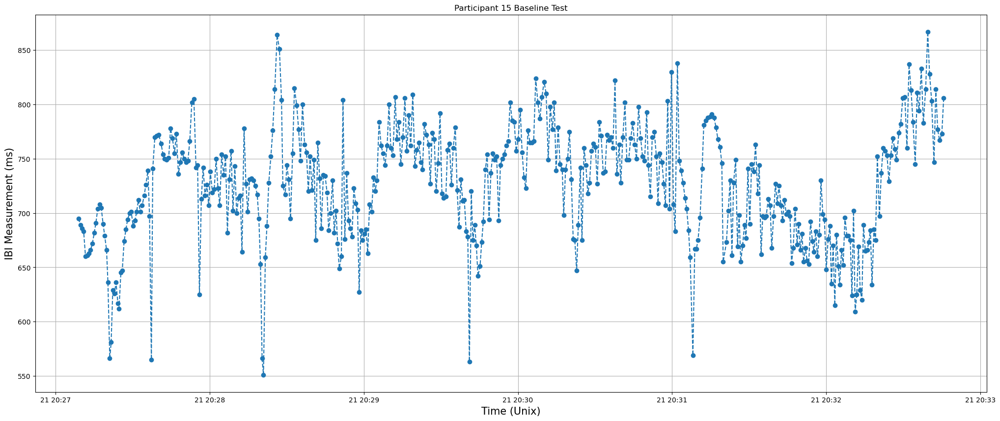

<Figure size 2500x1000 with 0 Axes>

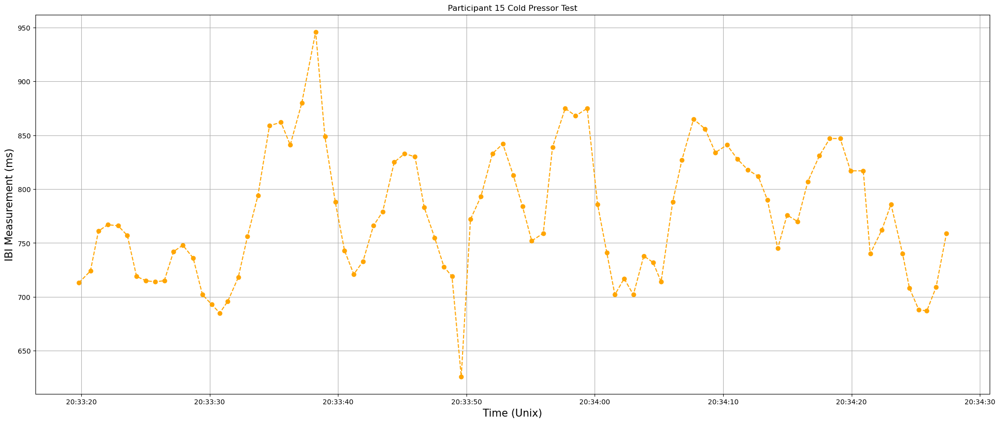

<Figure size 2500x1000 with 0 Axes>

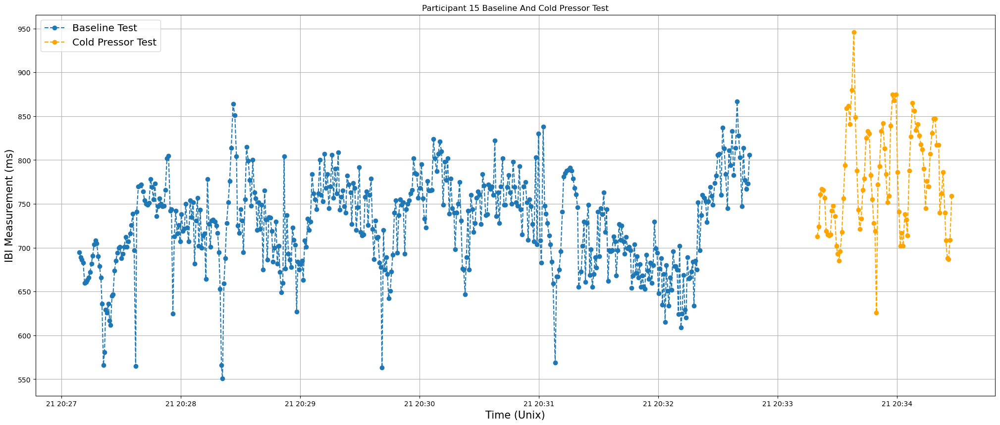

<Figure size 2500x1000 with 0 Axes>

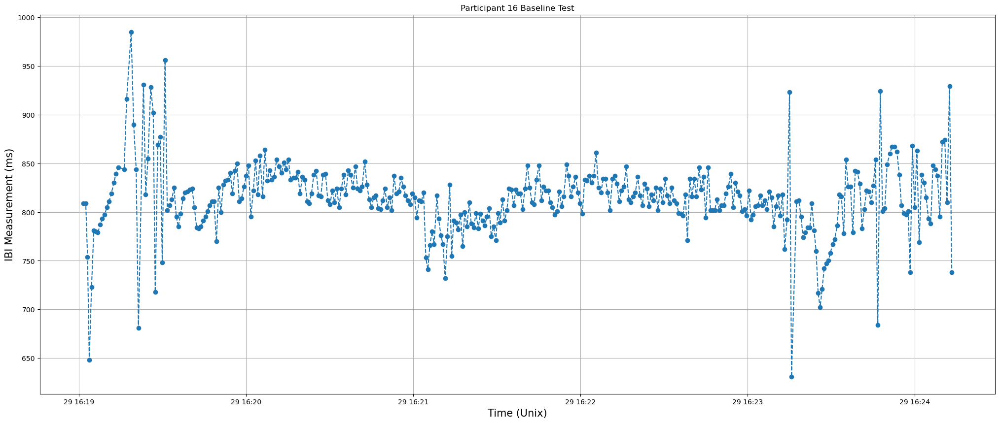

<Figure size 2500x1000 with 0 Axes>

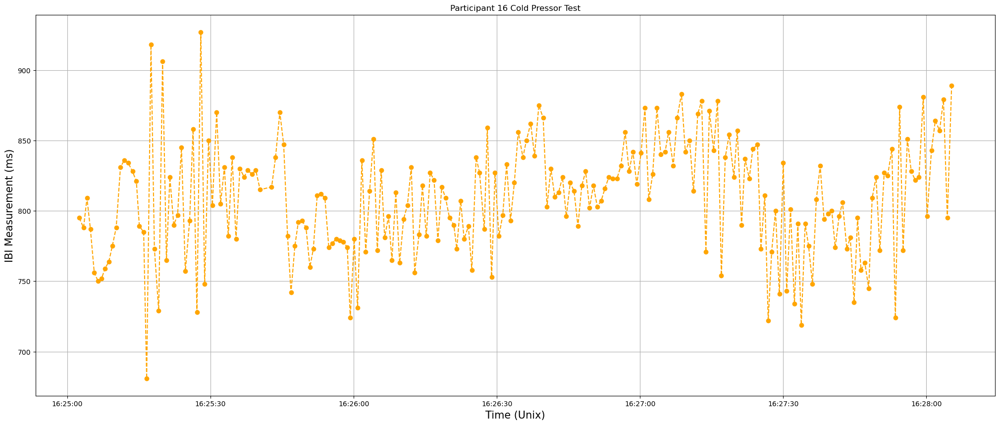

<Figure size 2500x1000 with 0 Axes>

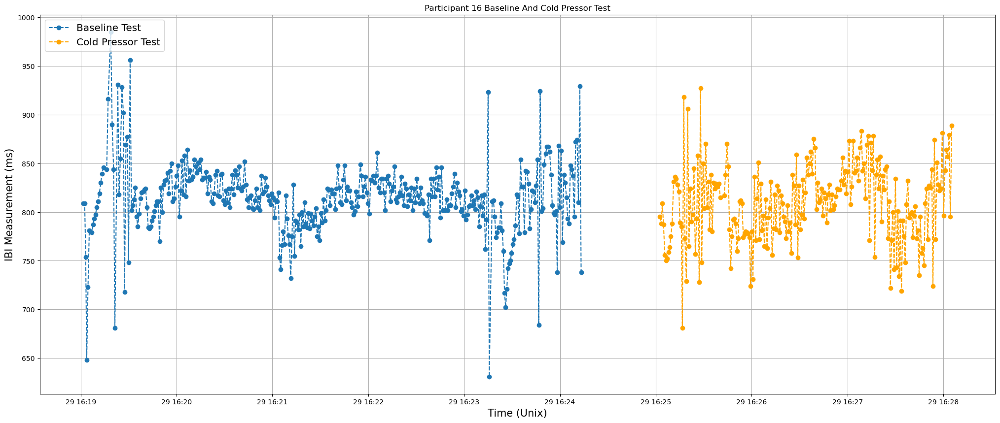

<Figure size 2500x1000 with 0 Axes>

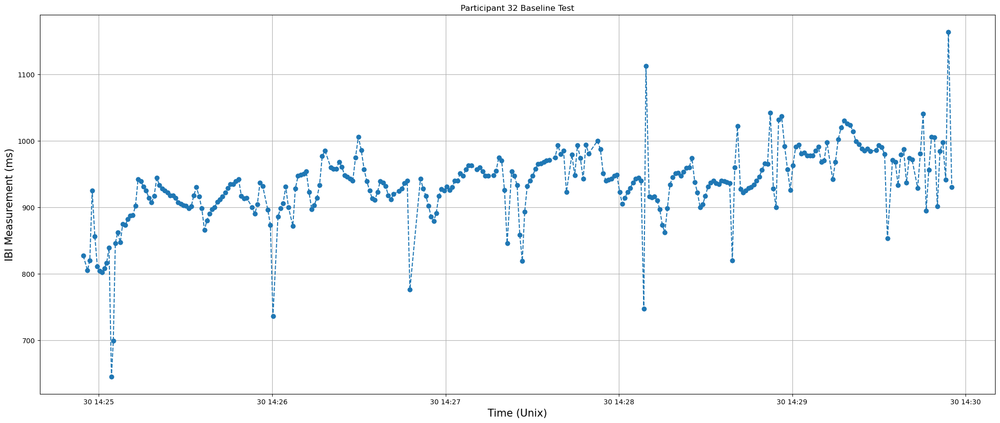

<Figure size 2500x1000 with 0 Axes>

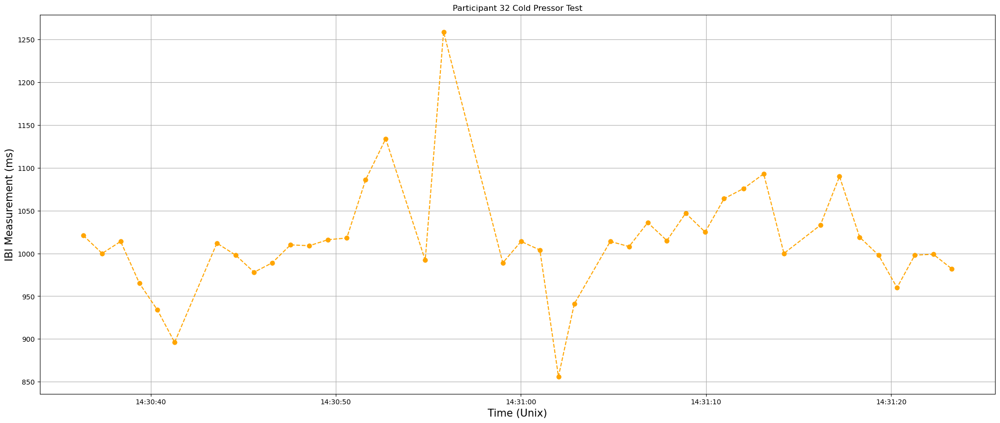

<Figure size 2500x1000 with 0 Axes>

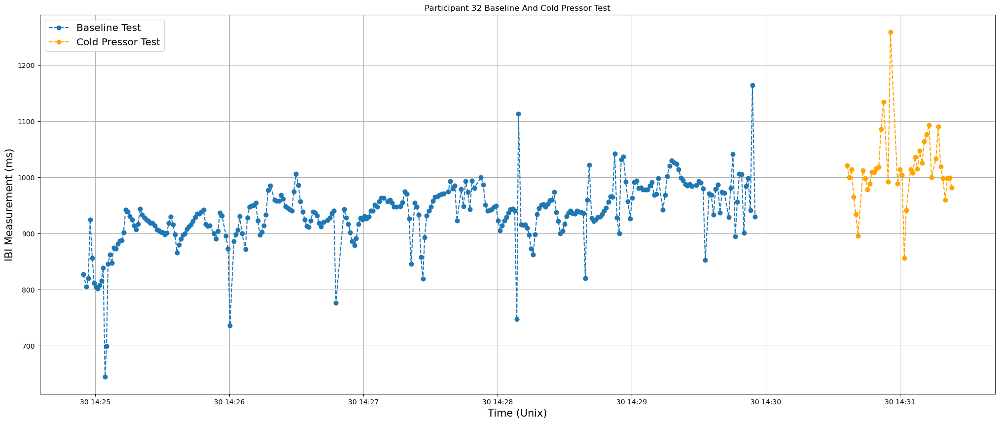

<Figure size 2500x1000 with 0 Axes>

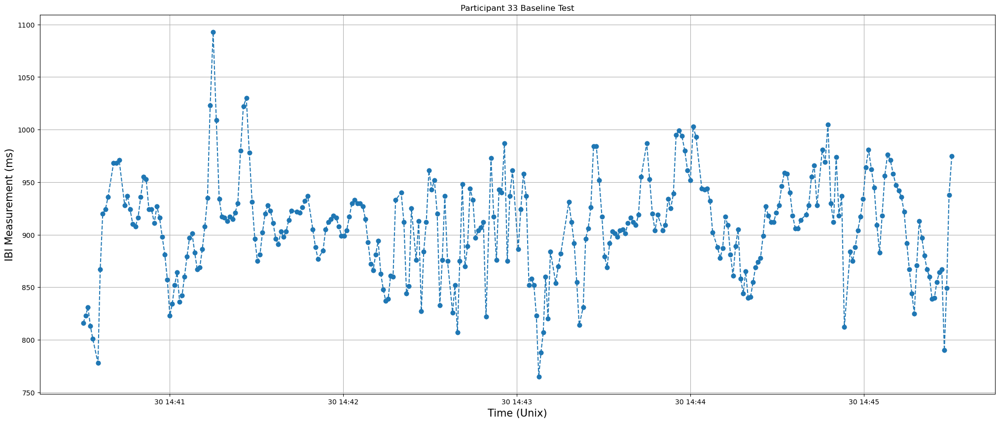

<Figure size 2500x1000 with 0 Axes>

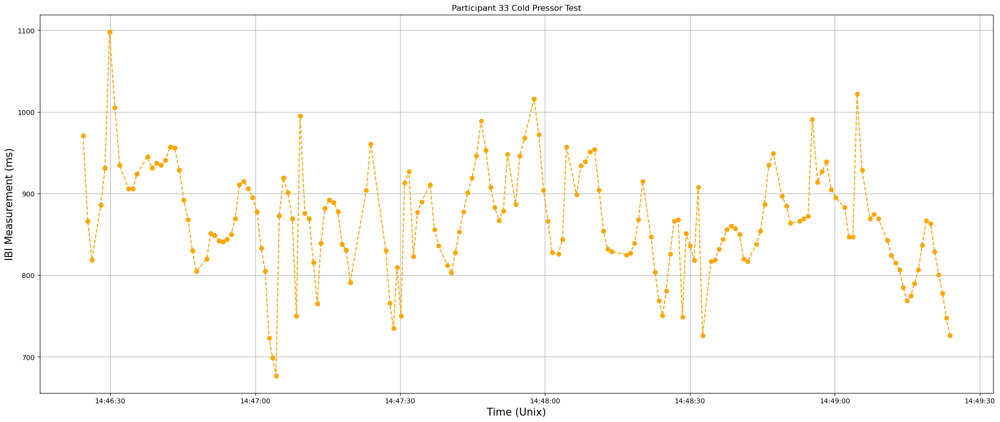

<Figure size 2500x1000 with 0 Axes>

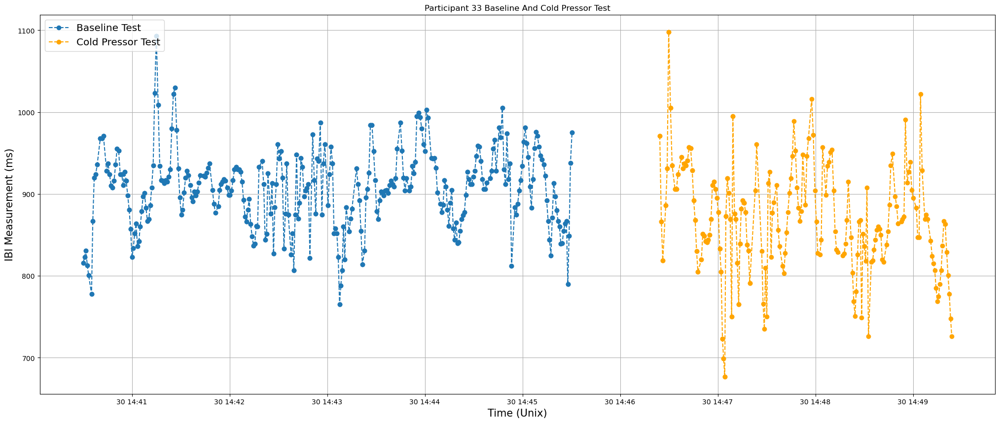

<Figure size 2500x1000 with 0 Axes>

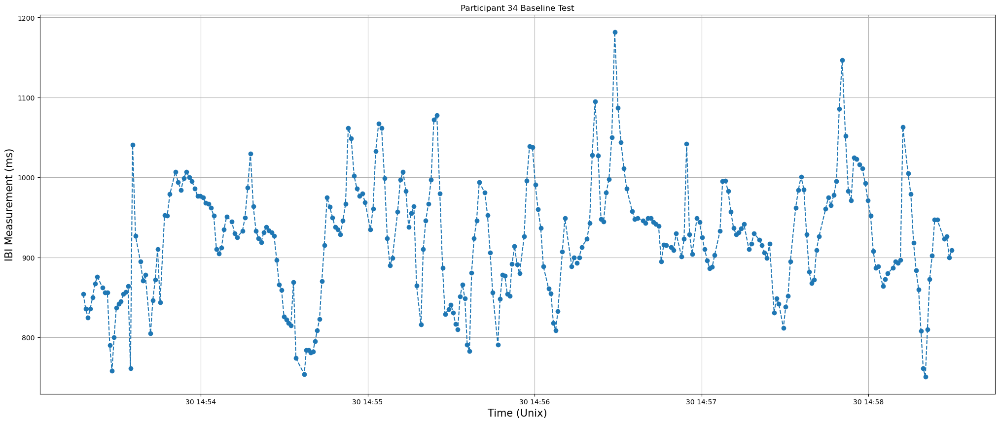

<Figure size 2500x1000 with 0 Axes>

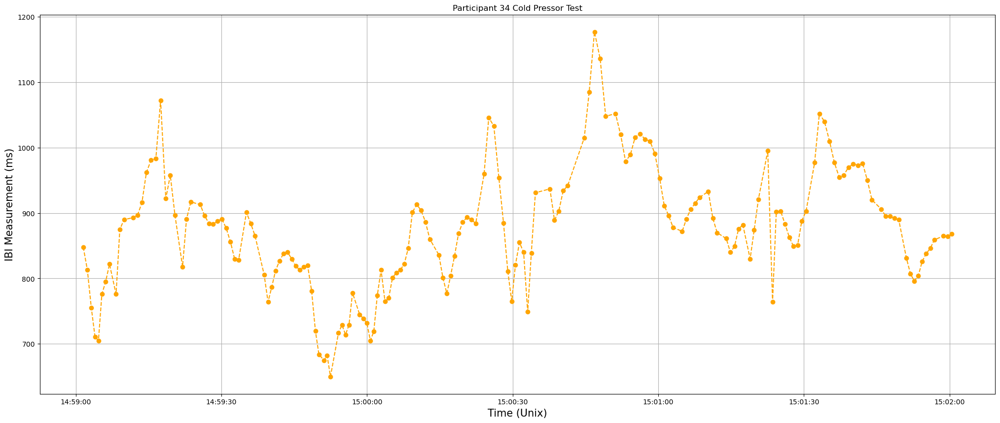

<Figure size 2500x1000 with 0 Axes>

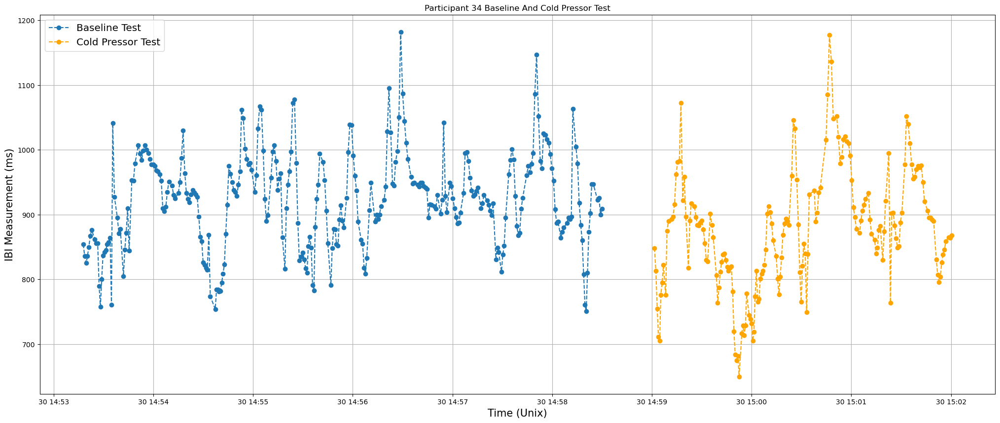

<Figure size 2500x1000 with 0 Axes>

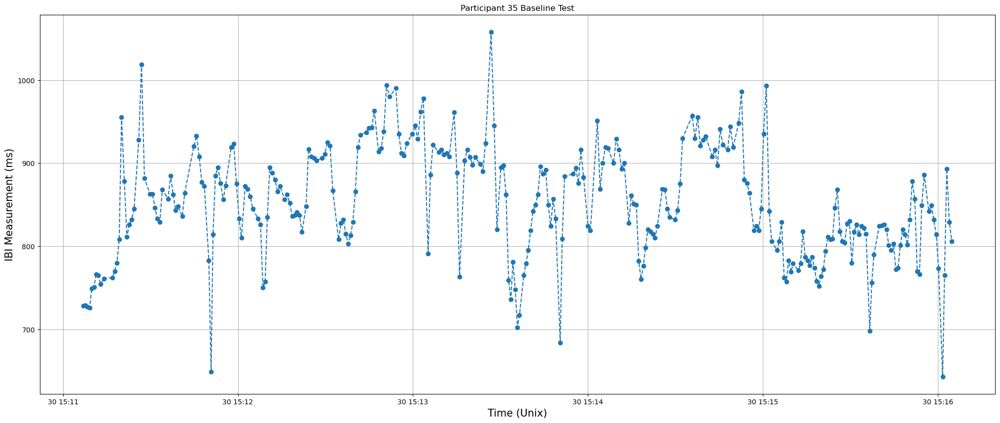

<Figure size 2500x1000 with 0 Axes>

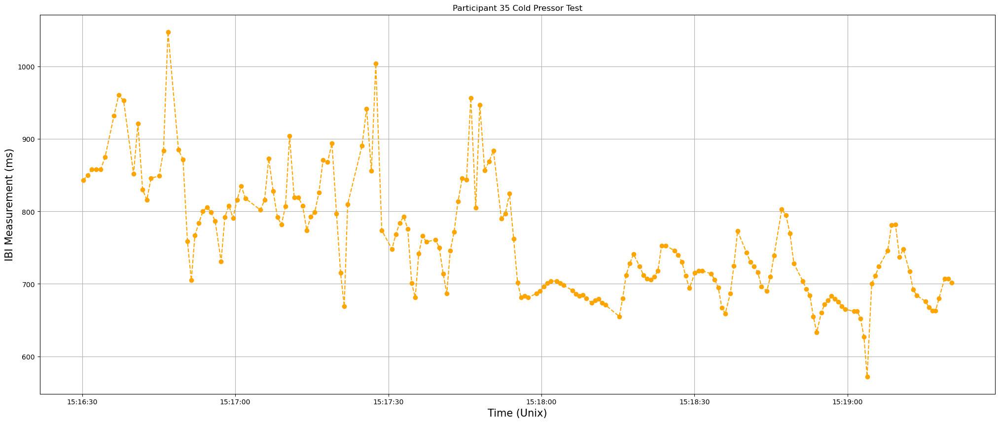

<Figure size 2500x1000 with 0 Axes>

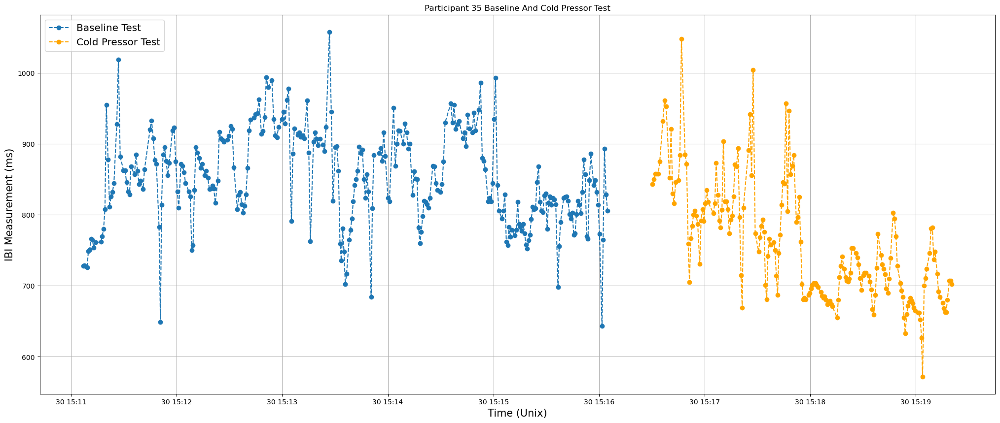

<Figure size 2500x1000 with 0 Axes>

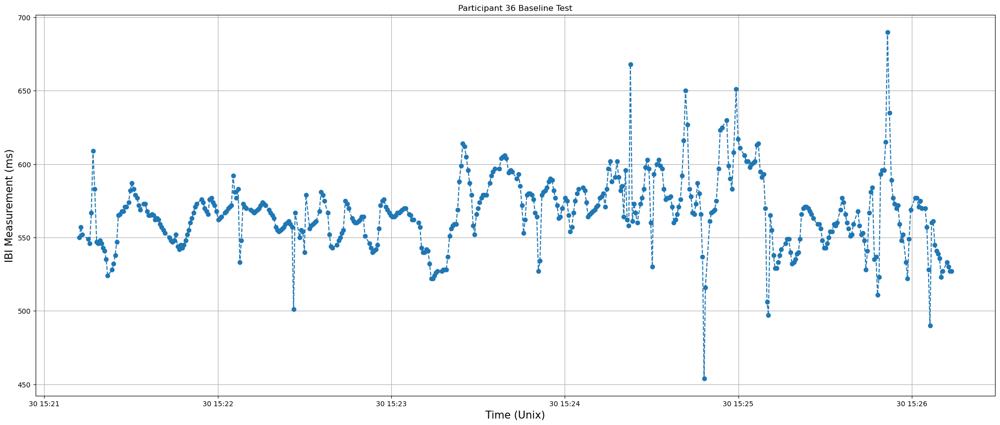

<Figure size 2500x1000 with 0 Axes>

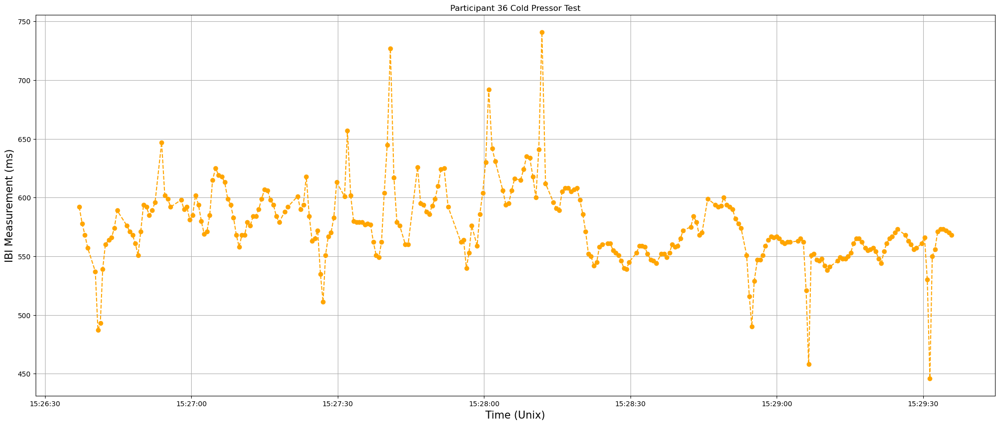

<Figure size 2500x1000 with 0 Axes>

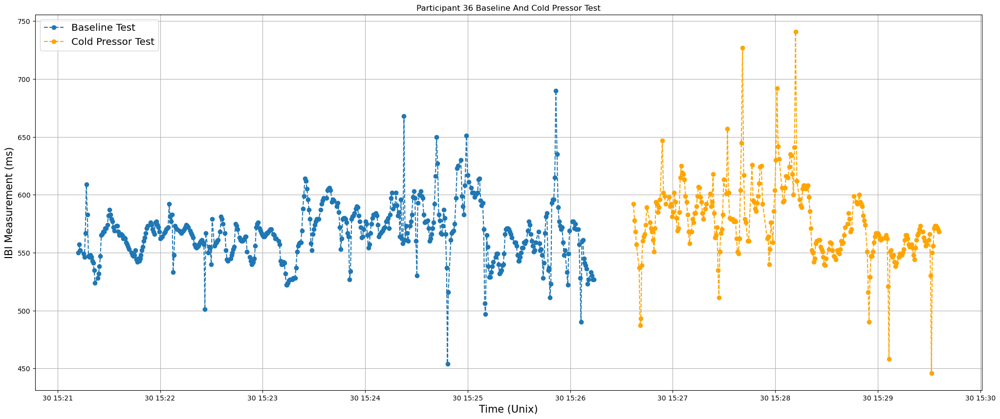

<Figure size 2500x1000 with 0 Axes>

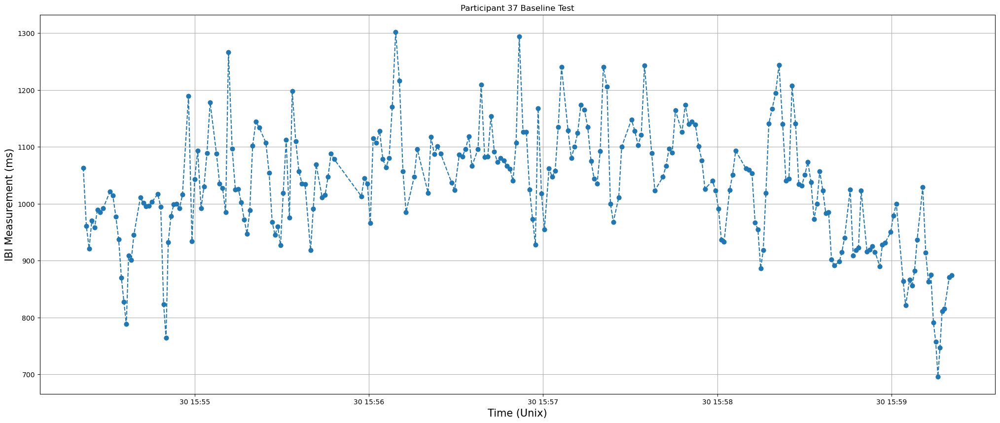

<Figure size 2500x1000 with 0 Axes>

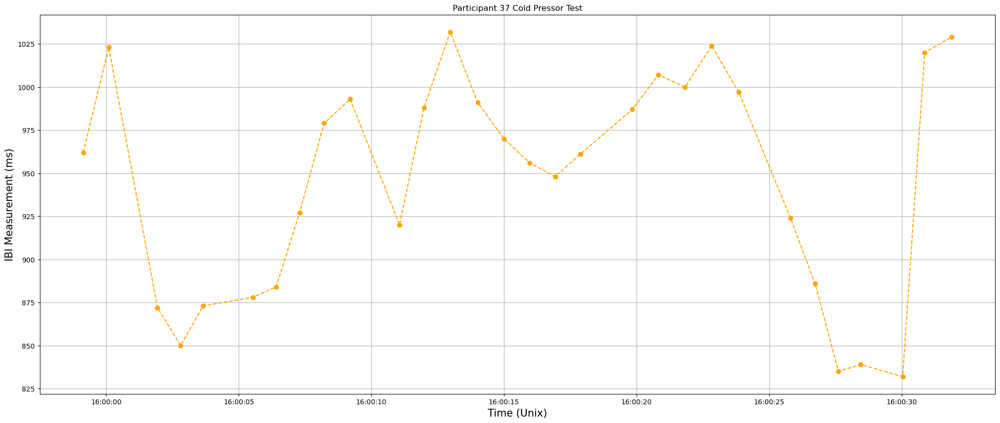

<Figure size 2500x1000 with 0 Axes>

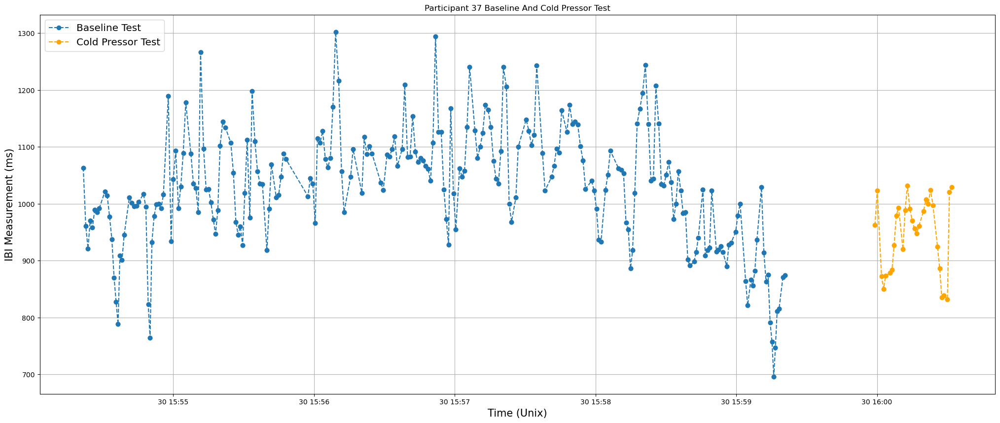

<Figure size 2500x1000 with 0 Axes>

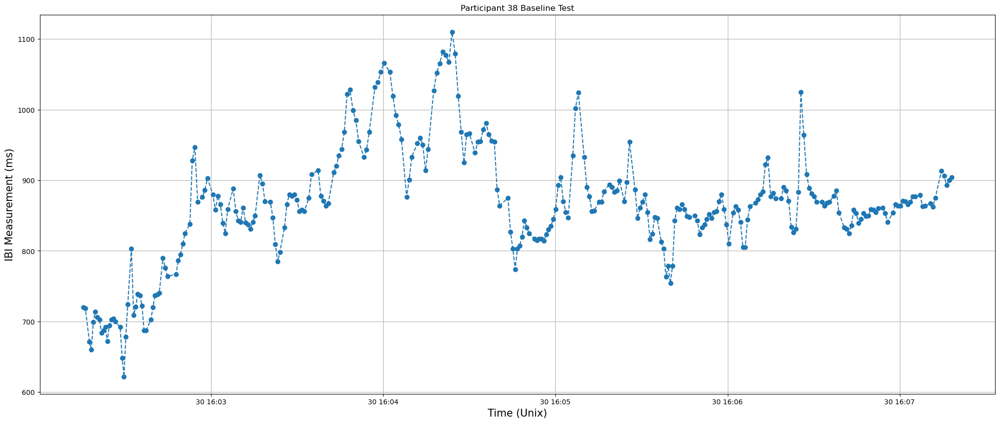

<Figure size 2500x1000 with 0 Axes>

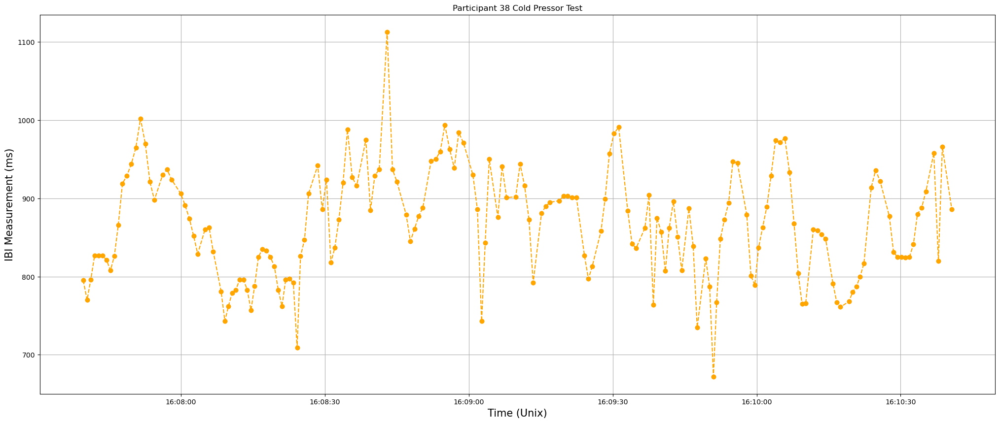

<Figure size 2500x1000 with 0 Axes>

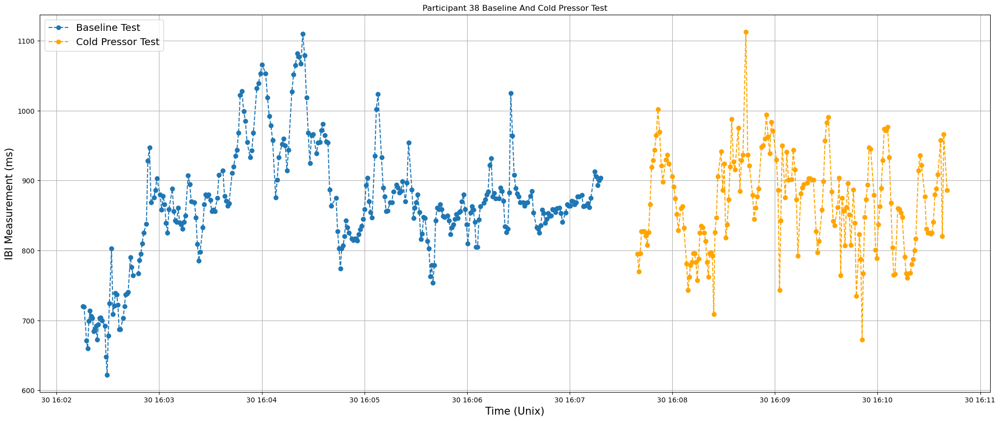

<Figure size 2500x1000 with 0 Axes>

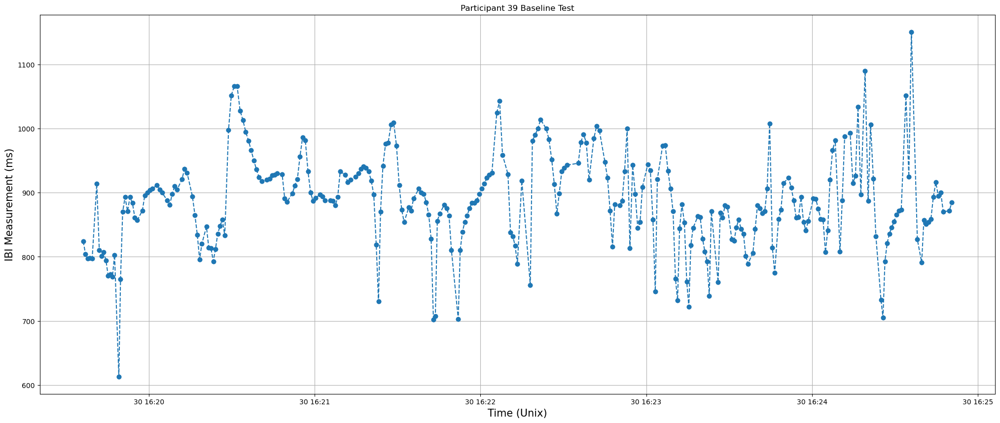

<Figure size 2500x1000 with 0 Axes>

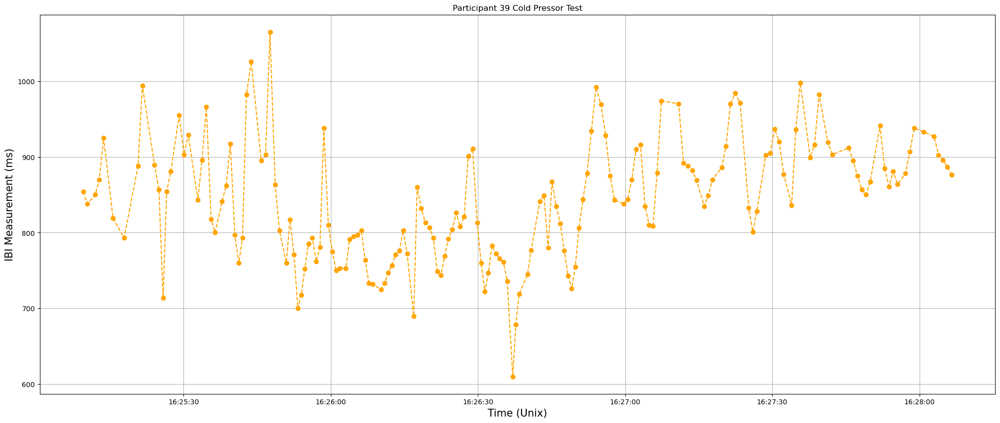

<Figure size 2500x1000 with 0 Axes>

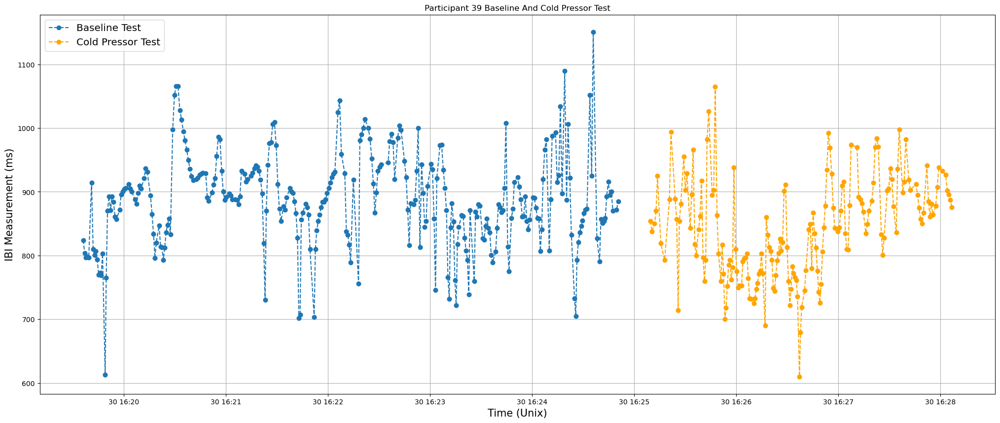

<Figure size 2500x1000 with 0 Axes>

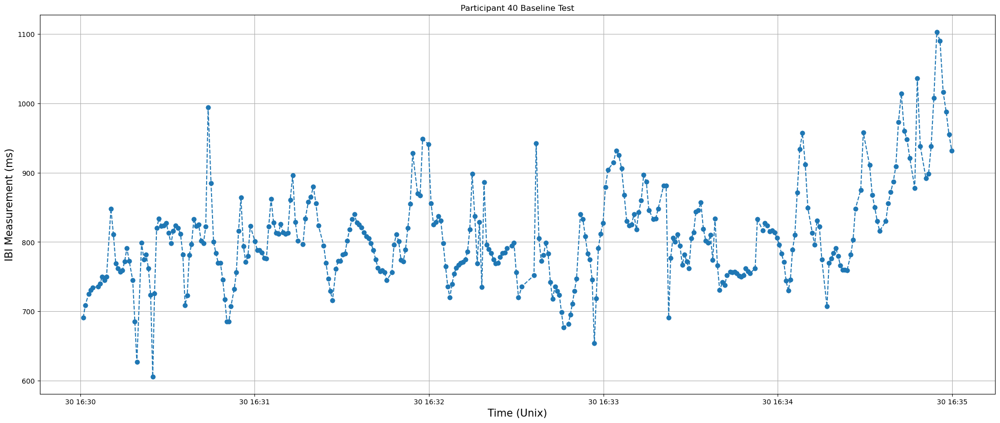

<Figure size 2500x1000 with 0 Axes>

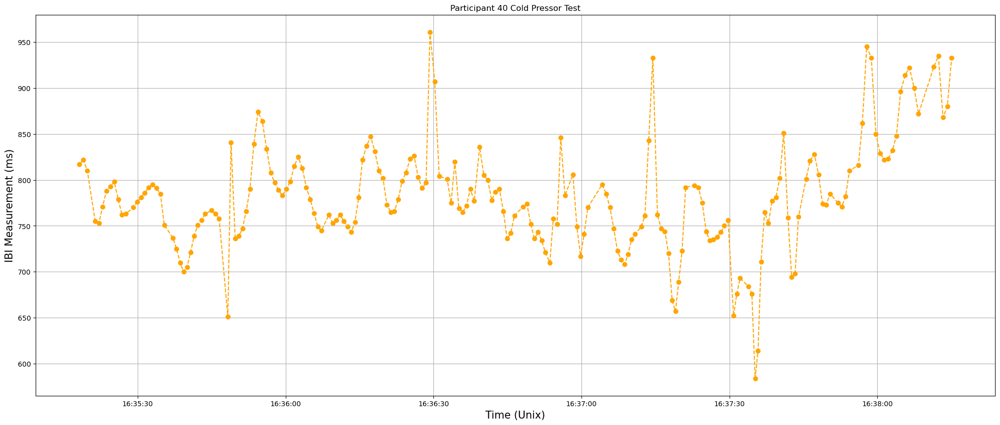

<Figure size 2500x1000 with 0 Axes>

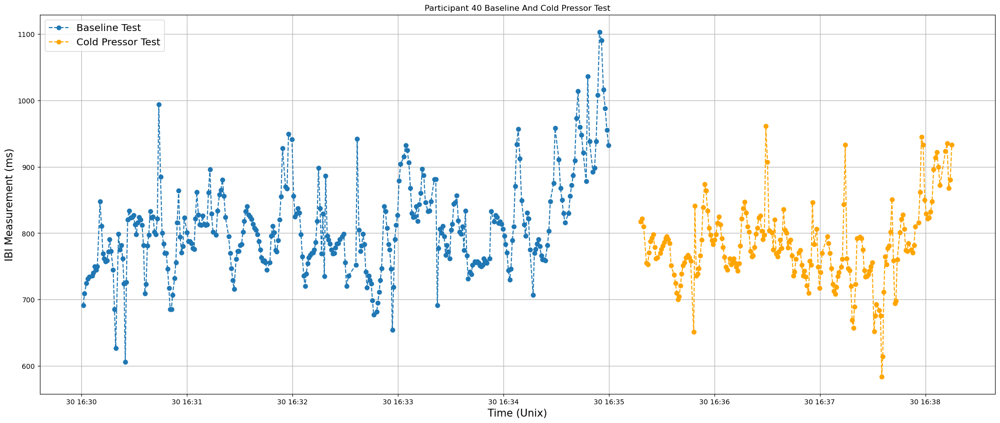

<Figure size 2500x1000 with 0 Axes>

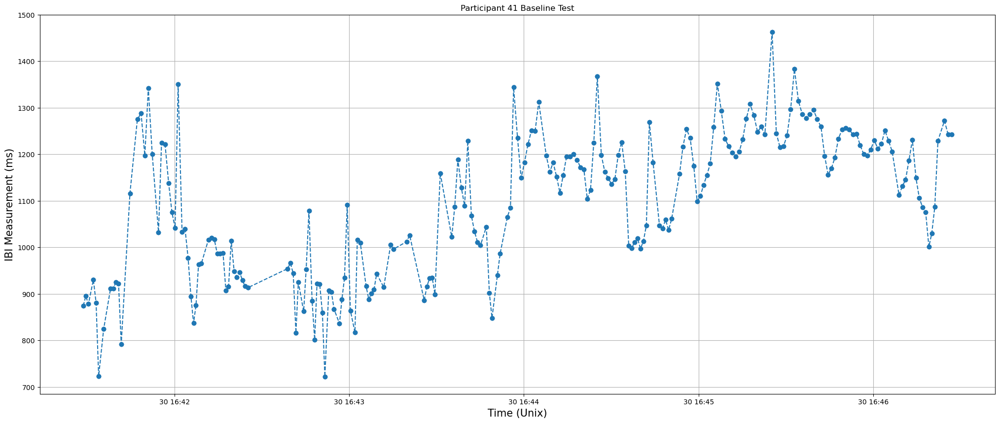

<Figure size 2500x1000 with 0 Axes>

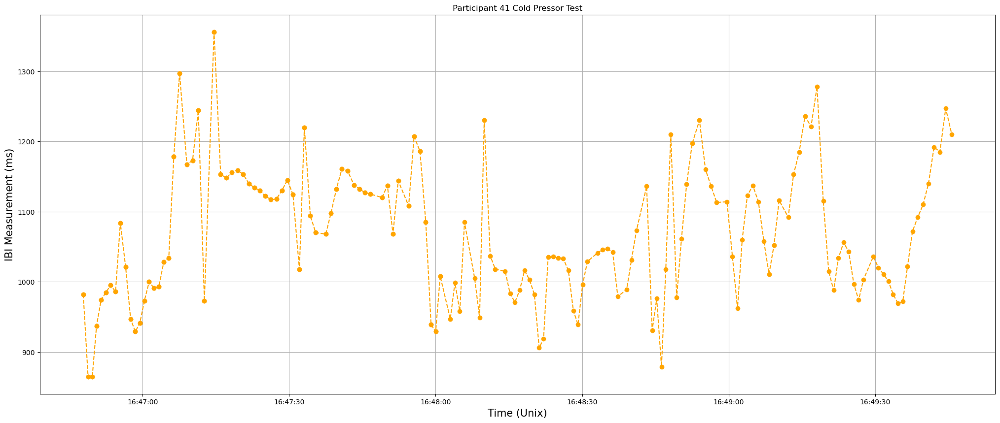

<Figure size 2500x1000 with 0 Axes>

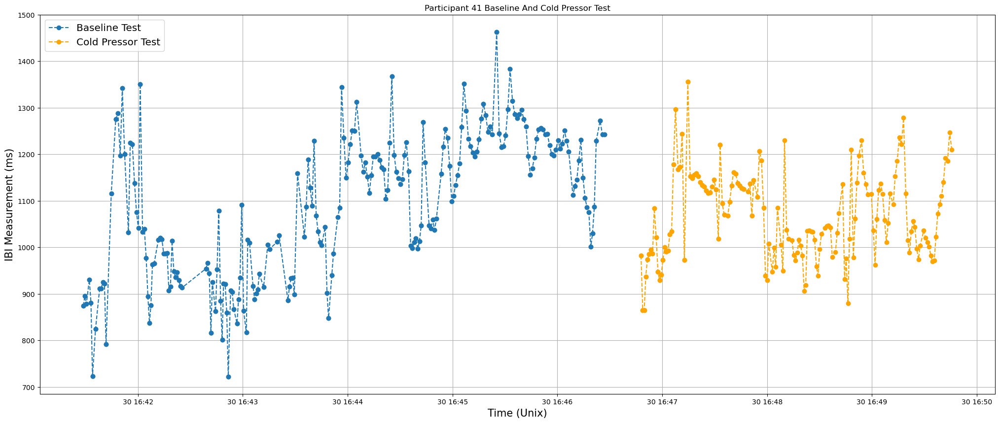

<Figure size 2500x1000 with 0 Axes>

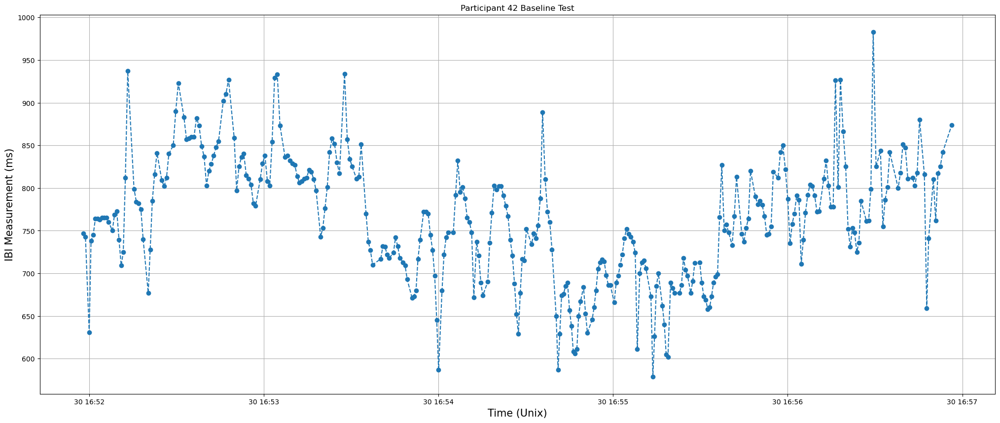

<Figure size 2500x1000 with 0 Axes>

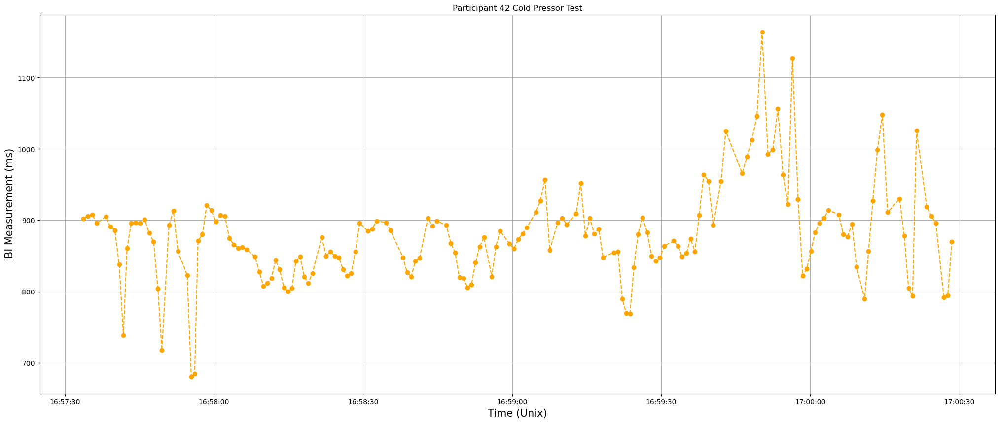

<Figure size 2500x1000 with 0 Axes>

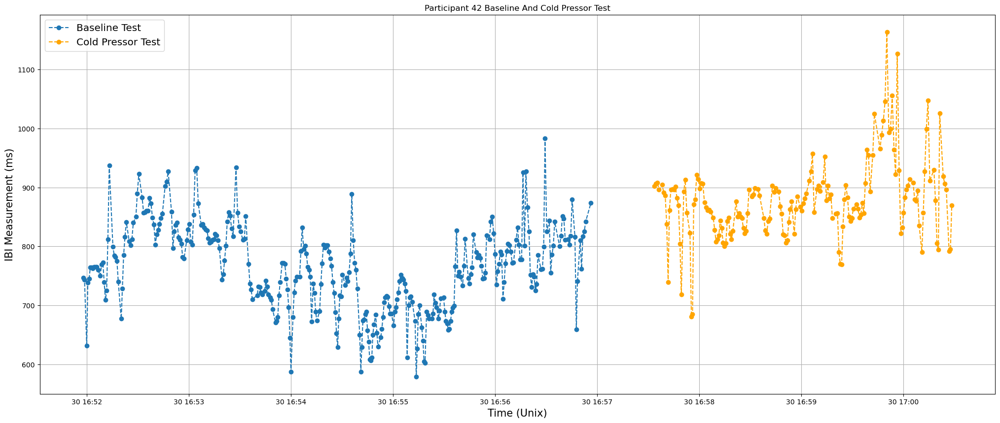

<Figure size 2500x1000 with 0 Axes>

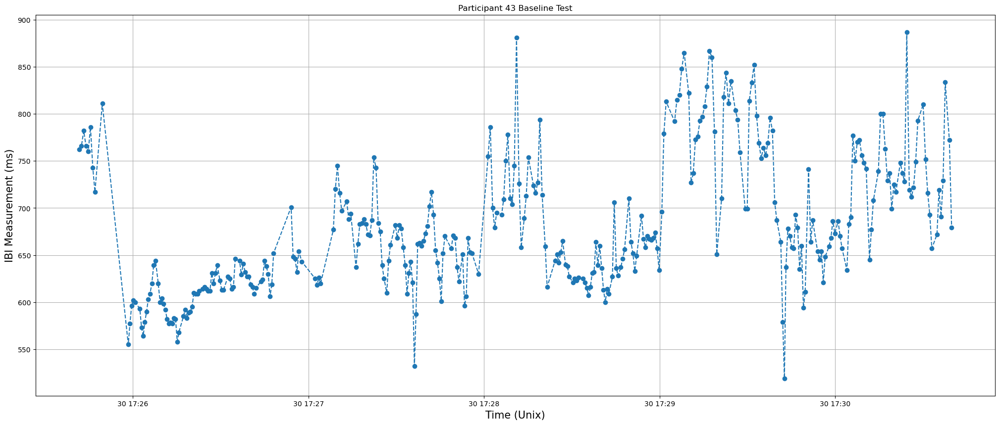

<Figure size 2500x1000 with 0 Axes>

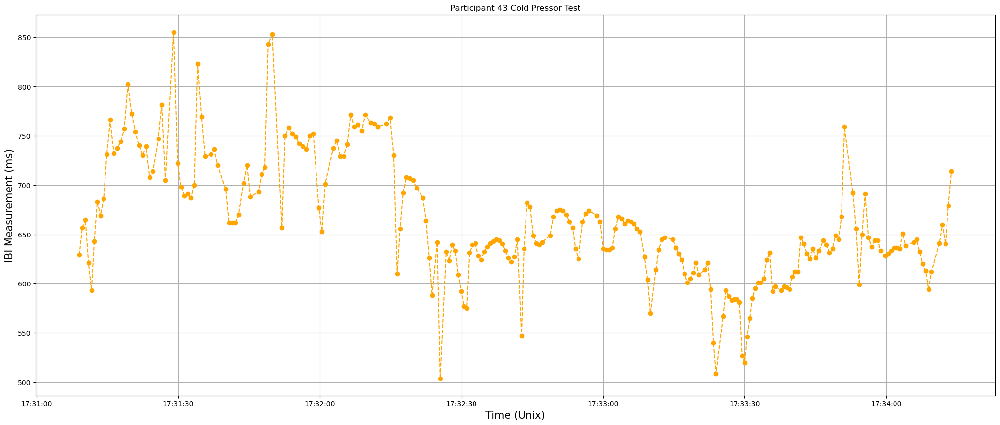

<Figure size 2500x1000 with 0 Axes>

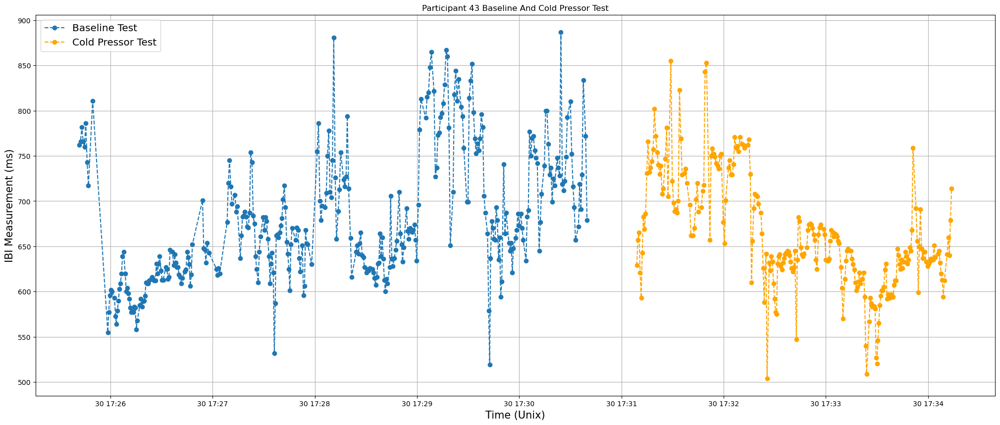

<Figure size 2500x1000 with 0 Axes>

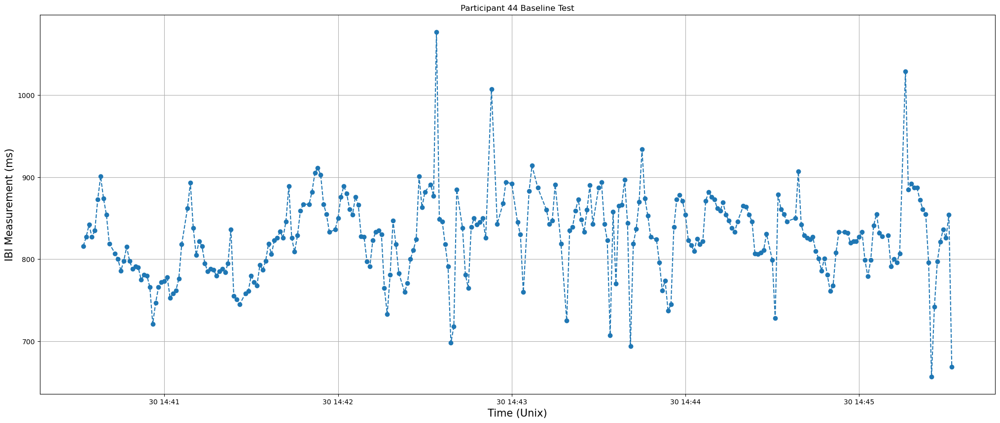

<Figure size 2500x1000 with 0 Axes>

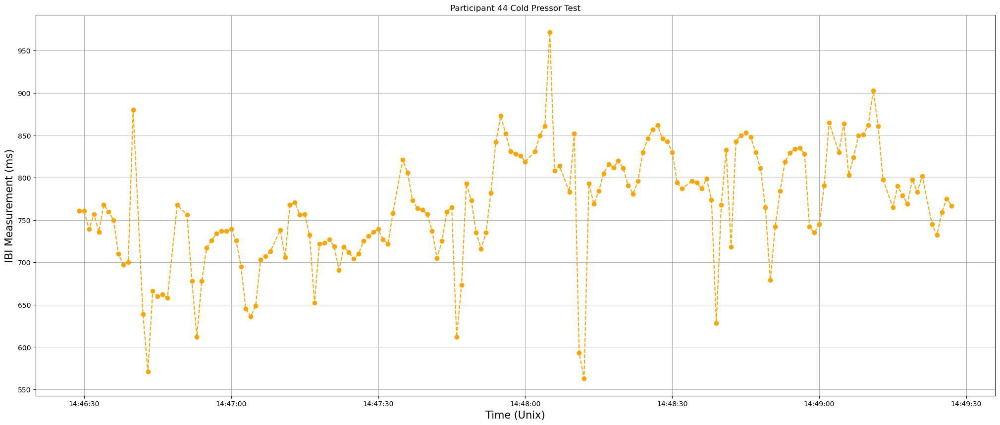

<Figure size 2500x1000 with 0 Axes>

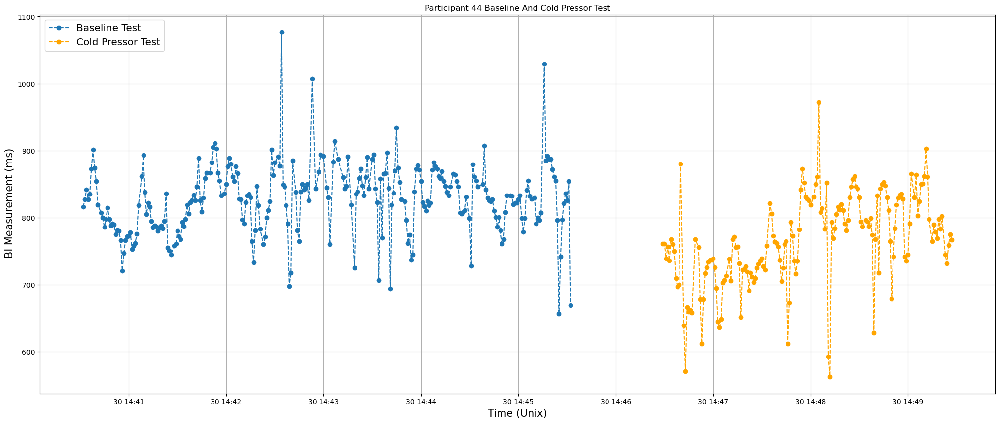

<Figure size 2500x1000 with 0 Axes>

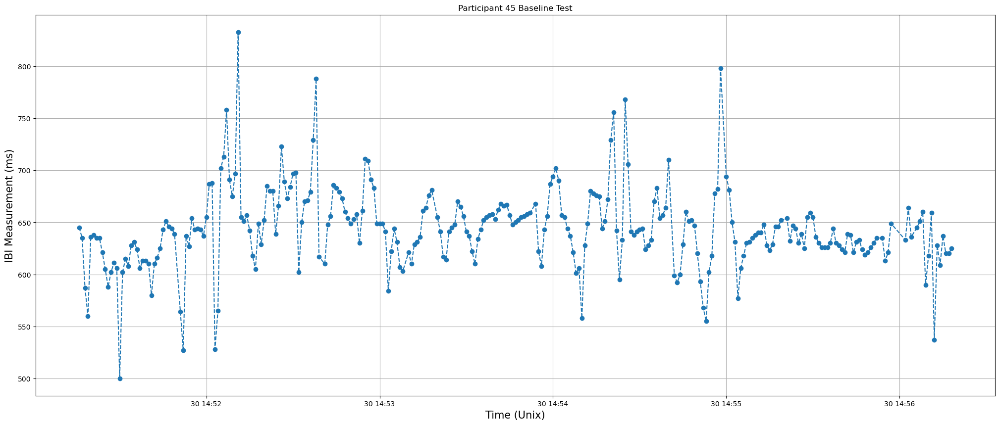

<Figure size 2500x1000 with 0 Axes>

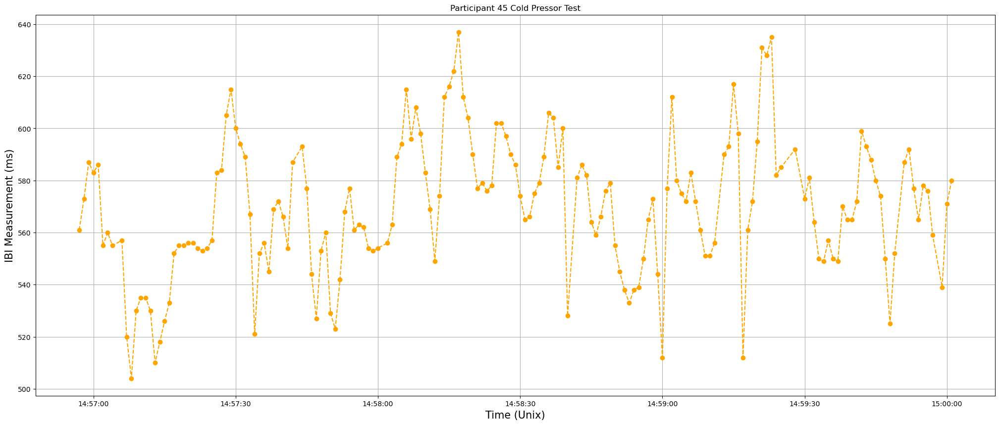

<Figure size 2500x1000 with 0 Axes>

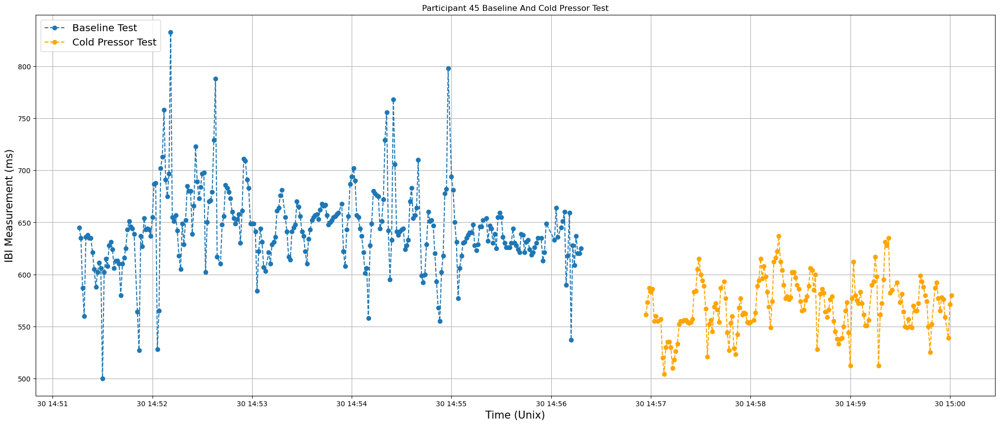

<Figure size 2500x1000 with 0 Axes>

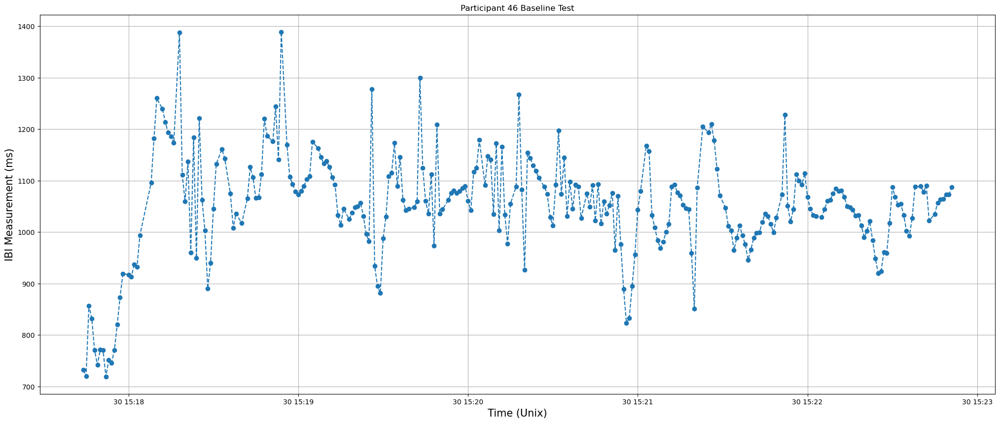

<Figure size 2500x1000 with 0 Axes>

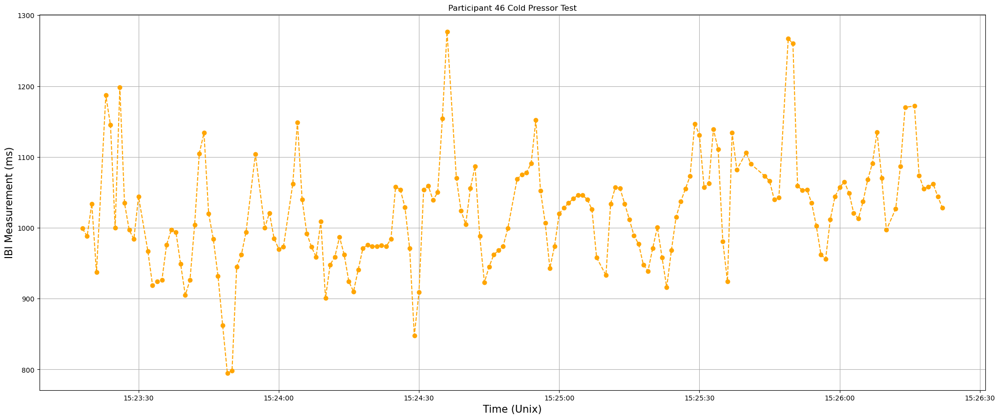

<Figure size 2500x1000 with 0 Axes>

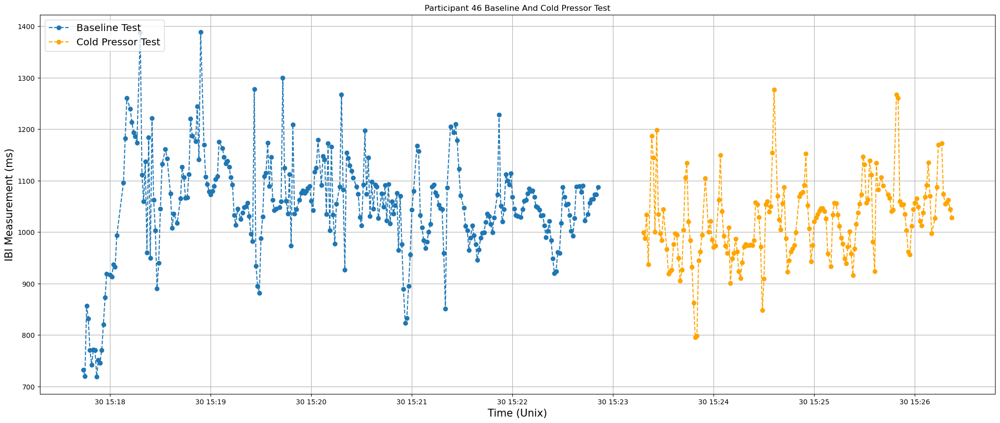

<Figure size 2500x1000 with 0 Axes>

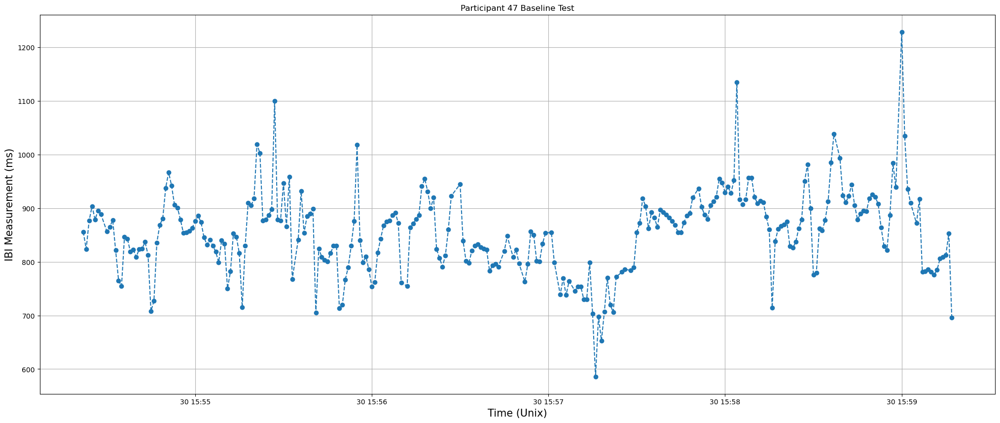

<Figure size 2500x1000 with 0 Axes>

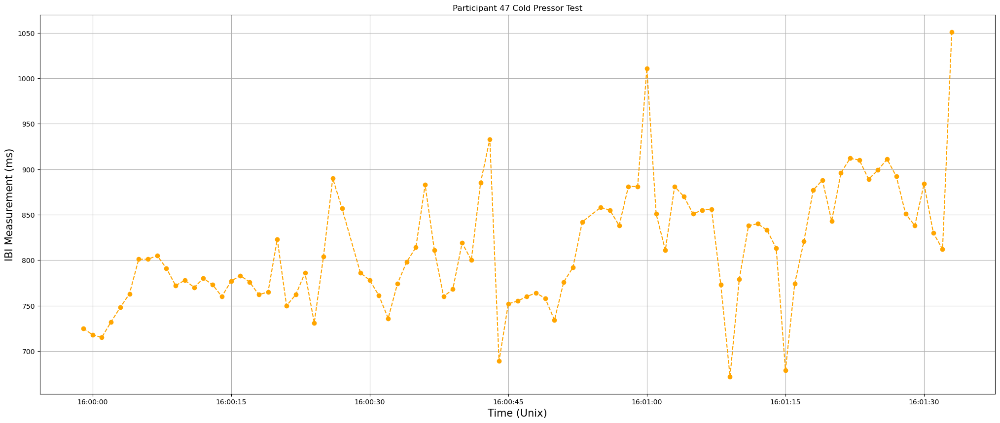

<Figure size 2500x1000 with 0 Axes>

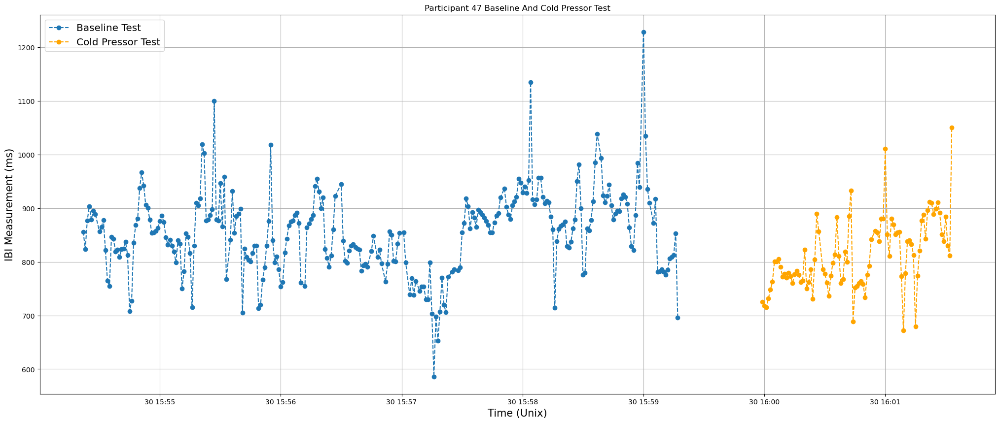

<Figure size 2500x1000 with 0 Axes>

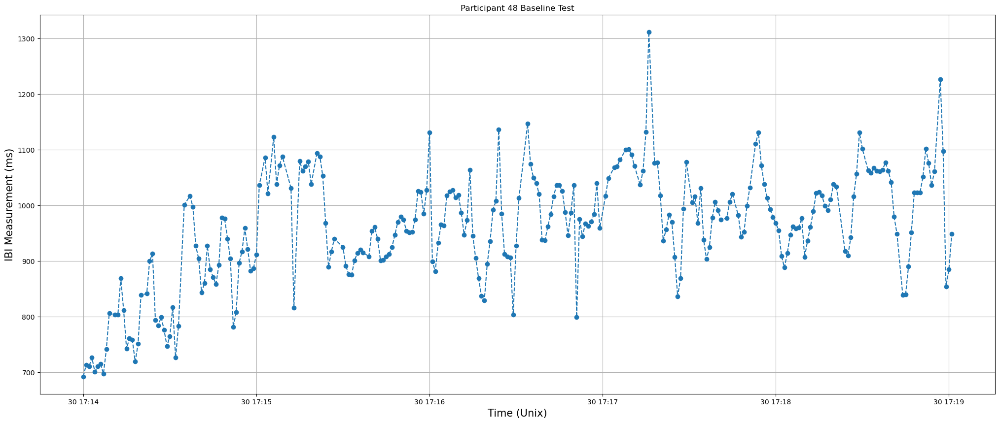

<Figure size 2500x1000 with 0 Axes>

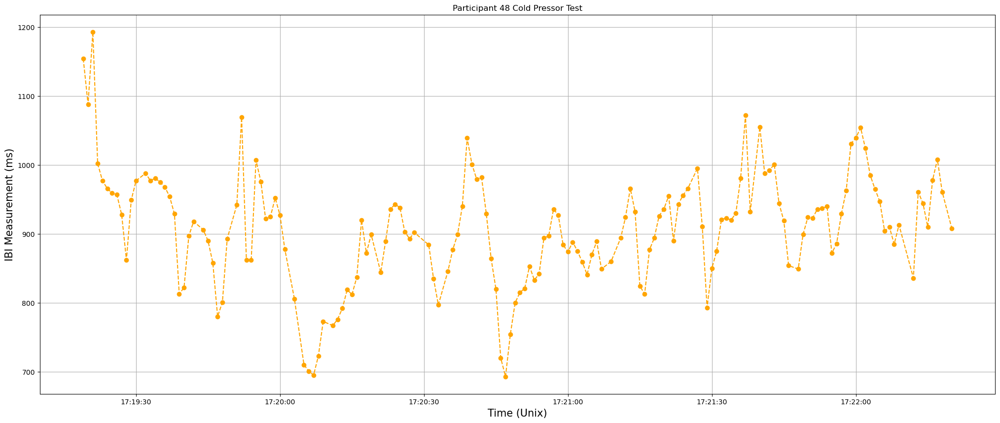

<Figure size 2500x1000 with 0 Axes>

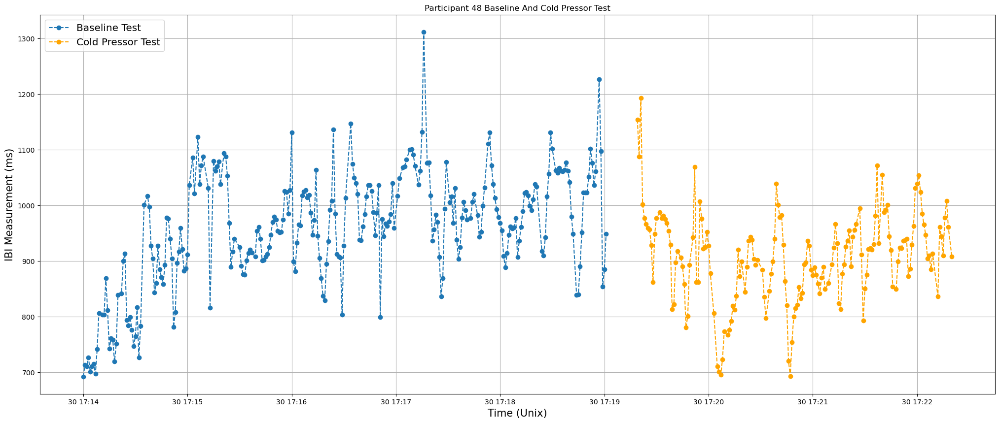

<Figure size 2500x1000 with 0 Axes>

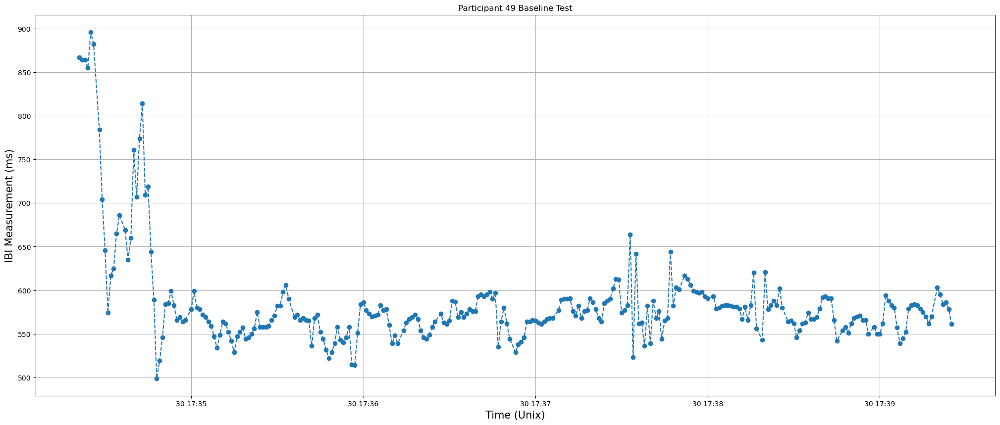

<Figure size 2500x1000 with 0 Axes>

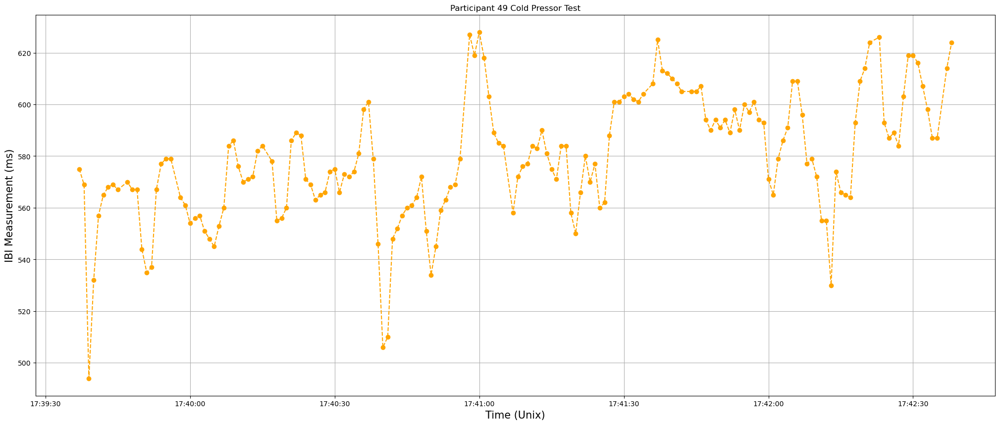

<Figure size 2500x1000 with 0 Axes>

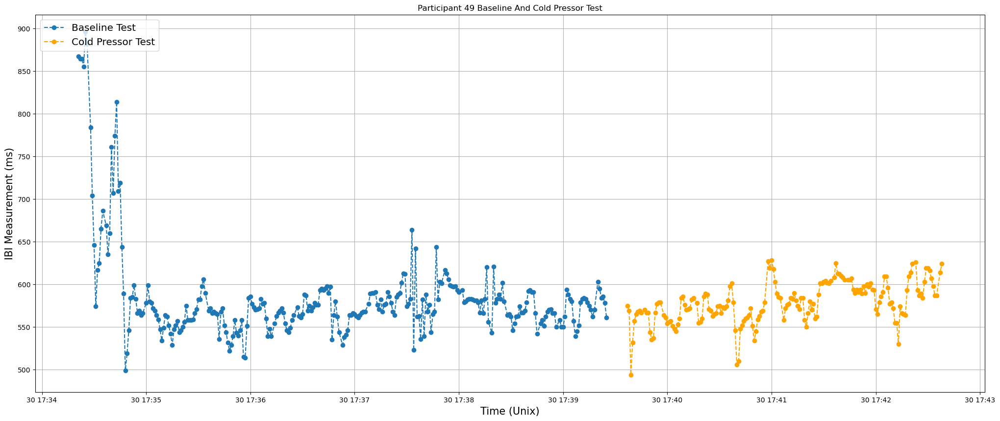

<Figure size 2500x1000 with 0 Axes>

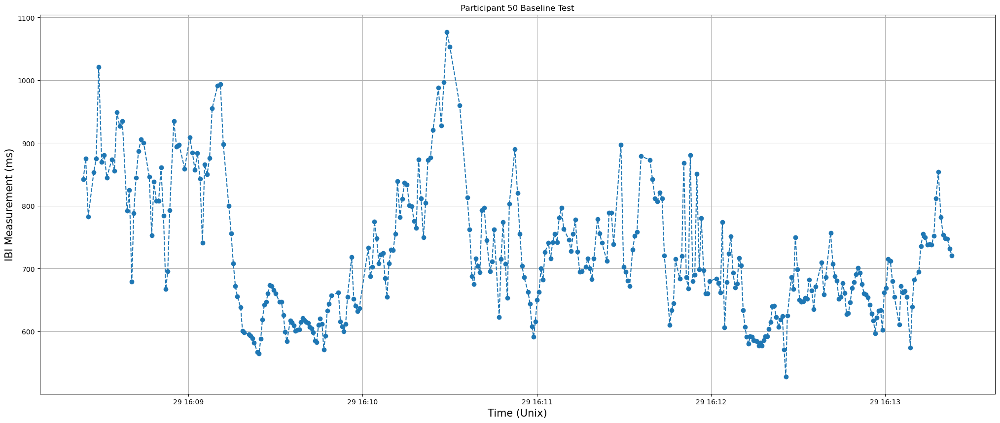

<Figure size 2500x1000 with 0 Axes>

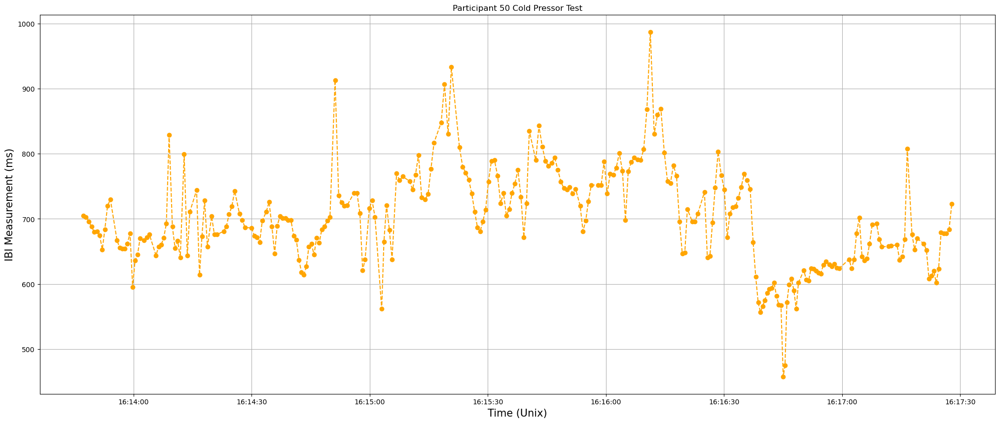

<Figure size 2500x1000 with 0 Axes>

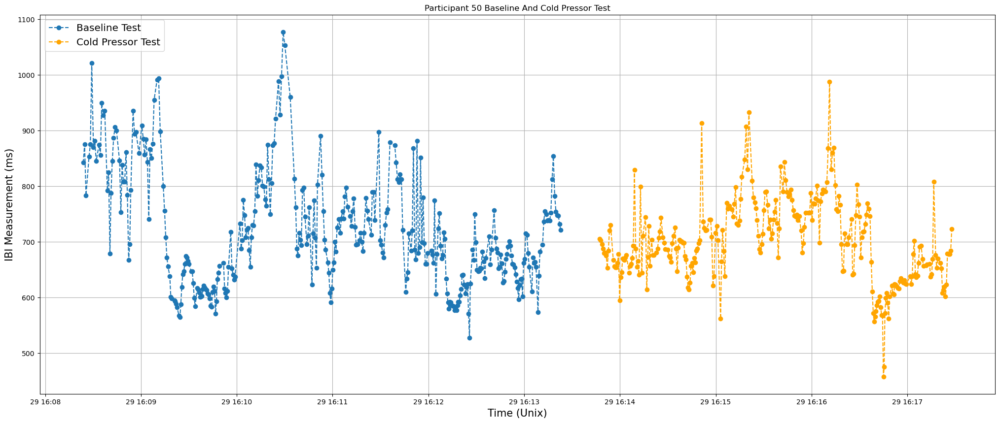

<Figure size 2500x1000 with 0 Axes>

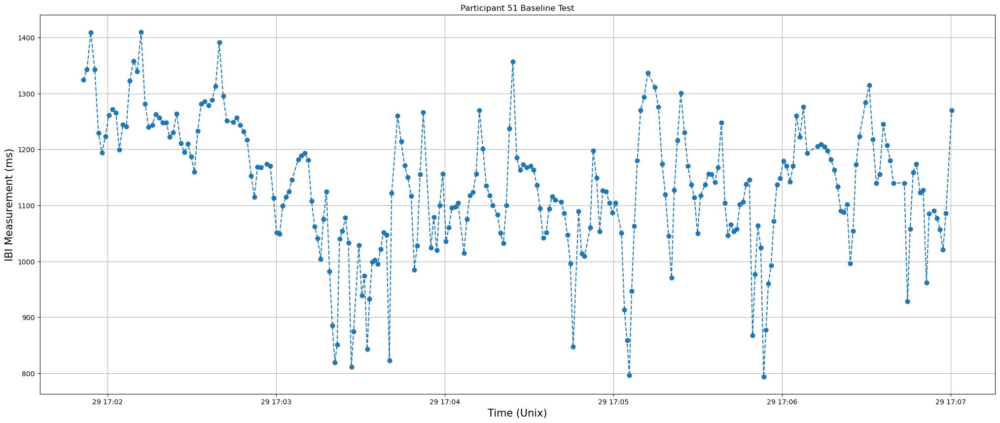

<Figure size 2500x1000 with 0 Axes>

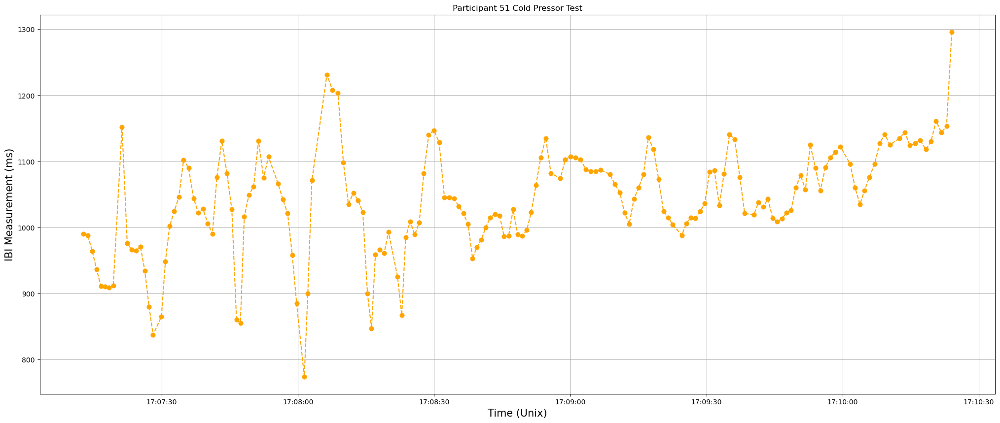

<Figure size 2500x1000 with 0 Axes>

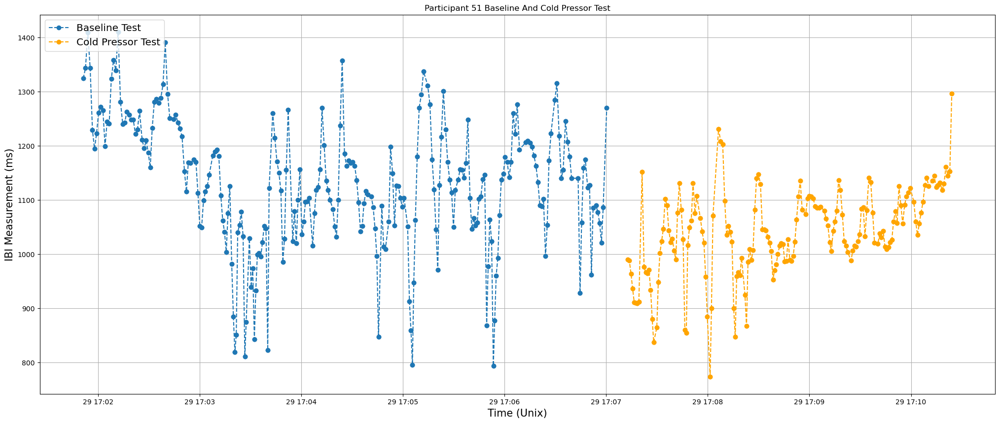

<Figure size 2500x1000 with 0 Axes>

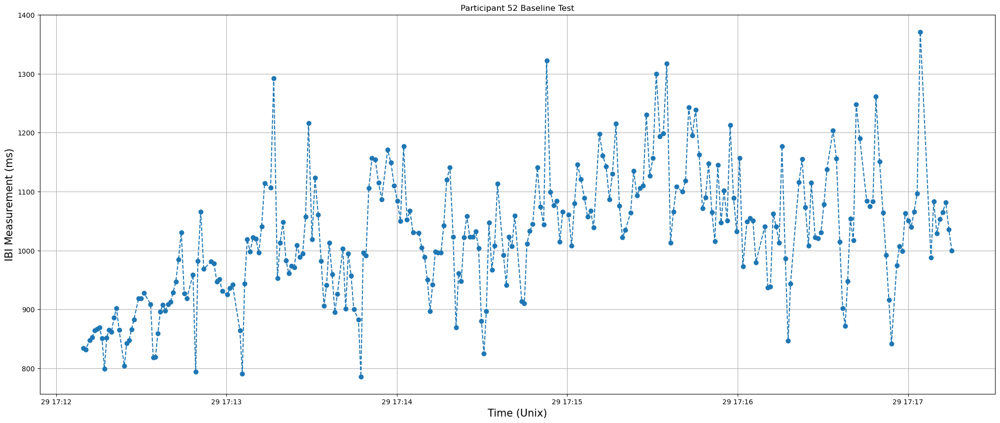

<Figure size 2500x1000 with 0 Axes>

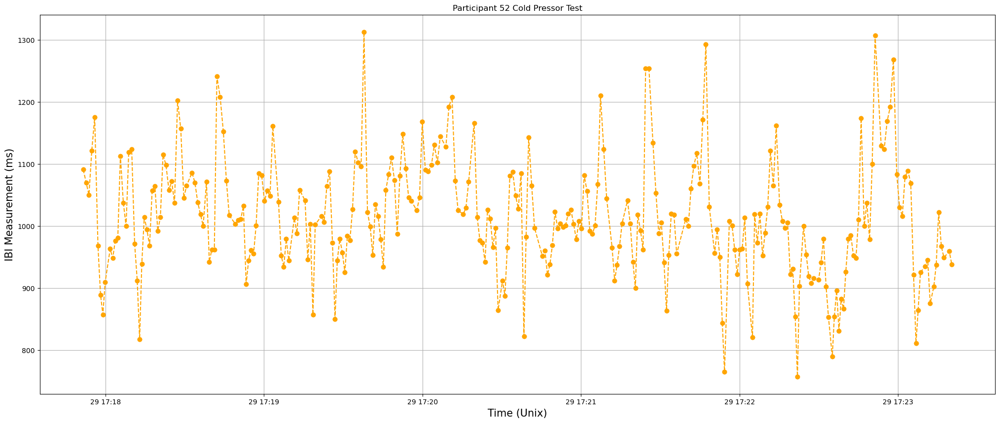

<Figure size 2500x1000 with 0 Axes>

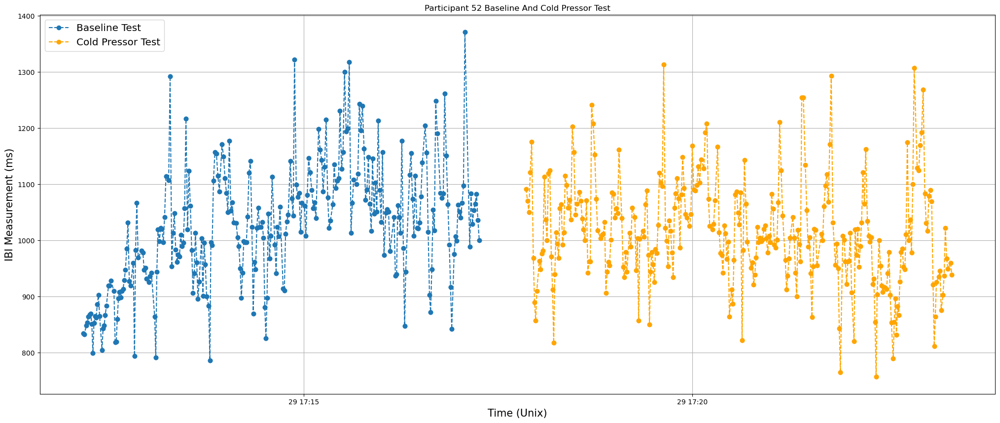

<Figure size 2500x1000 with 0 Axes>

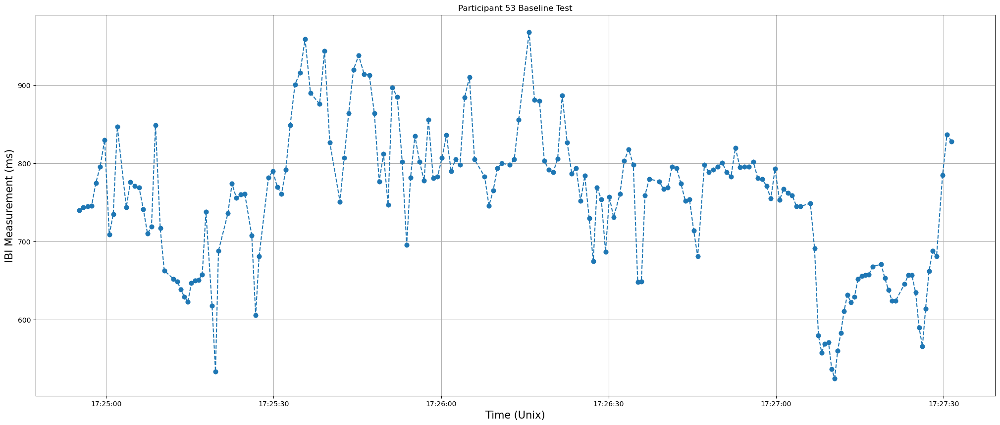

<Figure size 2500x1000 with 0 Axes>

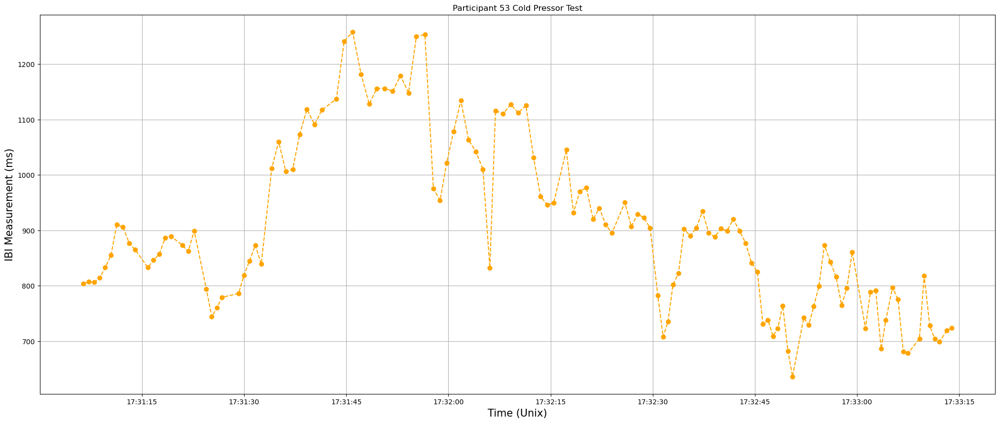

<Figure size 2500x1000 with 0 Axes>

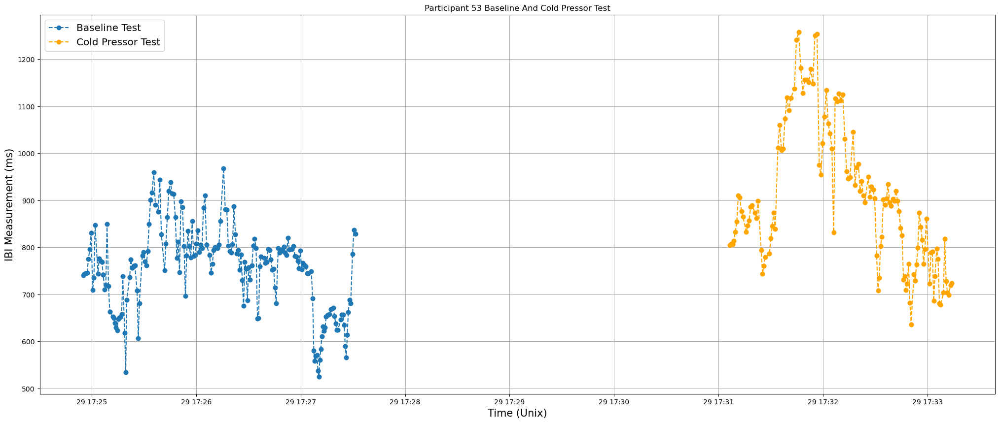

<Figure size 2500x1000 with 0 Axes>

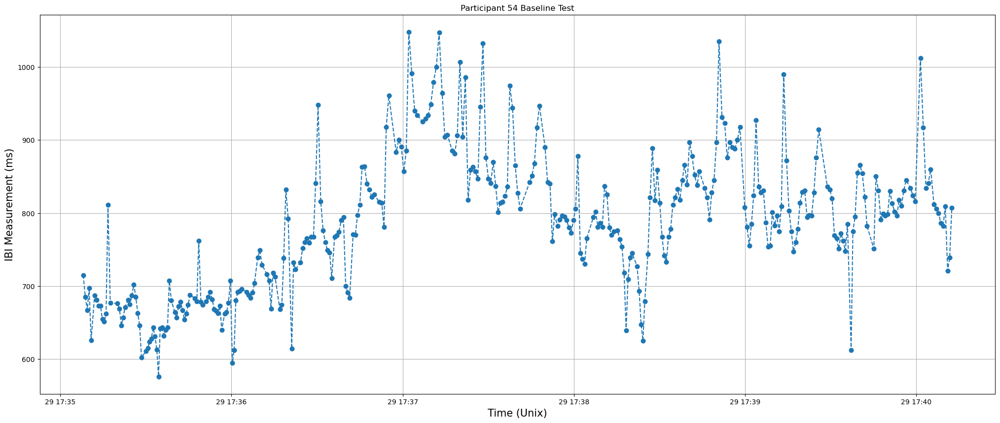

<Figure size 2500x1000 with 0 Axes>

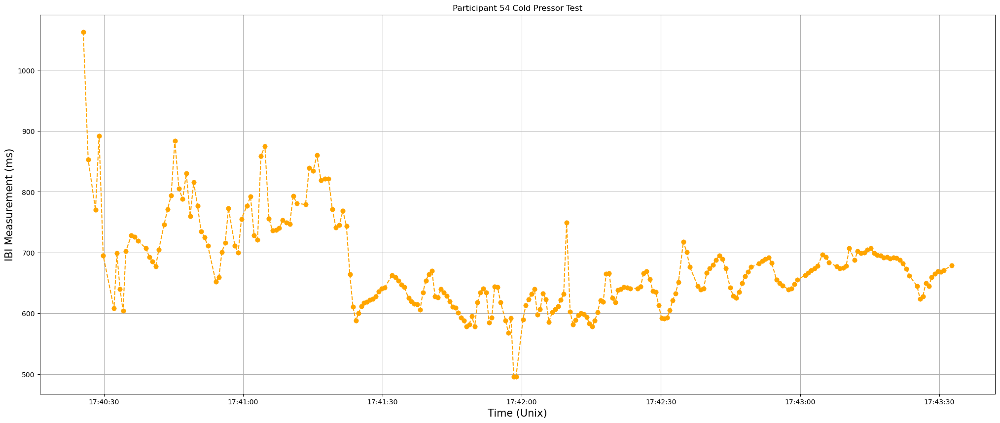

<Figure size 2500x1000 with 0 Axes>

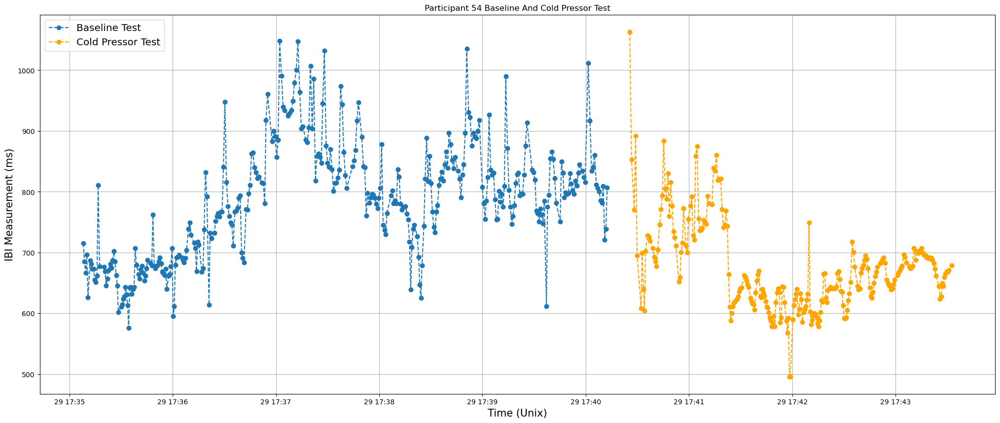

<Figure size 2500x1000 with 0 Axes>

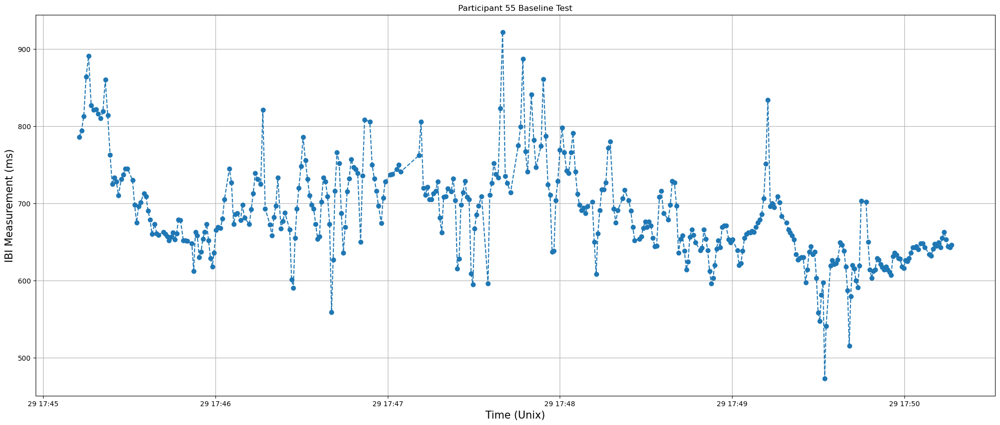

<Figure size 2500x1000 with 0 Axes>

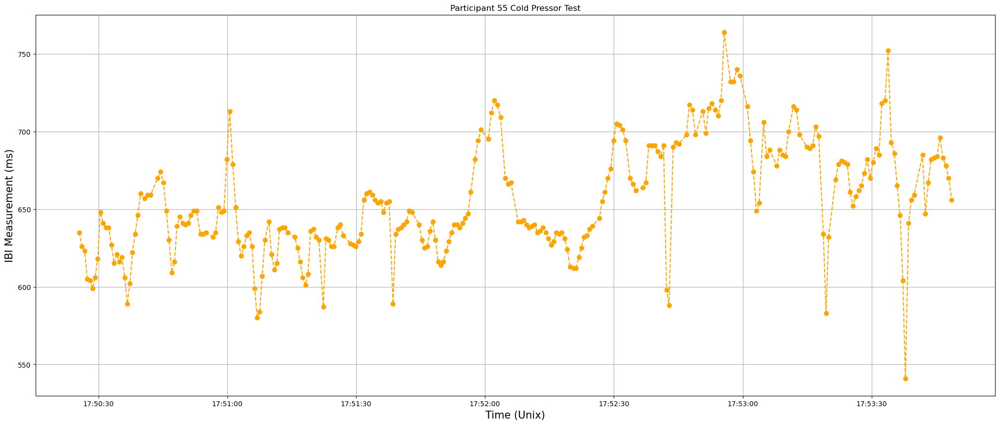

<Figure size 2500x1000 with 0 Axes>

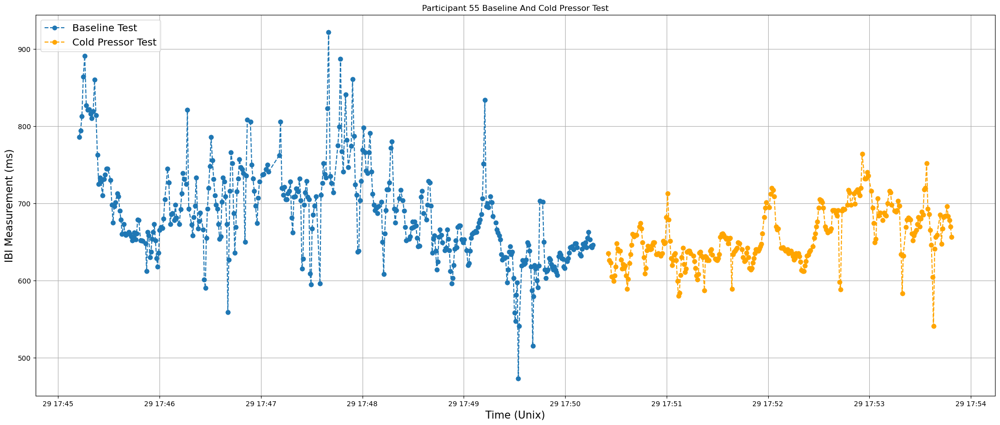

<Figure size 2500x1000 with 0 Axes>

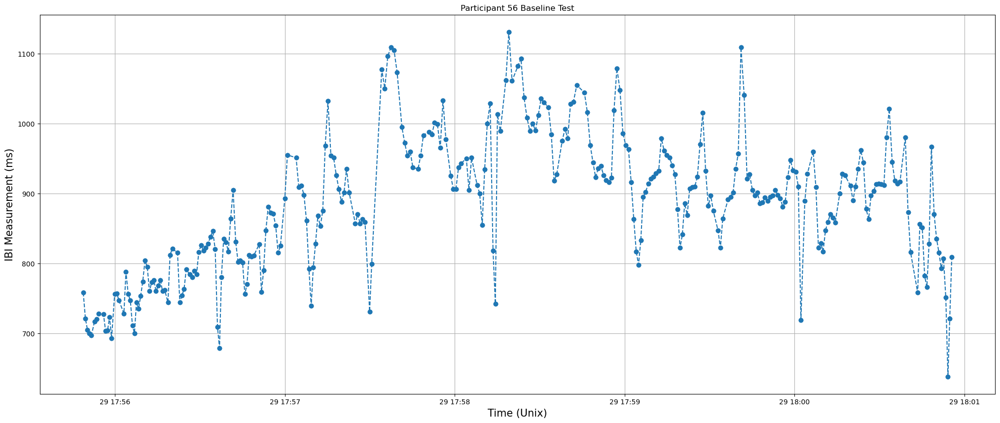

<Figure size 2500x1000 with 0 Axes>

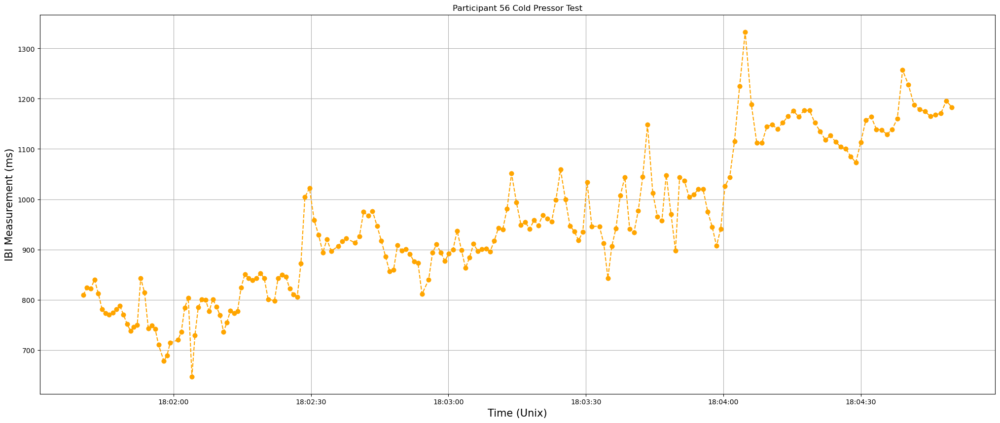

<Figure size 2500x1000 with 0 Axes>

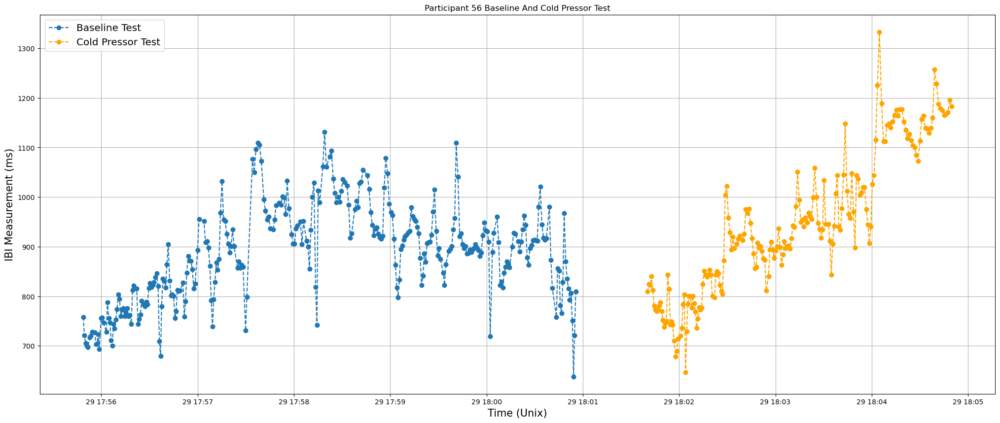

<Figure size 2500x1000 with 0 Axes>

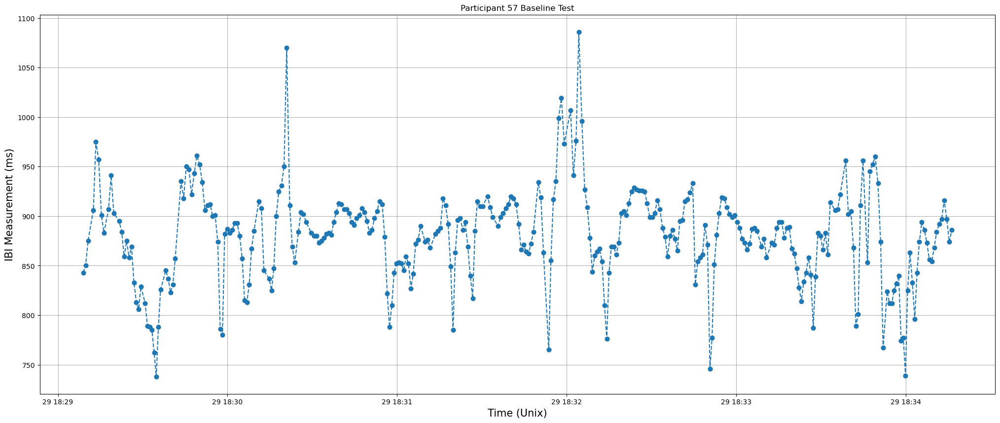

<Figure size 2500x1000 with 0 Axes>

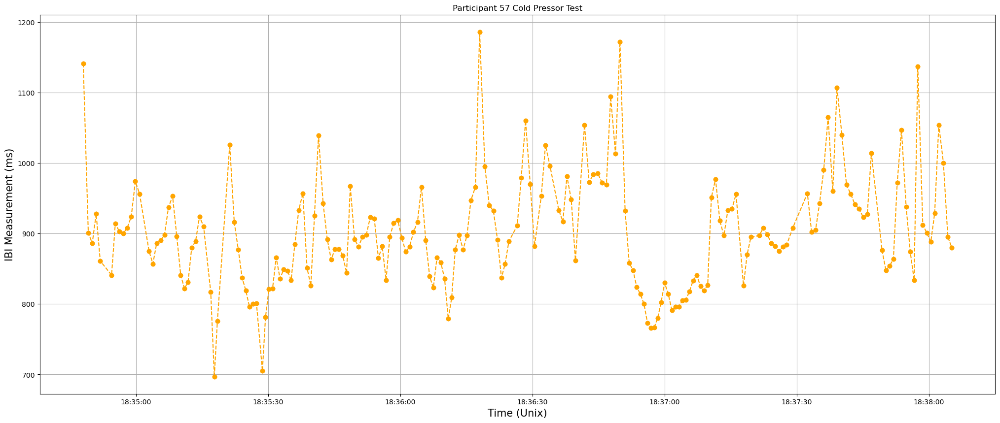

<Figure size 2500x1000 with 0 Axes>

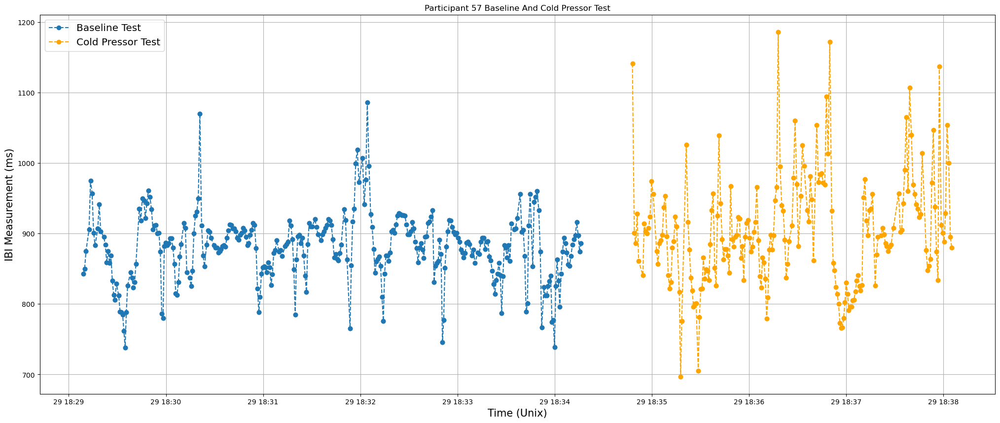

<Figure size 2500x1000 with 0 Axes>

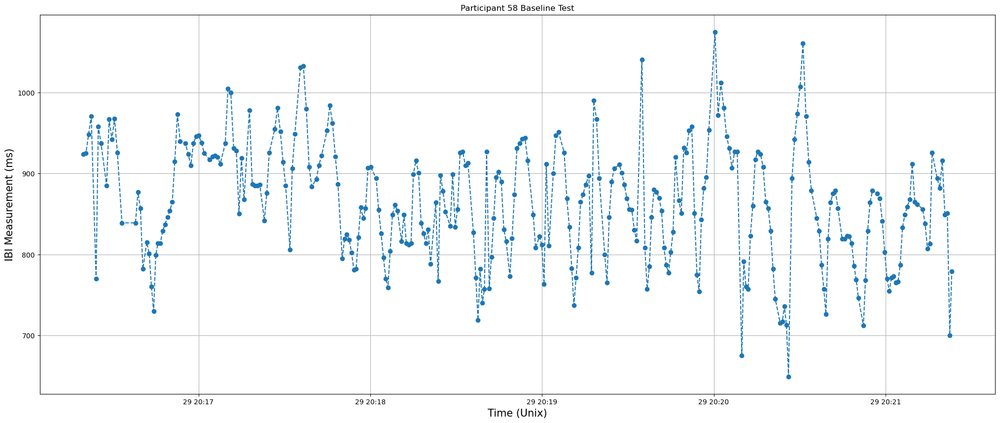

<Figure size 2500x1000 with 0 Axes>

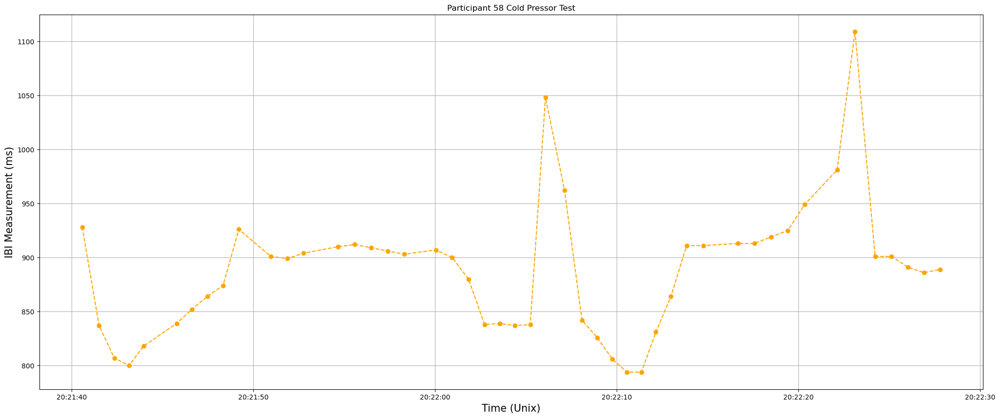

<Figure size 2500x1000 with 0 Axes>

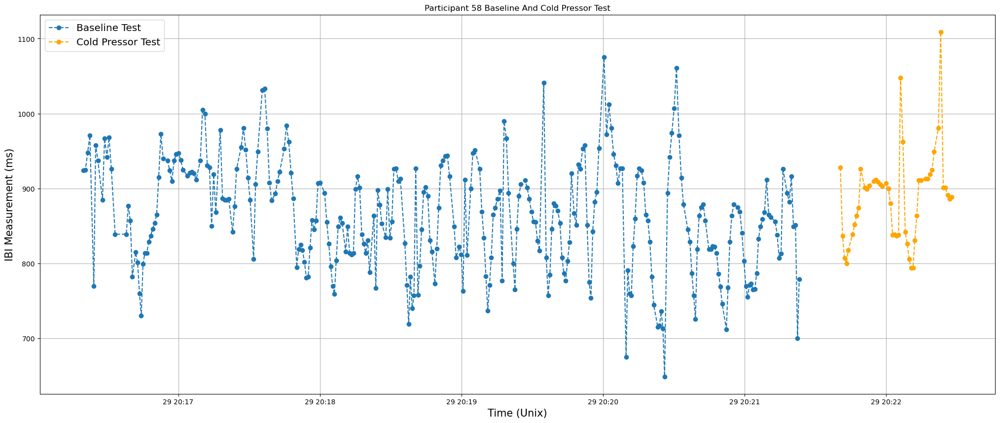

<Figure size 2500x1000 with 0 Axes>

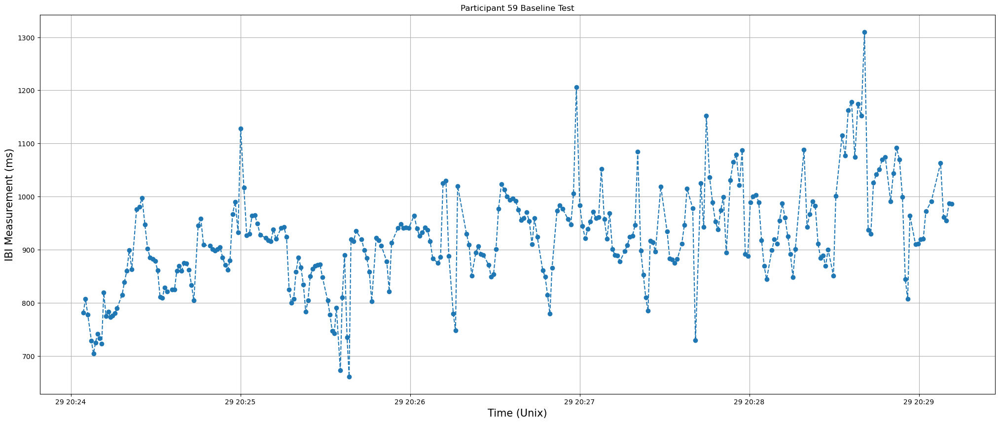

<Figure size 2500x1000 with 0 Axes>

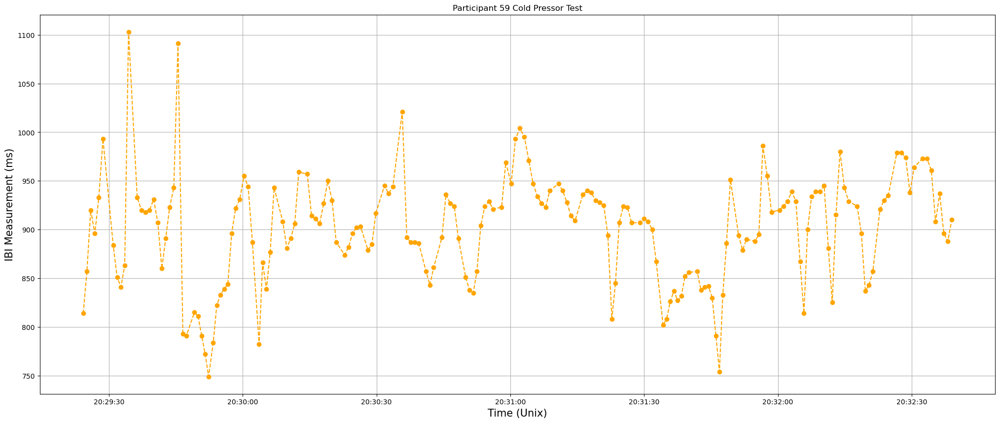

<Figure size 2500x1000 with 0 Axes>

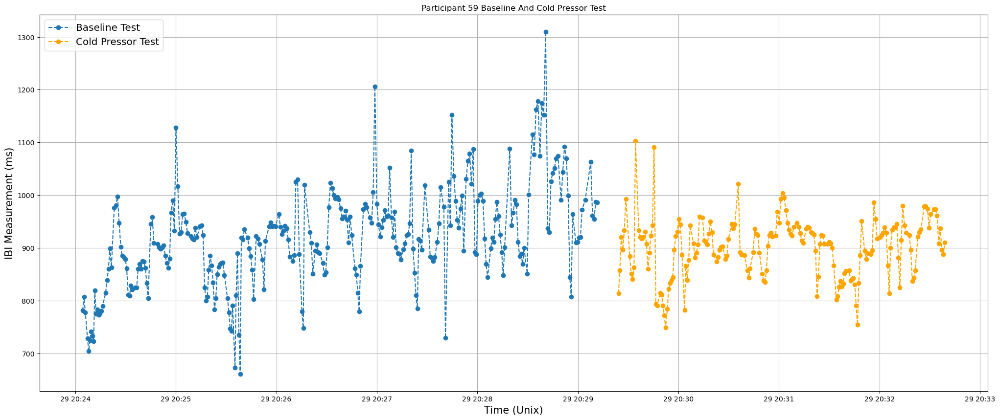

<Figure size 2500x1000 with 0 Axes>

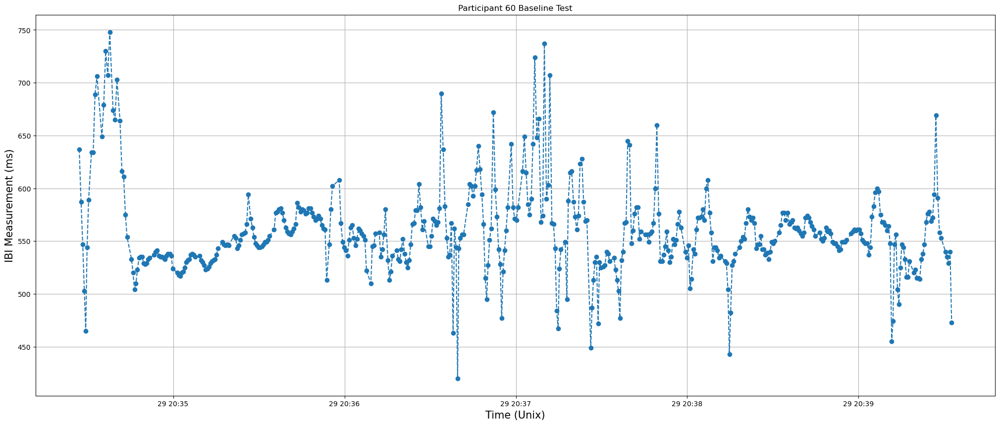

<Figure size 2500x1000 with 0 Axes>

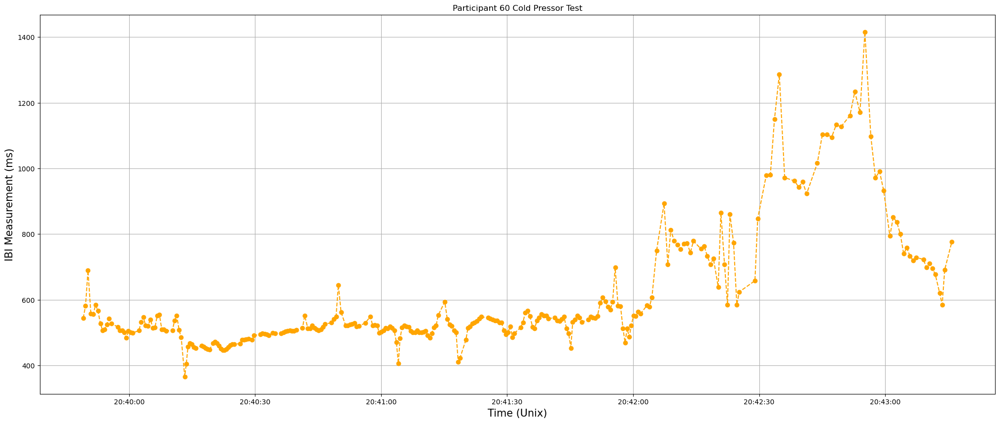

<Figure size 2500x1000 with 0 Axes>

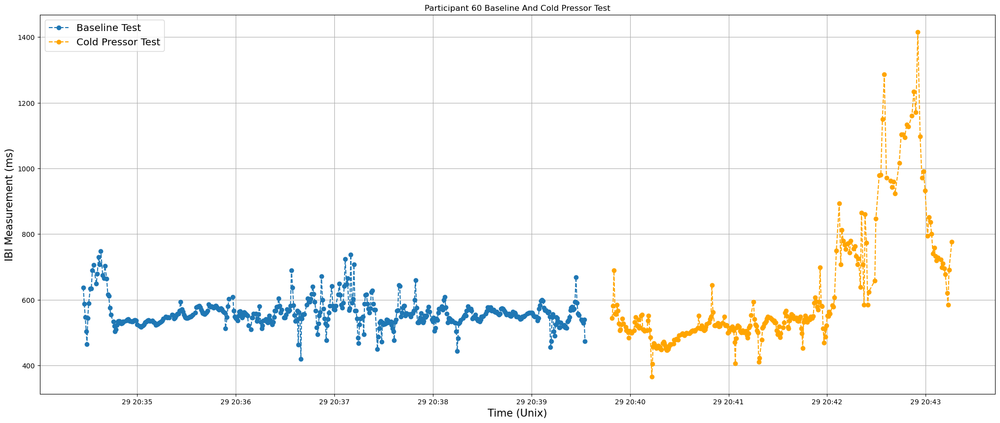

<Figure size 2500x1000 with 0 Axes>

In [72]:
#plot all data for all participants

participants = [Participant for i in range(100)]
# print(participants)

n = 1
while (n<61):
    
    if(n != 2 and (n < 17 or n > 31) and n != 5):  #No participants 2,17-31. Participant 5 has missing values
        participants[n] = Participant("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_BL.csv",
                                      "C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_CPT.csv",n)
        participants[n].plot_baseline()
        plt.clf()
        participants[n].plot_coldpressor()
        plt.clf()
        participants[n].plot_both()
        plt.clf()
        
    n = n + 1

### Old Code (Do not run) 

In [84]:
#main

#init participants
participants = [Participant for i in range(61)]

#store all participant data
n = 1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n] = Participant("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_BL.csv",
                                      "C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_CPT.csv",n)
    n = n + 1
    
# Normalize Data
n = 1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n].normalizeBaselineData()
        participants[n].normalizeColdpressorData()
    n = n + 1

#initiate variables
baselineTotal = 0
coldPressorTotal = 0
numParticipants = 0
smallestBaselineSize = 99999999
smallestColdpressorSize = 99999999
cutoff = 200
numberOfUsableParticipants = 0
    
#get average number of baseline and coldpressor datapoints
n = 1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        baselineTotal = baselineTotal + participants[n].getBaselineSize()
        coldPressorTotal = coldPressorTotal + participants[n].getColdpressorSize()
        numParticipants = numParticipants + 1
        
        smallestBaselineSize = min(smallestBaselineSize, participants[n].baseline_data_length)
        smallestColdpressorSize = min(smallestColdpressorSize, participants[n].coldpressor_data_length)
    n = n + 1

averageNumberOfBaselineDatapoints = round((baselineTotal / numParticipants), 0)
averageNumberOfColdpressorDatapoints = round((coldPressorTotal / numParticipants), 0)

print("Average Number of Baseline datapoints per Sample: " + str(averageNumberOfBaselineDatapoints))
print("Average Number of Coldpressor datapoints per Sample: " + str(averageNumberOfColdpressorDatapoints))
print("Smallest Baseline Sample Size: " + str(smallestBaselineSize))
print("Smallest Coldpressor Sample Size: " + str(smallestColdpressorSize))

# Get all usable participant data that where usable participant's dataset size if greater than the cutoff
usableParticipants = [Participant for i in range(1)]
n = 1
while (n<61 and participants[n] != None):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        if(((participants[n].getBaselineSize() >= cutoff) and (participants[n].getColdpressorSize() >= cutoff)) or (not participants[n])):
            usableParticipants.append(participants[n])
            numberOfUsableParticipants = numberOfUsableParticipants + 1
    n = n + 1

print("Cutoff: " + str(cutoff))
print("Number of Usable Participants: " + str(numberOfUsableParticipants))

#split data into same size
n = 1
while (n<=numberOfUsableParticipants):
    usableParticipants[n].splitDataDatasetLevel(cutoff)
    n = n + 1

# create samples and labels array based on usable participants
samples = [usableParticipants[1].baseline_unix_vs_ibi_for_plotting for i in range(1)]
samples[0] = usableParticipants[1].baseline_unix_vs_ibi_for_plotting[:,1]
labels = [0 for x in range(0, numberOfUsableParticipants)]
ID = []
ID.append(1)
n = 2
while (n<=numberOfUsableParticipants):
    samples.append(usableParticipants[n].baseline_unix_vs_ibi_for_plotting[:,1])
    ID.append(n)
    n = n + 1 
n = 1
while (n<=numberOfUsableParticipants):
    samples.append(usableParticipants[n].coldpressor_unix_vs_ibi_for_plotting[:,1])
    labels.append(1)
    ID.append(n)
    n = n + 1
    
# Saving feature names for later use
feature_names = ["IBI", "Pain"]

# Split data into train/test/validate based on participant number. A participant's baseline and coldpressor data must be
# in the same dataset for k-fold validation

train_samples = []
train_labels = []
test_samples = []
test_labels = []
new_test_samples = []
new_test_labels = []
val_samples = []
val_labels = []
train_IDs = []
test_IDs = []
val_IDs = []

# Split into train and test sets grouping by participant ID
X = samples
y = labels
groups = ID
gss = GroupShuffleSplit(n_splits=2, train_size=.8, random_state=10)
gss.get_n_splits()
i = 1
n = 0
for train_idx, test_idx in gss.split(X, y, groups):
    if (i == 1):
        # print("TRAIN:", train_idx, "\nTEST:", test_idx)
        while (n<(numberOfUsableParticipants*2)):
            if(ID[n] in train_idx):
                train_IDs.append(ID[n])
                train_samples.append(X[n])
                train_labels.append(y[n])
            else:
                test_IDs.append(ID[n])
                test_samples.append(X[n])
                test_labels.append(y[n])
            i = 0
            n = n + 1

# Split test set into test and validation sets based on participant ID
X = test_samples
y = test_labels
groups = test_IDs
count = len(test_IDs)
test_samples = []
test_labels = []
test_IDs = []
gss = GroupShuffleSplit(n_splits=2, train_size=1, random_state=9)
gss.get_n_splits()
i = 1
n = 0
for train_idx, test_idx in gss.split(X, y, groups):
    if (i == 1):
        # print("Test:", train_idx, "\nValidation:", test_idx)
        while (n<count):
            if(groups[n] in train_idx):
                val_IDs.append(ID[n])
                val_samples.append(X[n])
                val_labels.append(y[n])
            else:
                test_IDs.append(ID[n])
                test_samples.append(X[n])
                test_labels.append(y[n])
            i = 0
            n = n + 1
            
# print("Train Labels: ", train_labels)
# print("\nTest Labels: ", test_labels)
# print("\nValidation Labels: ", val_labels)
print("\nTrain IDs: ", train_IDs)
print("\nTest IDs: ", test_IDs)
print("\nValidation IDs: ", val_IDs)
    
# Split into train and test samples
# train_samples, test_samples, train_labels, test_labels = train_test_split(samples, labels, test_size = 0.20, random_state = 42)
# val_samples, test_samples, val_labels, test_labels = train_test_split(test_samples, test_labels, test_size = .5, random_state = 42)

# Print Data
print("\nTotal Number of Samples: " + str(len(samples)))
print("Total Number of Labels: " + str(len(labels)))
print("Number of Train Samples: " + str(len(train_samples)))
print("Number of Train Labels: " + str(len(train_labels)))
print("Number of Test Samples: " + str(len(test_samples)))
print("Number of Test Labels: " + str(len(test_labels)))

# Instantiate model with 1000 decision trees, use classifier for binary classification 
rf = RandomForestClassifier(n_estimators = 1000, random_state = 42)
        
# Train the model on training data
rf.fit(train_samples, train_labels);

# Use the forest's predict method on the test data
predictions = rf.predict(test_samples)

# Print labels and predictions
print("\nTest Labels: " + str(test_labels))
print("Predictions: " + str(predictions))

# Find which values were correctly predicted
correctPredictions =  [0 for x in range(0, len(test_labels))]
n = 0
numCorrect = 0
while (n<len(test_labels)):
    correctPredictions[n] = int (not (test_labels[n] ^ predictions[n]))
    if(correctPredictions[n] == 1):
        numCorrect = numCorrect + 1
    n = n + 1
    
# Print results
print("Correct Predictions: " + str(correctPredictions))
print("Accuracy: " + str( round( ((numCorrect/len(test_labels)) * 100), 2)) + "%")

# Practice with Keras Model
# Activation and Loss Function
model = Sequential()
model.add(Dense(cutoff, input_shape=(cutoff,), activation='relu'))
# model.add(Dense(16, activation='relu'))
# model.add(Dense(8, activation='relu'))
# model.add(Dense(4, activation='relu'))
# model.add(Dense(6, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['acc'])
model.summary()

# put data in correct format for model.fit and model.evaluate functions
train_samples=np.asarray(train_samples).astype(int)
train_labels=np.asarray(train_labels).astype(int)
test_samples=np.asarray(test_samples).astype(int)
test_labels=np.asarray(test_labels).astype(int)
val_samples=np.asarray(val_samples).astype(int)
val_labels=np.asarray(val_labels).astype(int)

# fit the keras model on the dataset
history = model.fit(train_samples, train_labels, validation_data=(val_samples, val_labels), epochs=40, batch_size=8, verbose=1)

# kfold = StratifiedKFold(n_splits=10, shuffle=True)

# Print accuracy of the model, anything greater than 50% would be great
_, accuracy = model.evaluate(test_samples, test_labels)
print('Accuracy: %.2f' % (accuracy*100))

Average Number of Baseline datapoints per Sample: 6670.0
Average Number of Coldpressor datapoints per Sample: 4316.0
Smallest Baseline Sample Size: 274
Smallest Coldpressor Sample Size: 49
Cutoff: 200
Number of Usable Participants: 28

Train IDs:  [1, 3, 4, 6, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 1, 3, 4, 6, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28]

Test IDs:  [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

Validation IDs:  []

Total Number of Samples: 56
Total Number of Labels: 56
Number of Train Samples: 44
Number of Train Labels: 44
Number of Test Samples: 12
Number of Test Labels: 12

Test Labels: [0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1]
Predictions: [0 1 0 0 0 1 1 1 1 1 1 1]
Correct Predictions: [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Accuracy: 83.33%
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_18 (Dense)            (N